# Plots generation

Generate plots from the output of process_results.ipynb notebook.

In [2]:
#root = "/work/Master_Project/Snakemake"
import sys
sys.path.append("../workflow")
sys.path.append("../workflow/scripts")
sys.path.append("../results_analysis/")
#sys.path.append("/work/Master_Project/Snakemake") 
#sys.path.append("/work/Master_Project/Snakemake/benchmark_analysis")
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.ticker as ticker
import scanpy as sc
from matplotlib.ticker import MaxNLocator
import yaml
from parse_config import *
from  matplotlib.ticker import FuncFormatter
import scanpy as sc
from matplotlib.gridspec import GridSpec
import matplotlib.pyplot as plt
import seaborn as sns
import math
from collections import defaultdict
plt.rcParams['text.usetex'] = False


configfile = "../config.yaml"

with open(configfile, "r") as f:
    config = yaml.safe_load(f)  # Load YAML config into a dictionary

cfg = PrepConfig(config)  # Now use PrepConfig


In [3]:
sns.set_theme(rc={'figure.figsize':(10.7,6.27)})
sns.set_context("paper", font_scale=1.9)

In [4]:
def match_rows_fast(df1_row, df2, columns_to_match):
    conditions = [
        df2[col].values == (str(df1_row[col]) if df2[col].dtype == 'object' else df1_row[col])
        for col in columns_to_match
    ]
    mask = np.logical_and.reduce(conditions)
    return df2[mask]

Load two dataframes - dataframe with all of the results and dataframe with the best identified combinations

In [ ]:
all_results = pd.read_pickle("..results_analysis/paper_reproduce/benchmark_paper_all_results.pkl")

In [ ]:
best_comb = pd.read_pickle("..results_analysis/paper_reproduce/best_combinations_PCA_score.pkl")

Some extra processing needed for plotting

In [8]:
best_comb['Standard'] = best_comb['Dataset'].apply(lambda x: cfg.get_from_dataset(x, 'standard'))

In [9]:
best_comb['PCA_score'] = pd.to_numeric(best_comb['PCA_score'])
best_comb['NMI'] = pd.to_numeric(best_comb['NMI'])
best_comb['ARI'] = pd.to_numeric(best_comb['ARI'])
best_comb['PSI'] = pd.to_numeric(best_comb['PSI'])
best_comb['Resolution'] = pd.to_numeric(best_comb['Resolution'])
best_comb["K_Neighbors"] = pd.to_numeric(best_comb["K_Neighbors"])

In [10]:
all_results['PCA_score'] = pd.to_numeric(all_results['PCA_score'])
all_results['NMI'] = pd.to_numeric(all_results['NMI'])
all_results['ARI'] = pd.to_numeric(all_results['ARI'])
all_results['PSI'] = pd.to_numeric(all_results['PSI'])
all_results['Resolution'] = pd.to_numeric(all_results['Resolution'])
all_results["K_Neighbors"] = pd.to_numeric(all_results["K_Neighbors"])

In [11]:
best_comb['Similarity_Measure'] = best_comb['Similarity_Measure'].str.capitalize()
all_results['Similarity_Measure'] = all_results['Similarity_Measure'].str.capitalize()
all_results['Graph_type'] = all_results['Graph_type'].str.capitalize()
best_comb['Graph_type'] = best_comb['Graph_type'].str.capitalize()
all_results['Clustering_algorithm'] = all_results['Clustering_algorithm'].str.capitalize()
best_comb['Clustering_algorithm'] = best_comb['Clustering_algorithm'].str.capitalize()

Change measures names for plots

In [12]:
all_results.replace("Correlation", "Pearson", inplace=True)
best_comb.replace("Correlation", "Pearson", inplace=True)

all_results.replace("Braycurtis", "Bray-Curtis", inplace=True)
best_comb.replace("Braycurtis", "Bray-Curtis", inplace=True)

all_results.replace("Phs", "Phi", inplace=True)
best_comb.replace("Phs", "Phi", inplace=True)
best_comb.replace("Phs/rho", "Phi/Rho", inplace=True)

Specify two extra version of best combination dataframe - expanded, which expands rows that have two values of the same hyper-parameters and shrinked which chooses first option when there are two available in a row

In [13]:
best_comb_expanded = best_comb.assign(
    Similarity_Measure=best_comb['Similarity_Measure'].str.split('/')
).explode('Similarity_Measure')

#best_comb_expanded.replace("Phs", "Phi", inplace=True)
#best_comb_expanded.replace("rho", "Rho", inplace=True)
#best_comb_expanded.replace("pearson", "Pearson", inplace=True)


In [14]:
best_comb_shrink = best_comb_expanded.groupby(['Dataset', 'Clustering_algorithm']).first().reset_index()

## Identify the most common hyper-parameter values among best combinations for 22 datasets

Some hyperparameter combinations can yield exactly the same results. In the Jung dataset, for example, the phs and rho similarity measures produced identical performance. Because of this, we include both similarity measures in the best hyperparameter combination for this dataset.

In this count plot, we count every occurrence, even if they had the same performance within a dataset. As a result, the total frequency of similarity measures may be higher than the total number of datasets. However, this effect is only seen for one dataset in this analysis.

### For all best combinations

#### Similarity Measure


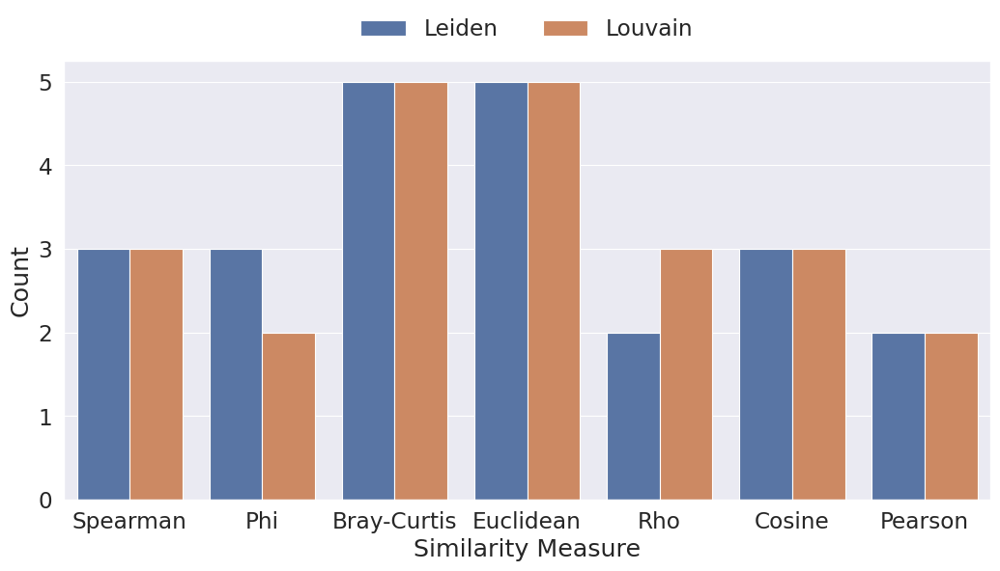

In [20]:
plot = sns.countplot(best_comb_expanded, x='Similarity_Measure',hue='Clustering_algorithm',legend='full')
#sns.move_legend(plot,title='', loc='center right')  # remove the title


sns.move_legend(
    plot, "lower center",
    bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False,
)
plt.xlabel("Similarity Measure")
plt.ylabel("Count")
plt.tight_layout()
#plt.legend(title='Clustering algorithm')

filename = f"/work/Master_Project/Notebooks/plots_paper/similarity_measure.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
plt.show()




#### Quality Function


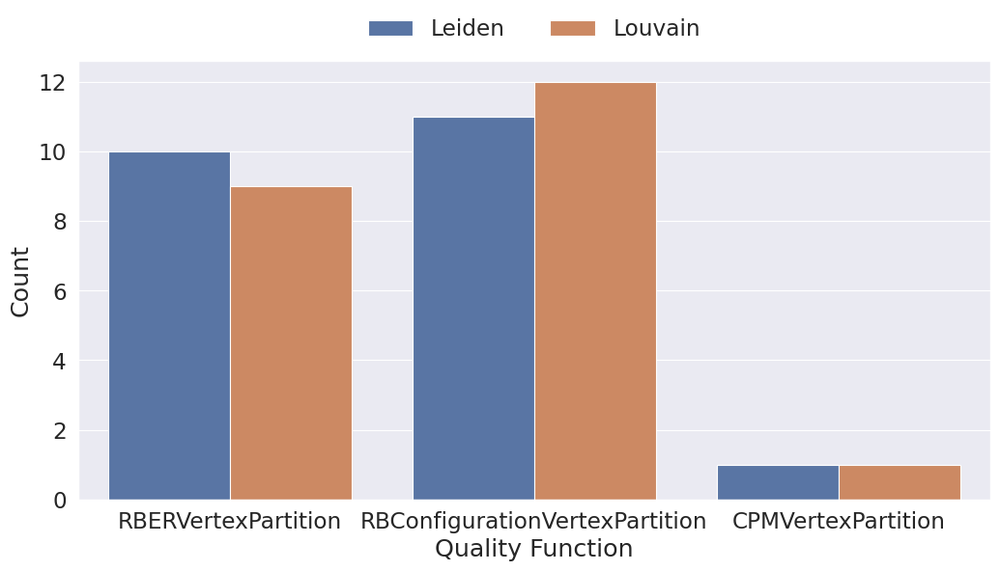

In [21]:
plot = sns.countplot(best_comb, x='Quality_Function',hue='Clustering_algorithm',legend='full')

sns.move_legend(
    plot, "lower center",
    bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False,
)
plt.xlabel("Quality Function")
plt.ylabel("Count")
plt.tight_layout()
#plt.legend(title='Clustering algorithm')

filename = f"/work/Master_Project/Notebooks/plots_paper/quality_function.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
plt.show()



#### Graph type


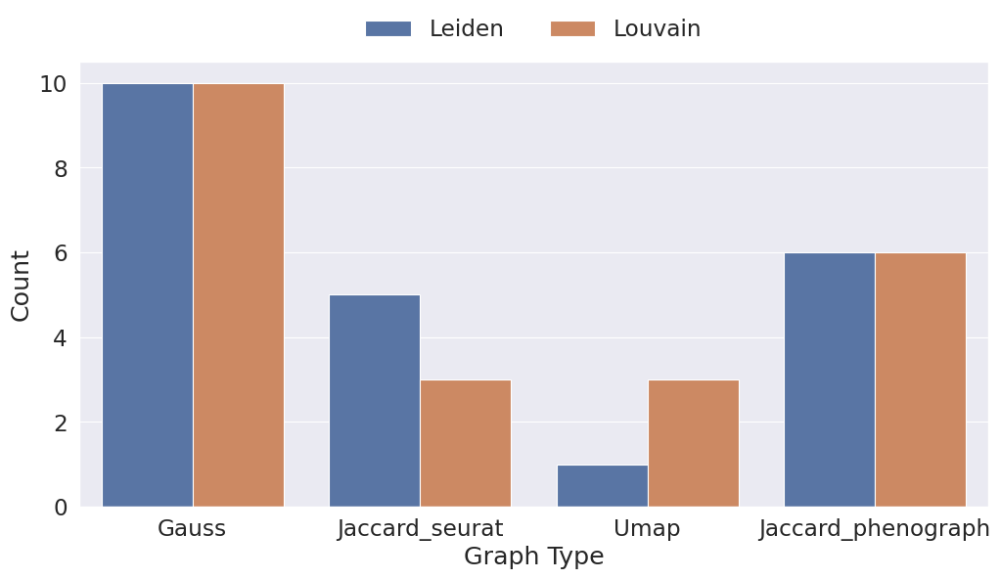

In [22]:
plot = sns.countplot(best_comb, x='Graph_type',hue='Clustering_algorithm',legend= 'full')

sns.move_legend(
    plot, "lower center",
    bbox_to_anchor=(.5, 1), ncol=3, title=None, frameon=False,
)
plt.xlabel("Graph Type")
plt.ylabel("Count")
plt.tight_layout()
#plt.legend(title='Clustering algorithm')

filename = f"/work/Master_Project/Notebooks/plots_paper/graph_type.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')

plt.show()



### For silver vs gold

#### Similarity Measure


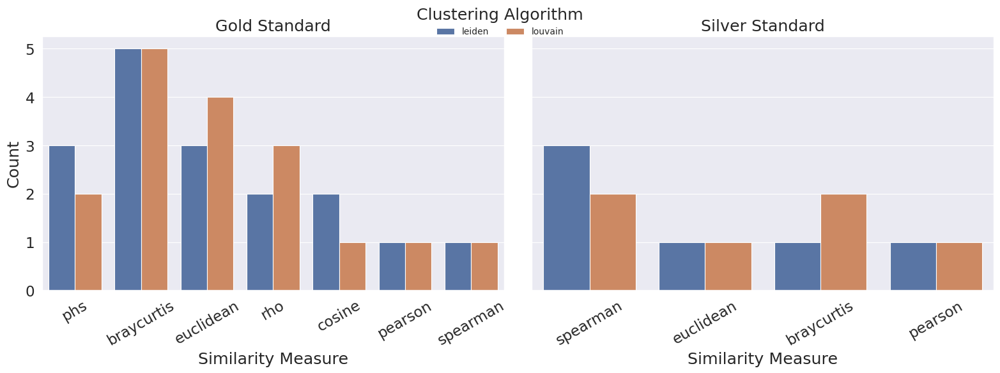

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Split the DataFrame based on the 'Standard' column
gold_df = best_comb_expanded[best_comb_expanded["Standard"] == "gold"]
silver_df = best_comb_expanded[best_comb_expanded["Standard"] == "silver"]

# Set up figure and axes for two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)  # Share y-axis for direct comparison

# Gold Dataset Plot
gold_plot = sns.countplot(data=gold_df, x='Similarity_Measure', hue='Clustering_algorithm', ax=axes[0])
axes[0].set_title("Gold Standard")
axes[0].set_xlabel("Similarity Measure")
axes[0].set_ylabel("Count")
axes[0].tick_params(axis='x', rotation=30)  # Rotate x-axis labels for readability

# Silver Dataset Plot
silver_plot = sns.countplot(data=silver_df, x='Similarity_Measure', hue='Clustering_algorithm', ax=axes[1])
axes[1].set_title("Silver Standard")
axes[1].set_xlabel("Similarity Measure")
axes[1].set_ylabel("")  # Remove y-label from second plot for clarity
axes[1].tick_params(axis='x', rotation=30)  # Rotate x-axis labels for readability


# Adjust legend position
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, title="Clustering Algorithm", loc="upper center", ncol=2, frameon=False, fontsize=10)
axes[0].legend_.remove()  # Remove duplicate legend
axes[1].legend_.remove()

# Improve layout
plt.tight_layout()
plt.show()


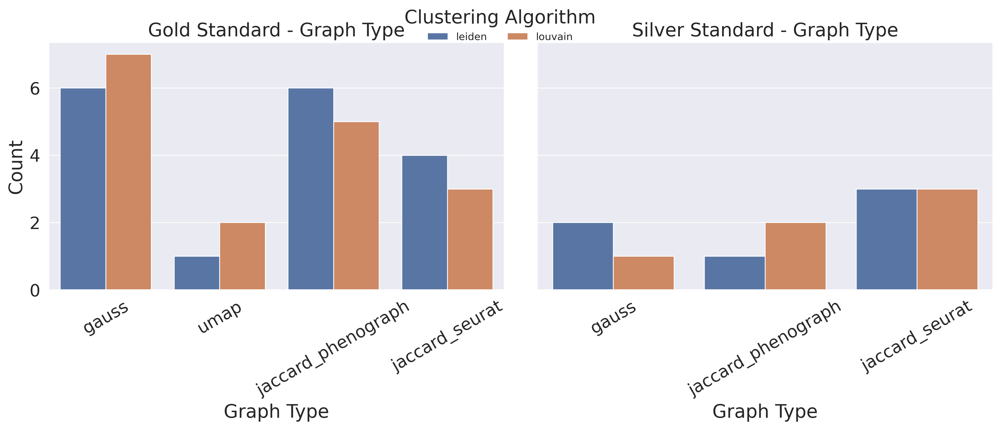

In [33]:
# Set up figure and axes for two subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

# Gold Dataset Plot (Graph_type)
sns.countplot(data=gold_df, x='Graph_type', hue='Clustering_algorithm', ax=axes[0])
axes[0].set_title("Gold Standard - Graph Type")
axes[0].set_xlabel("Graph Type")
axes[0].set_ylabel("Count")
axes[0].tick_params(axis='x', rotation=30)  # Tilt labels

# Silver Dataset Plot (Graph_type)
sns.countplot(data=silver_df, x='Graph_type', hue='Clustering_algorithm', ax=axes[1])
axes[1].set_title("Silver Standard - Graph Type")
axes[1].set_xlabel("Graph Type")
axes[1].set_ylabel("")  # Remove y-label from second plot
axes[1].tick_params(axis='x', rotation=30)  # Tilt labels

# Adjust legend position & size
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, title="Clustering Algorithm", loc="upper center", ncol=2, frameon=False, fontsize=10)

# Remove individual legends
axes[0].legend_.remove()
axes[1].legend_.remove()

plt.tight_layout()
plt.show()

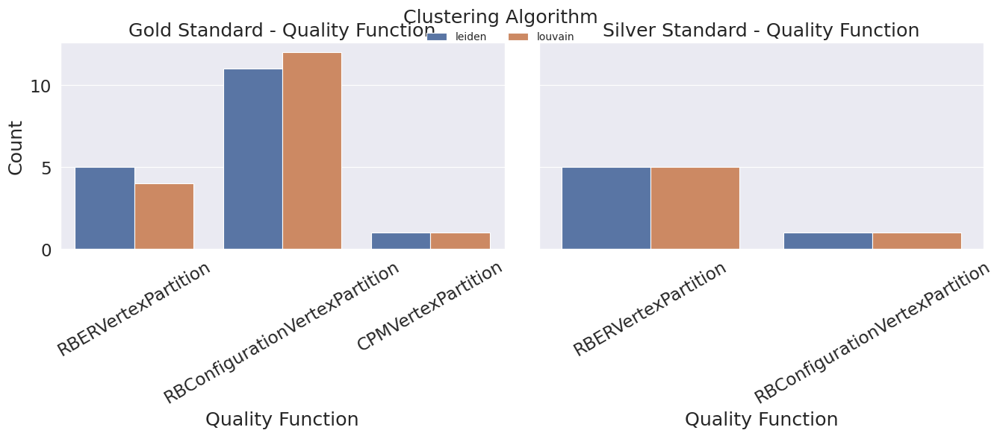

In [16]:
# Set up figure and axes for two subplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)

# Gold Dataset Plot (Quality_Function)
sns.countplot(data=gold_df, x='Quality_Function', hue='Clustering_algorithm', ax=axes[0])
axes[0].set_title("Gold Standard - Quality Function")
axes[0].set_xlabel("Quality Function")
axes[0].set_ylabel("Count")
axes[0].tick_params(axis='x', rotation=30)  # Tilt labels

# Silver Dataset Plot (Quality_Function)
sns.countplot(data=silver_df, x='Quality_Function', hue='Clustering_algorithm', ax=axes[1])
axes[1].set_title("Silver Standard - Quality Function")
axes[1].set_xlabel("Quality Function")
axes[1].set_ylabel("")  # Remove y-label from second plot
axes[1].tick_params(axis='x', rotation=30)  # Tilt labels

# Adjust legend position & size
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, title="Clustering Algorithm", loc="upper center", ncol=2, frameon=False, fontsize=10)

# Remove individual legends
axes[0].legend_.remove()
axes[1].legend_.remove()

plt.tight_layout()
plt.show()

## Distribution of PSI or ARI values between algorithms for the best combinations 

In [54]:
silver_df.PCA_score.apply(type).value_counts()

PCA_score
<class 'float'>    10
<class 'str'>       2
Name: count, dtype: int64

In [53]:
gold_df.PCA_score.apply(type).value_counts()

PCA_score
<class 'float'>    26
<class 'str'>       6
Name: count, dtype: int64

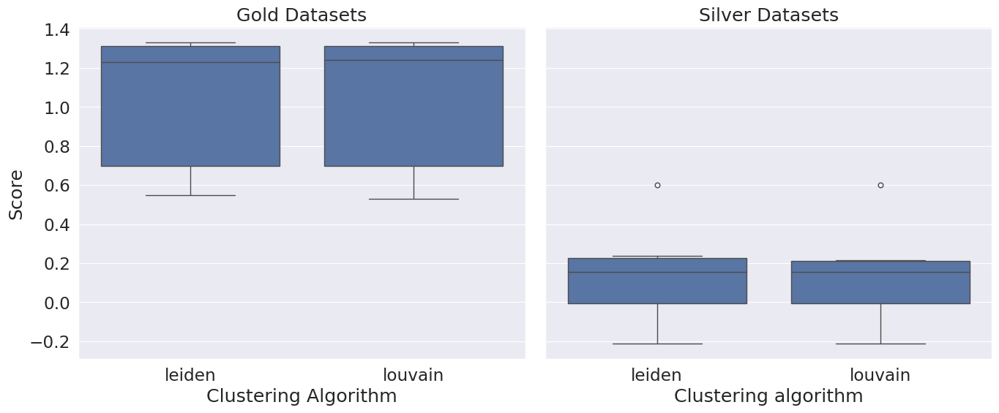

In [30]:
gold_df = best_comb[best_comb["Standard"] == "gold"]
silver_df = best_comb[best_comb["Standard"] == "silver"]

# Set up figure and axes for two side-by-side barplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)  # Share y-axis for direct comparison

# Plot Gold Dataset
sns.boxplot(x='Clustering_algorithm', y='PCA_score', data=gold_df, ax=axes[0])
axes[0].invert_yaxis() 
axes[0].set_title("Gold Datasets")
axes[0].set_xlabel("Clustering Algorithm")
axes[0].set_ylabel("Score")


# Plot Silver Dataset
sns.boxplot(x='Clustering_algorithm', y='PCA_score', data=silver_df, ax=axes[1])
axes[1].set_title("Silver Datasets")
axes[1].set_xlabel("Clustering algorithm")
axes[1].set_ylabel("")  # Remove y-axis label on the second plot for clarity
axes[1].invert_yaxis() 

# # Adjust legend position
# handles, labels = axes[0].get_legend_handles_labels()
# fig.legend(handles, labels, title="Metric", loc="upper right")
# axes[0].legend_.remove()  # Remove duplicate legend from first plot
# axes[1].legend_.remove()  # Remove duplicate legend from second plot

# Show the 

plt.tight_layout()
plt.show()

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


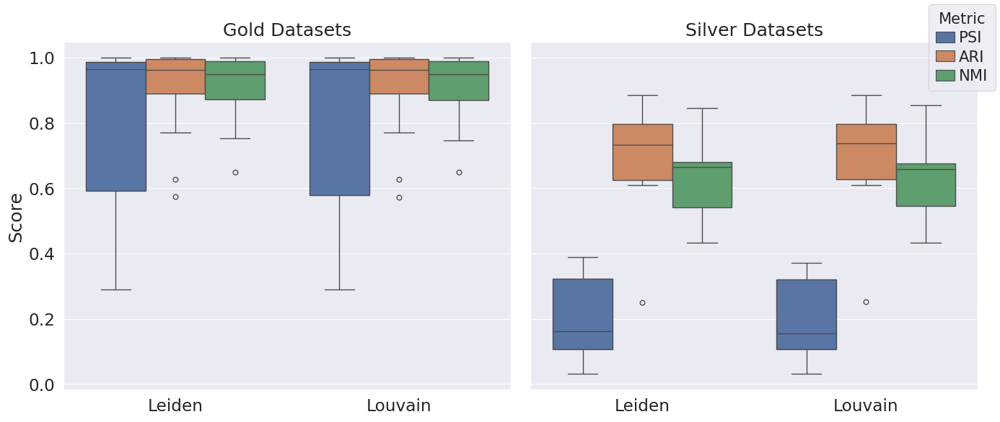

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Split DataFrame into two separate datasets
gold_df = best_comb[best_comb["Standard"] == "gold"]
silver_df = best_comb[best_comb["Standard"] == "silver"]

# Convert both DataFrames to long format for grouped bars
gold_melted = gold_df.melt(id_vars=['Clustering_algorithm'], value_vars=['PSI', 'ARI', 'NMI'],
                           var_name='Metric', value_name='Score')
silver_melted = silver_df.melt(id_vars=['Clustering_algorithm'], value_vars=['PSI', 'ARI', 'NMI'],
                               var_name='Metric', value_name='Score')

# Set up figure and axes for two side-by-side barplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)  # Share y-axis for direct comparison

# Plot Gold Dataset
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=gold_melted, ax=axes[0])
axes[0].set_title("Gold Datasets")
axes[0].set_xlabel("")
axes[0].set_ylabel("Score")
axes[0].invert_yaxis()

# Plot Silver Dataset
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=silver_melted, ax=axes[1])
axes[1].set_title("Silver Datasets")
axes[1].set_xlabel("")
axes[1].set_ylabel("")  # Remove y-axis label on the second plot for clarity
axes[1].invert_yaxis()

# Adjust legend position
handles, labels = axes[0].get_legend_handles_labels()
axes[0].legend_.remove()  # Remove duplicate legend from first plot
axes[1].legend_.remove()  # Remove duplicate legend from second plot


fig.legend(
    handles,
    labels,
    title="Metric",
    loc="upper right",
    fontsize="small",            # Smaller font size for labels
    title_fontsize="small",      # Smaller font size for title
    labelspacing=0.3,            # Reduce space between labels
    handlelength=1.2,            # Shorter legend handles
    handletextpad=0.3,           # Reduce space between handle and text
    borderpad=0.5,               # Padding inside the legend box
    borderaxespad=0.3            # Padding between axes and legend box
)
# Show the plots
plt.tight_layout()

filename = f"/work/Master_Project/Notebooks/plots_paper/optimal_performance/best_distribution.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
plt.show()


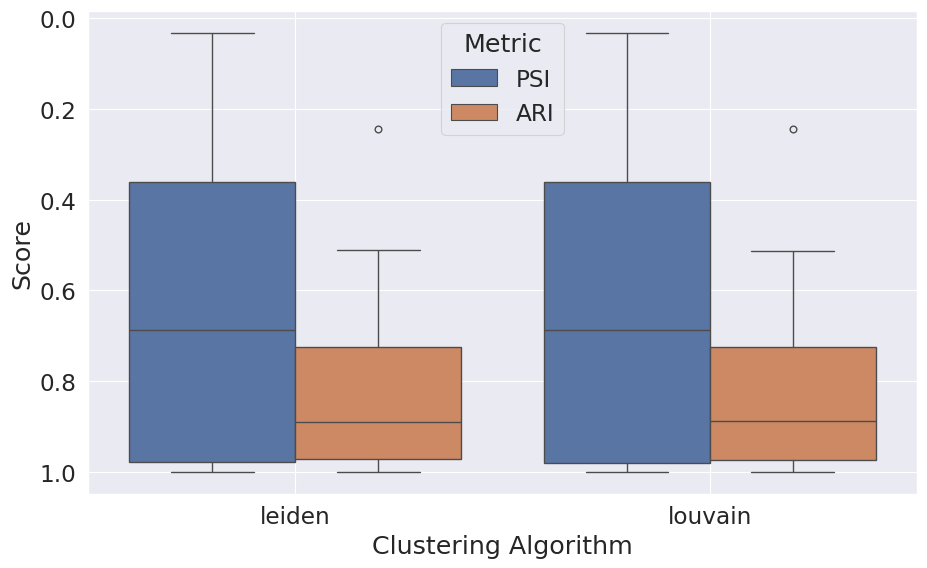

In [21]:
best_comb_melted = best_comb.melt(id_vars=['Clustering_algorithm'], 
                                  value_vars=['PSI', 'ARI'], 
                                  var_name='Metric', 
                                  value_name='Score')

# Set theme and context
sns.set_theme(rc={'figure.figsize':(10.7,6.27)})
sns.set_context("paper", font_scale=1.9)

# Create grouped boxplot
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=best_comb_melted)
plt.gca().invert_yaxis()
# Labels and grid
plt.xlabel('Clustering Algorithm')
plt.ylabel('Score')
plt.grid(True)
plt.legend(title="Metric",)
plt.show()

### Distribution around all results

In [22]:
mean_per_dataset= all_results.groupby(['Dataset', 'Clustering_algorithm'])[['PSI','ARI','NMI']].mean().reset_index()

In [24]:
for idx,row in mean_per_dataset.iterrows():
    mean_per_dataset.loc[idx,'Standard'] = cfg.get_from_dataset(row[0], 'standard')

/tmp/ipykernel_861/2267956399.py:2: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  mean_per_dataset.loc[idx,'Standard'] = cfg.get_from_dataset(row[0], 'standard')
/tmp/ipykernel_861/2267956399.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'silver' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  mean_per_dataset.loc[idx,'Standard'] = cfg.get_from_dataset(row[0], 'standard')
/tmp/ipykernel_861/2267956399.py:2: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  mean_per_dataset.loc[idx,'Standard'] = cfg.get_

In [25]:
mean_per_dataset

,Dataset,Clustering_algorithm,PSI,ARI,NMI,Standard
0,BaronPancreasData,Leiden,0.057620,0.125888,0.433534,silver
1,BaronPancreasData,Louvain,0.057525,0.126312,0.433485,silver
2,Biase,Leiden,0.365805,0.520513,0.653046,gold
3,Biase,Louvain,0.367085,0.521196,0.652966,gold
4,DarmanisBrainData,Leiden,0.100542,0.107878,0.363844,silver
5,DarmanisBrainData,Louvain,0.099803,0.108032,0.363272,silver
6,Deng,Leiden,0.186062,0.441495,0.645051,gold
7,Deng,Louvain,0.186381,0.441752,0.644673,gold
8,Goolam,Leiden,0.174133,0.369256,0.577140,gold
9,Goolam,Louvain,0.173096,0.369410,0.576543,gold


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


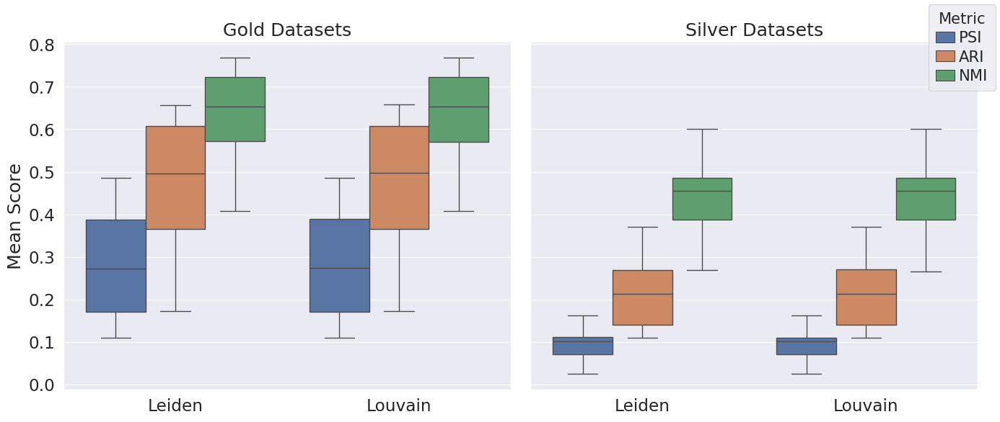

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Split DataFrame into two separate datasets
gold_df = mean_per_dataset[mean_per_dataset["Standard"] == "gold"]
silver_df = mean_per_dataset[mean_per_dataset["Standard"] == "silver"]

# Convert both DataFrames to long format for grouped bars
gold_melted = gold_df.melt(id_vars=['Clustering_algorithm'], value_vars=['PSI', 'ARI', 'NMI'],
                           var_name='Metric', value_name='Score')
silver_melted = silver_df.melt(id_vars=['Clustering_algorithm'], value_vars=['PSI', 'ARI', 'NMI'],
                               var_name='Metric', value_name='Score')

# Set up figure and axes for two side-by-side barplots
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)  # Share y-axis for direct comparison

# Plot Gold Dataset
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=gold_melted, ax=axes[0])
axes[0].set_title("Gold Datasets")
axes[0].set_xlabel("")
axes[0].set_ylabel("Mean Score")
axes[0].invert_yaxis()

# Plot Silver Dataset
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=silver_melted, ax=axes[1])
axes[1].set_title("Silver Datasets")
axes[1].set_xlabel("")
axes[1].set_ylabel("")  # Remove y-axis label on the second plot for clarity
axes[1].invert_yaxis()

# Adjust legend position
handles, labels = axes[0].get_legend_handles_labels()
axes[0].legend_.remove()  # Remove duplicate legend from first plot
axes[1].legend_.remove()  # Remove duplicate legend from second plot


fig.legend(
    handles,
    labels,
    title="Metric",
    loc="upper right",
    fontsize="small",            # Smaller font size for labels
    title_fontsize="small",      # Smaller font size for title
    labelspacing=0.3,            # Reduce space between labels
    handlelength=1.2,            # Shorter legend handles
    handletextpad=0.3,           # Reduce space between handle and text
    borderpad=0.5,               # Padding inside the legend box
    borderaxespad=0.3            # Padding between axes and legend box
)
# Show the plots
plt.tight_layout()

filename = f"/work/Master_Project/Notebooks/plots_paper/expected_performance/mean_distribution.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
plt.show()


In [20]:
all_results

,Dataset,Clustering_algorithm,Similarity_Measure,K_Neighbors,Quality_Function,Graph_type,Resolution,ARI,PSI,NMI
0,Tian-sce_sc_Dropseq_qc,leiden,spearman,76,RBConfigurationVertexPartition,gauss,0.001,0.000000,0.000000,0.000000
1,Tian-sce_sc_Dropseq_qc,leiden,spearman,76,RBConfigurationVertexPartition,gauss,0.021,0.000000,0.000000,0.000000
2,Tian-sce_sc_Dropseq_qc,leiden,spearman,76,RBConfigurationVertexPartition,gauss,0.041,0.000000,0.000000,0.000000
3,Tian-sce_sc_Dropseq_qc,leiden,spearman,76,RBConfigurationVertexPartition,gauss,0.061,0.000000,0.000000,0.000000
4,Tian-sce_sc_Dropseq_qc,leiden,spearman,76,RBConfigurationVertexPartition,gauss,0.081,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...
34911655,TabulaSapiensLiver_cxg,louvain,pearson,97,RBERVertexPartition,jaccard_seurat,1.921,0.481244,0.147496,0.659752
34911656,TabulaSapiensLiver_cxg,louvain,pearson,97,RBERVertexPartition,jaccard_seurat,1.941,0.481078,0.148432,0.660234
34911657,TabulaSapiensLiver_cxg,louvain,pearson,97,RBERVertexPartition,jaccard_seurat,1.961,0.480874,0.143781,0.659219
34911658,TabulaSapiensLiver_cxg,louvain,pearson,97,RBERVertexPartition,jaccard_seurat,1.981,0.480596,0.143494,0.659032


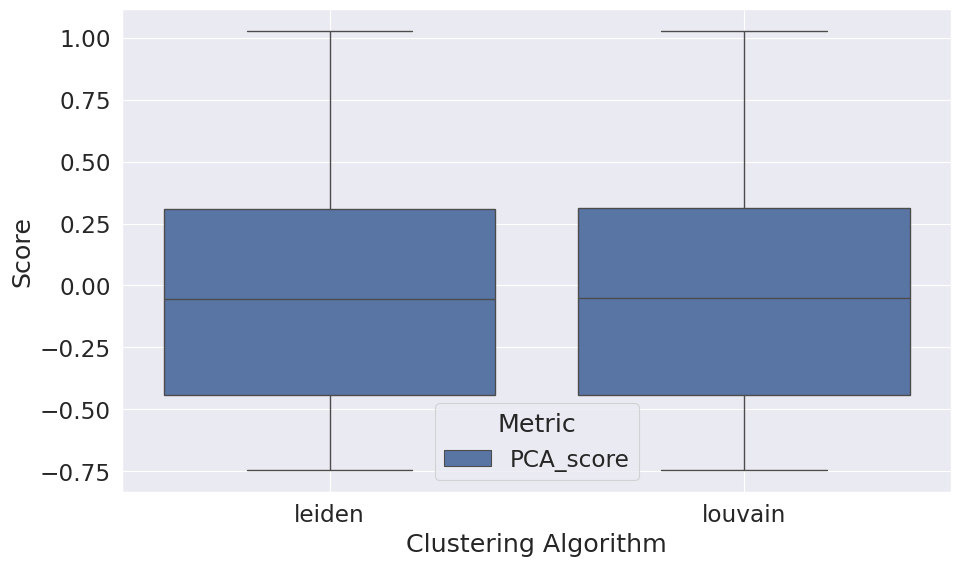

In [23]:
all_results_melted = all_results.melt(id_vars=['Clustering_algorithm'], 
                                  value_vars=['PCA_score'], 
                                  var_name='Metric', 
                                  value_name='Score')

# Set theme and context
sns.set_theme(rc={'figure.figsize':(10.7,6.27)})
sns.set_context("paper", font_scale=1.9)

# Create grouped boxplot
sns.boxplot(x='Clustering_algorithm', y='Score', hue='Metric', data=all_results_melted)
#plt.gca().invert_yaxis()
# Labels and grid
plt.xlabel('Clustering Algorithm')
plt.ylabel('Score')
plt.grid(True)
plt.legend(title="Metric")
plt.show()

## Expected performance across hyper-parameters

In [6]:
y_metrics = ['PSI', 'NMI', 'ARI']  # Replace with actual column names
y_labels = ['PSI (Mean ± SD)', 'NMI (Mean ± SD)', 'ARI (Mean ± SD)']

for y_col, y_label in zip(y_metrics, y_labels):
    plt.figure(figsize=(15.7, 8.27))
    
    plot = sns.pointplot(
        data=best_comb,
        x='Dataset',
        y=y_col,
        hue='Clustering_algorithm',
        ci='sd',
        capsize=.2,
        linestyle='',
        dodge=0.3,
        order=sorted_datasets
    )

    # Add vertical line to separate standards
    plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

    # Add section labels
    plt.text(divider_index / 2, best_comb[y_col].max() + 0.1, 'Gold Standard', 
             horizontalalignment='center', fontsize=14, fontweight='bold')

    plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 
             best_comb[y_col].max() + 0.1, 'Silver Standard', 
             horizontalalignment='center', fontsize=14, fontweight='bold')

    plot.tick_params(labelsize=13)
    plt.xlabel('Dataset')
    plt.xticks(rotation=90)
    plt.ylabel(y_label)
    plt.legend(title='Clustering algorithm', loc='best')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

NameError: name 'sorted_datasets' is not defined

<Figure size 1570x827 with 0 Axes>

/tmp/ipykernel_22947/1052901716.py:10: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=best_comb, x='Dataset', y='PSI',hue='Clustering_algorithm',


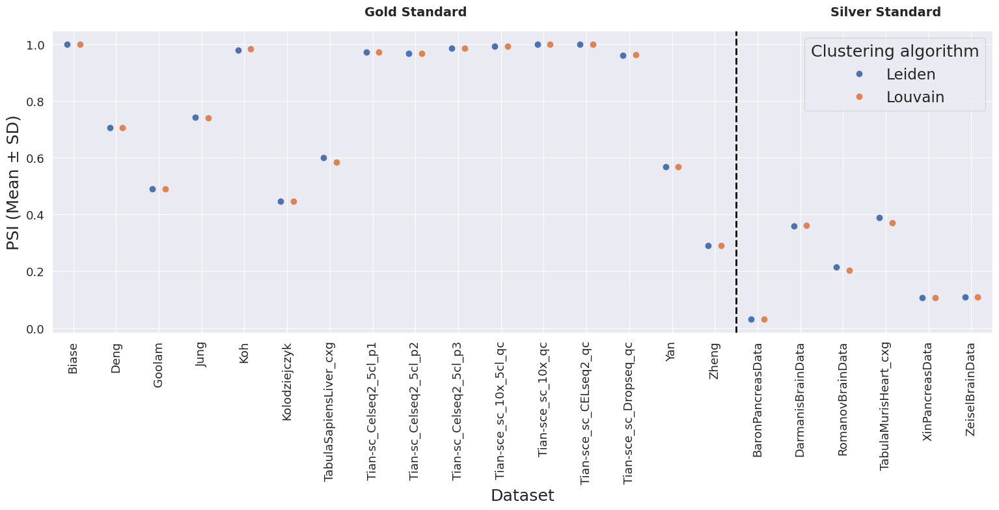

In [14]:
from matplotlib.pyplot import figure


#figure(figsize=(10, 6))
sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)


sorted_datasets = best_comb.sort_values(['Standard','Dataset'])['Dataset'].unique()
b = sns.pointplot(data=best_comb, x='Dataset', y='PSI',hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)


divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, max(all_results['PSI'])+0.1, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), max(all_results['PSI'])+0.1, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

b.tick_params(labelsize=13)


plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('PSI (Mean ± SD)')
plt.legend(title='Clustering algorithm', loc='best')

plt.grid(True)
plt.show()

/tmp/ipykernel_22947/95395874.py:12: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(


NameError: name 'hue_levels' is not defined

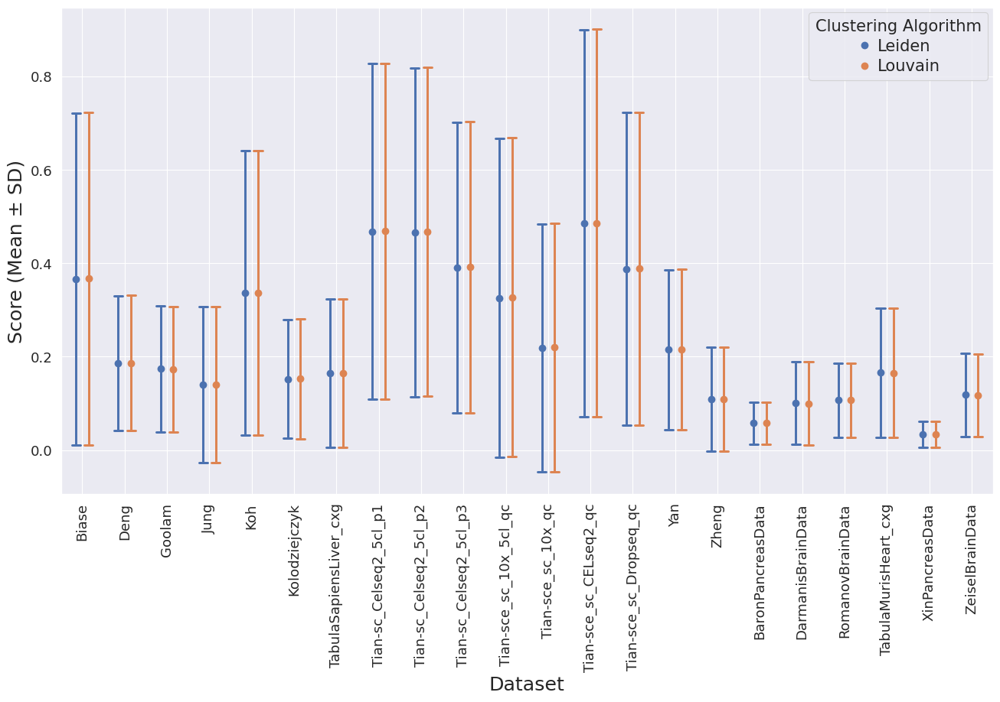

In [15]:
import seaborn as sns
import matplotlib.pyplot as plt

#Set Seaborn theme
sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Sort dataset order by "standard" column (Silver first, then Gold)
sorted_datasets = best_comb.sort_values(['Standard','Dataset'])['Dataset'].unique()

#Create the point plot with the sorted x-axis
b = sns.pointplot(
    data=all_results, 
    x='Dataset', 
    y='PSI', 
    hue='Clustering_algorithm',
    ci='sd', 
    capsize=.2, 
    linestyle='', 
    dodge=0.3,
    order=sorted_datasets  # Apply sorting
)

# Formatting
b.tick_params(labelsize=13)
plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.ylabel('Score (Mean ± SD)')
plt.legend(
    title="Clustering Algorithm",
    fontsize="small",           # Font size for legend labels
    title_fontsize="small",     # Font size for the legend title
    labelspacing=0.3,           # Vertical space between legend entries
    handlelength=1.0,           # Length of the legend handles
    handletextpad=0.3,          # Padding between handle and label
    borderpad=0.4,              # Padding inside the legend box
    borderaxespad=0.3,          # Padding between axes and legend box
    loc="upper right",          # Legend position
    frameon=True                # Keep the frame visible for sizing
)
plt.grid(True)


# --- ADD RED CIRCLES ON MAXIMUM POINTS --- #
# Get the maximum score for each dataset
handles, labels = b.get_legend_handles_labels()
algorithm_labels = labels  # Assumes order matches Seaborn's internal ordering

# Step 2: Extract color mapping from the plotted lines
# Each algorithm corresponds to one line series, one per dataset
# We just extract the first instance per algorithm
algorithm_colors = {}
for handle, label in zip(handles, labels):
    algorithm_colors[label] = handle.get_color()


for _, row in best_comb.iterrows():
    dataset = row['Dataset']
    algorithm = row['Clustering_algorithm']
    score = row['PSI']

    x_index = list(sorted_datasets).index(dataset)
    hue_index = list(hue_levels).index(algorithm)
    dodge_amount = 0.25 * ((hue_index - (total_hues - 1) / 2))

    color = algorithm_colors.get(algorithm, 'black')

    plt.plot(x_index + dodge_amount, score, 'o', markersize=5,
             markerfacecolor='none', markeredgewidth=1, markeredgecolor=color)

### --- ADD SEPARATION LINE --- ###
# Find the index where Gold datasets start
divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, max(all_results['PCA_score'])+0.1, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), max(all_results['PCA_score'])+0.1, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')


plt.show()


In [17]:
handles, labels = b.get_legend_handles_labels()
hue_index = list(hue_levels)


NameError: name 'hue_levels' is not defined

/tmp/ipykernel_868/1657124781.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/expected_performance/PSI_plot.eps


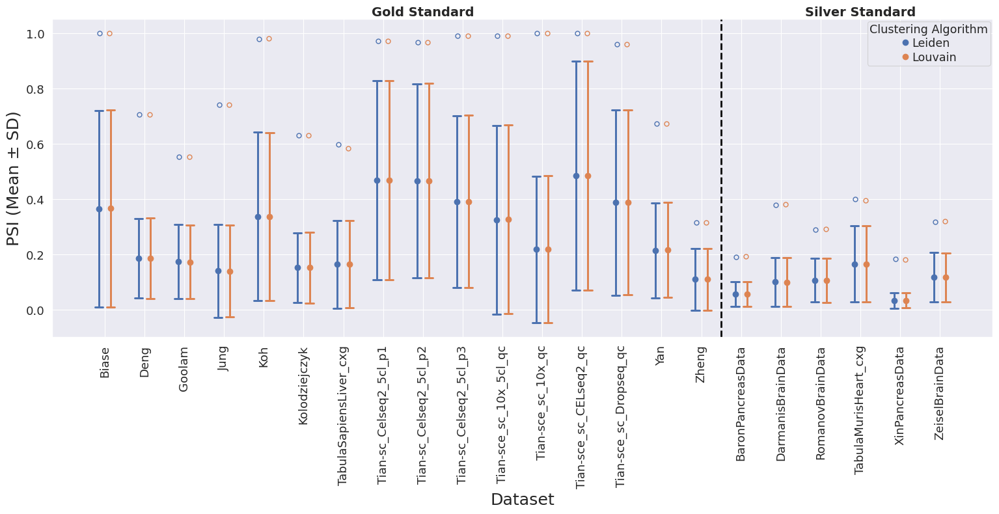

/tmp/ipykernel_868/1657124781.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/expected_performance/ARI_plot.eps


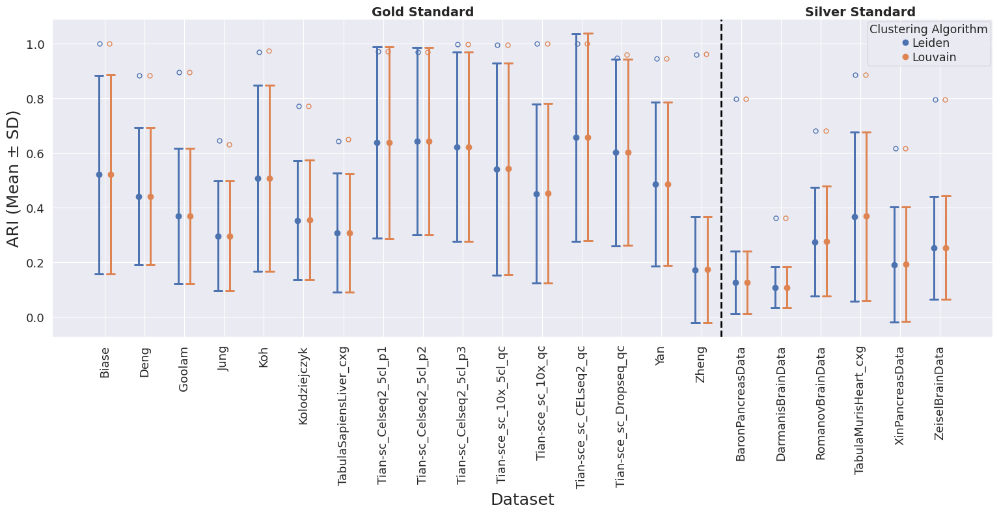

/tmp/ipykernel_868/1657124781.py:26: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/expected_performance/NMI_plot.eps


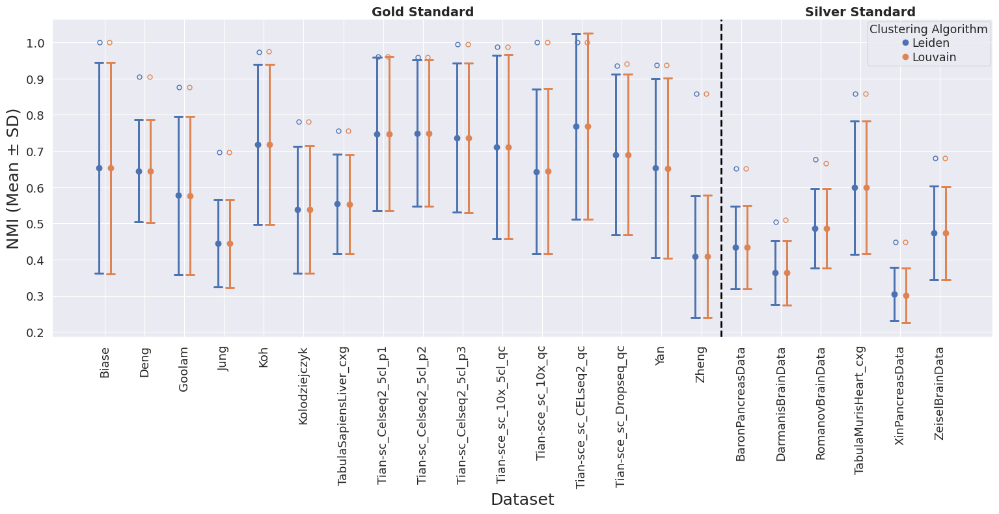

In [17]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set Seaborn theme
sns.set_theme(rc={'figure.figsize': (15.7, 8.27)})
sns.set_context("paper", font_scale=1.9)

hue_levels = all_results['Clustering_algorithm'].unique()
total_hues = len(hue_levels)

# Sort dataset order by "standard" column (Silver first, then Gold)
sorted_datasets = best_comb.sort_values(['Standard', 'Dataset'])['Dataset'].unique()

# Find the divider index (first silver dataset)
divider_index = list(sorted_datasets).index(
    next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver')
)

# Metrics to plot
metrics = ['PSI', 'ARI', 'NMI']  # Replace with your actual metric column names
y_labels = ['PSI (Mean ± SD)', 'ARI (Mean ± SD)', 'NMI (Mean ± SD)']  # Custom Y-axis labels

for metric, y_label in zip(metrics, y_labels):
    plt.figure(figsize=(15.7, 8.27))
    
    b = sns.pointplot(
        data=all_results, 
        x='Dataset', 
        y=metric, 
        hue='Clustering_algorithm',
        ci='sd', 
        capsize=.2, 
        linestyle='', 
        dodge=0.3,
        order=sorted_datasets
    )
    
    b.tick_params(labelsize=13)
    plt.xlabel('Dataset')
    plt.xticks(rotation=90)
    plt.ylabel(y_label)

    plt.legend(
        title="Clustering Algorithm",
        fontsize="x-small",         # Even smaller font
        title_fontsize="x-small",   # Smaller title
        labelspacing=0.2,           # Reduce vertical space between items
        handlelength=0.8,           # Shorter legend key lines
        handletextpad=0.2,          # Less space between line and text
        borderpad=0.2,              # Padding inside legend box
        borderaxespad=0.2,          # Space between legend and axes
        loc="upper right",          # Adjust position
        frameon=True                     # Use 1 column (or more if horizontal fits better)
    )

    
    plt.grid(True)


    # --- ADD RED CIRCLES ON MAXIMUM POINTS --- #
    # Get the maximum score for each dataset
    handles, labels = b.get_legend_handles_labels()
    algorithm_labels = labels  # Assumes order matches Seaborn's internal ordering

    # Step 2: Extract color mapping from the plotted lines
    # Each algorithm corresponds to one line series, one per dataset
    # We just extract the first instance per algorithm
    algorithm_colors = {}
    for handle, label in zip(handles, labels):
        algorithm_colors[label] = handle.get_color()


    for _, row in best_comb.iterrows():
        dataset = row['Dataset']
        algorithm = row['Clustering_algorithm']
        
        # Get the corresponding subset from all_results
        subset = all_results[
            (all_results['Dataset'] == dataset) & 
            (all_results['Clustering_algorithm'] == algorithm)
        ]
    
        # Safety check
        if subset.empty:
            continue
    
        # Extract the best (max) score
        score = subset[metric].max()
    
        # Positioning
        x_index = list(sorted_datasets).index(dataset)
        hue_index = list(hue_levels).index(algorithm)
        dodge_amount = 0.25 * ((hue_index - (total_hues - 1) / 2))
    
        # Coloring
        color = algorithm_colors.get(algorithm, 'black')
    
        # Plotting
        plt.plot(x_index + dodge_amount, score, 'o', markersize=5,
                 markerfacecolor='none', markeredgewidth=1, markeredgecolor=color)

    # Add vertical separation line
    plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)
    
    # Add section labels
# Get y-axis upper limit *after* plotting
    y_min, y_max = plt.ylim()
    y_pos = y_max + 0.01 * (y_max - y_min)  # A tiny bit above the axis top
    
    plt.text(divider_index / 2, y_pos, 'Gold Standard',
             horizontalalignment='center', fontsize=14, fontweight='bold')
    
    plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), y_pos, 'Silver Standard',
             horizontalalignment='center', fontsize=14, fontweight='bold')
    
    plt.tight_layout()
    
    # Save to file
    filename = f"/work/Master_Project/Notebooks/plots_paper/expected_performance/{metric}_plot.eps"
    plt.savefig(filename, format='eps', bbox_inches='tight')
    print(f"Saved: {filename}")
    
    plt.show()





## Robustness analysis 

### Robustness of k

Prepare dataframe with the best combinations

In [41]:
best_comb_shrink = best_comb_expanded.groupby(['Dataset', 'Clustering_algorithm']).first().reset_index()
best_comb_shrink["K_Neighbors"] = pd.to_numeric(best_comb_shrink["K_Neighbors"])
all_results["K_Neighbors"] = pd.to_numeric(all_results["K_Neighbors"])
best_comb_shrink["Resolution"] = pd.to_numeric(best_comb_shrink["Resolution"])
all_results["Resolution"] = pd.to_numeric(all_results["Resolution"])


In [42]:
best_comb_shrink

,Dataset,Clustering_algorithm,Quality_Function,Similarity_Measure,K_Neighbors,Graph_type,PCA_score,ARI,NMI,PSI,Max_across_res_values,Resolution,Mean_PCA_score,Standard
0,BaronPancreasData,Leiden,RBERVertexPartition,Spearman,15,Gauss,0.193503,0.797967,0.651355,0.030827,1,0.021,-0.22084919826429297,silver
1,BaronPancreasData,Louvain,RBERVertexPartition,Spearman,15,Gauss,0.193503,0.797967,0.651355,0.030827,1,0.021,-0.22027559616019815,silver
2,Biase,Leiden,RBERVertexPartition,Phi,14,Gauss,1.025212,1.000000,1.000000,1.000000,81,1.161,None,gold
3,Biase,Louvain,RBERVertexPartition,Phi,14,Gauss,1.025212,1.000000,1.000000,1.000000,81,1.161,None,gold
4,DarmanisBrainData,Leiden,RBERVertexPartition,Spearman,6,Jaccard_seurat,-0.077911,0.249719,0.503346,0.359857,5,0.261,None,silver
5,DarmanisBrainData,Louvain,RBERVertexPartition,Spearman,7,Jaccard_seurat,-0.072344,0.252043,0.510524,0.360890,1,0.361,None,silver
6,Deng,Leiden,RBConfigurationVertexPartition,Bray-Curtis,5,Gauss,0.739511,0.882567,0.905434,0.706455,16,0.201,0.34204937528830937,gold
7,Deng,Louvain,RBERVertexPartition,Bray-Curtis,5,Umap,0.739511,0.882567,0.905434,0.706455,19,0.201,None,gold
8,Goolam,Leiden,RBERVertexPartition,Euclidean,64,Jaccard_phenograph,0.613919,0.891880,0.876055,0.489045,17,1.141,None,gold
9,Goolam,Louvain,RBERVertexPartition,Euclidean,64,Jaccard_phenograph,0.613919,0.891880,0.876055,0.489045,17,1.141,None,gold


In [43]:
matches_k= []
for idx, row in best_comb_shrink.iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset', 'Quality_Function', 'Similarity_Measure','Resolution', 'Graph_type', 'Clustering_algorithm'])   
    best_k = row.K_Neighbors
    matches = matches.sort_values(by="K_Neighbors")
    matches_k.append(matches)

#### Scenario average across entire dataset

In [44]:
appended_data_avg = pd.concat(matches_k)

/tmp/ipykernel_1598/1095244171.py:7: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_avg, x='Dataset', y='PCA_score',hue='Clustering_algorithm',


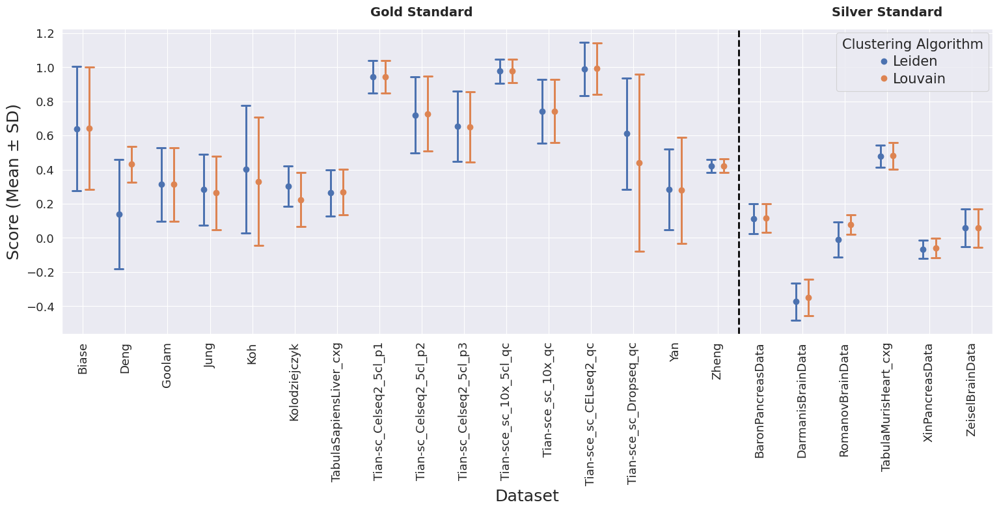

In [45]:
#figure(figsize=(10, 6))
sorted_datasets = best_comb_shrink.sort_values(['Standard','Dataset'])['Dataset'].unique()

sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)

b = sns.pointplot(data=appended_data_avg, x='Dataset', y='PCA_score',hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)


b.tick_params(labelsize=13)

divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, 1.3, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.3, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('Score (Mean ± SD)')
plt.legend(
    title="Clustering Algorithm",
    fontsize="small",           # Font size for legend labels
    title_fontsize="small",     # Font size for the legend title
    labelspacing=0.3,           # Vertical space between legend entries
    handlelength=0.7,           # Length of the legend handles
    handletextpad=0.3,          # Padding between handle and label
    borderpad=0.4,              # Padding inside the legend box
    borderaxespad=0.3,          # Padding between axes and legend box
    loc="upper right",          # Legend position
    frameon=True                # Keep the frame visible for sizing
)
plt.grid(True)
plt.show()

/tmp/ipykernel_23132/3650040972.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_avg, x='Dataset', y=metric,hue='Clustering_algorithm',


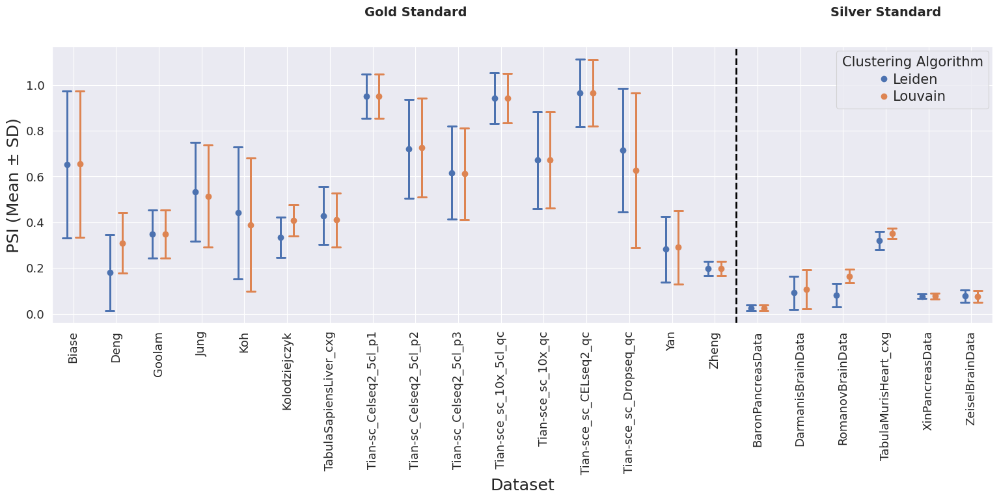

/tmp/ipykernel_23132/3650040972.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_avg, x='Dataset', y=metric,hue='Clustering_algorithm',


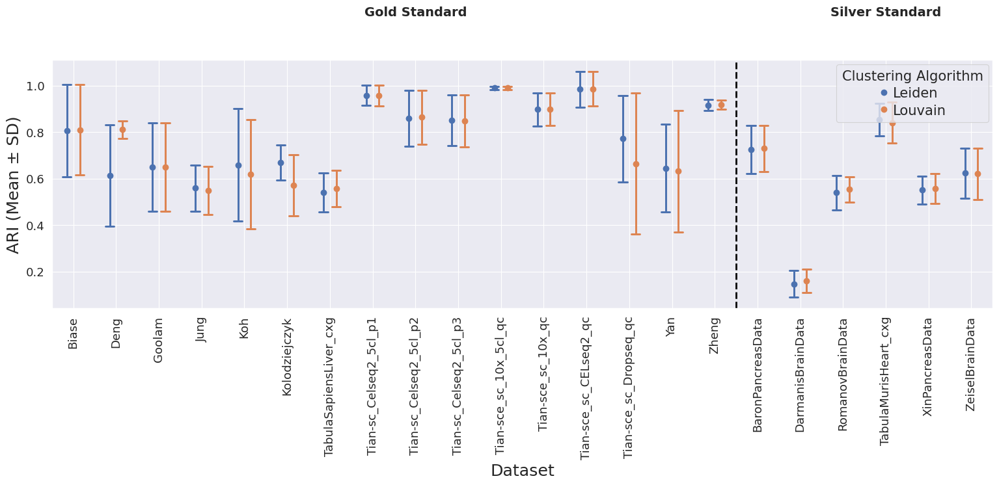

/tmp/ipykernel_23132/3650040972.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_avg, x='Dataset', y=metric,hue='Clustering_algorithm',


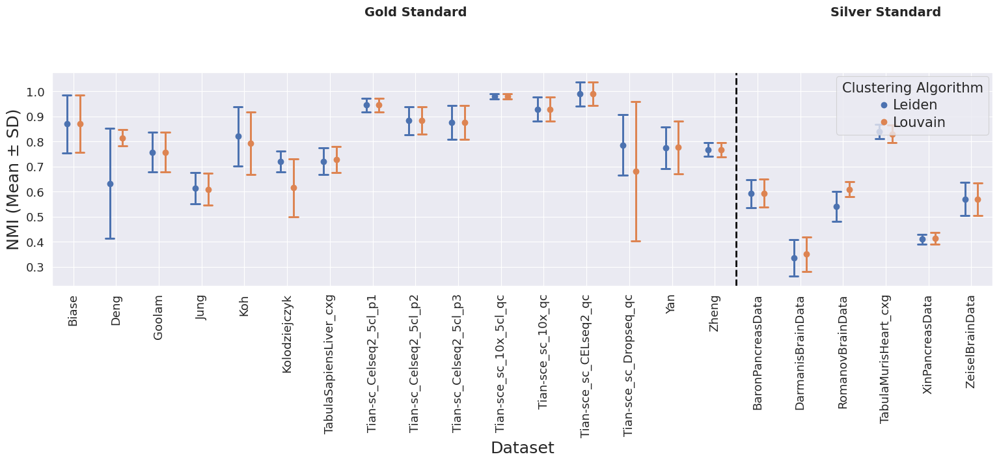

In [19]:
metrics = ['PSI', 'ARI', 'NMI']  # Replace with your actual metric column names
y_labels = ['PSI (Mean ± SD)', 'ARI (Mean ± SD)', 'NMI (Mean ± SD)']  # Custom Y-axis labels

for metric, y_label in zip(metrics, y_labels):
    plt.figure(figsize=(15.7, 8.27))
    b = sns.pointplot(data=appended_data_avg, x='Dataset', y=metric,hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)


    b.tick_params(labelsize=13)

    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

    # Add a vertical separation line
    plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

    # Label sections
    plt.text(divider_index / 2, 1.3, 'Gold Standard', 
            horizontalalignment='center', fontsize=14, fontweight='bold')

    plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.3, 'Silver Standard', 
            horizontalalignment='center', fontsize=14, fontweight='bold')

    plt.xlabel('Dataset')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.ylabel(y_label)
    plt.legend(
        title="Clustering Algorithm",
        fontsize="small",           # Font size for legend labels
        title_fontsize="small",     # Font size for the legend title
        labelspacing=0.3,           # Vertical space between legend entries
        handlelength=0.7,           # Length of the legend handles
        handletextpad=0.3,          # Padding between handle and label
        borderpad=0.4,              # Padding inside the legend box
        borderaxespad=0.3,          # Padding between axes and legend box
        loc="upper right",          # Legend position
        frameon=True                # Keep the frame visible for sizing
    )
    plt.grid(True)
    plt.show()
        

#### Scenario with +- absolute value

In [ ]:
dfs = []
for idx, row in best_comb_shrink.iterrows():
    # Find matches based on multiple column criteria
    best_k = row.K_Neighbors
    k_all_range = matches_k[idx]
    optimal_range = round(len(k_all_range) * 0.1)

    # Select values within the range of best_k ± 10
    match_k = k_all_range[(k_all_range.K_Neighbors >= best_k - optimal_range) & (k_all_range.K_Neighbors <= best_k + optimal_range)]

    # # If fewer than 21 matches, adjust by taking extra values
    # if len(match_k) < 21:
    #     extra_needed = 21 - len(match_k)
        
    #     # Try to take from upper range first
    #     additional_matches_upper = k_all_range[k_all_range.K_Neighbors > best_k + 10].head(extra_needed)
    #     remaining_needed = extra_needed - len(additional_matches_upper)
        
    #     # If still not enough, take from lower range
    #     additional_matches_lower = pd.DataFrame()
    #     if remaining_needed > 0:
    #         additional_matches_lower = k_all_range[k_all_range.K_Neighbors < best_k - 10].tail(remaining_needed)
        
    #     # Combine original matches with extra matches
    #     match_k = pd.concat([match_k, additional_matches_upper, additional_matches_lower])

    # Ensure exactly 21 rows and keep K_Neighbors sorted
    #match_k = match_k.sort_values(by="K_Neighbors").head(optimal_range)

    dfs.append(match_k)

# Concatenate all matches
appended_data_10 = pd.concat(dfs)

In [ ]:
for idx, row in appended_data_10.groupby(['Dataset', 'Clustering_algorithm']):
    print(np.unique(row.K_Neighbors),idx)

/tmp/ipykernel_23132/3167540016.py:8: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10, x='Dataset', y='PCA_score',hue='Clustering_algorithm',


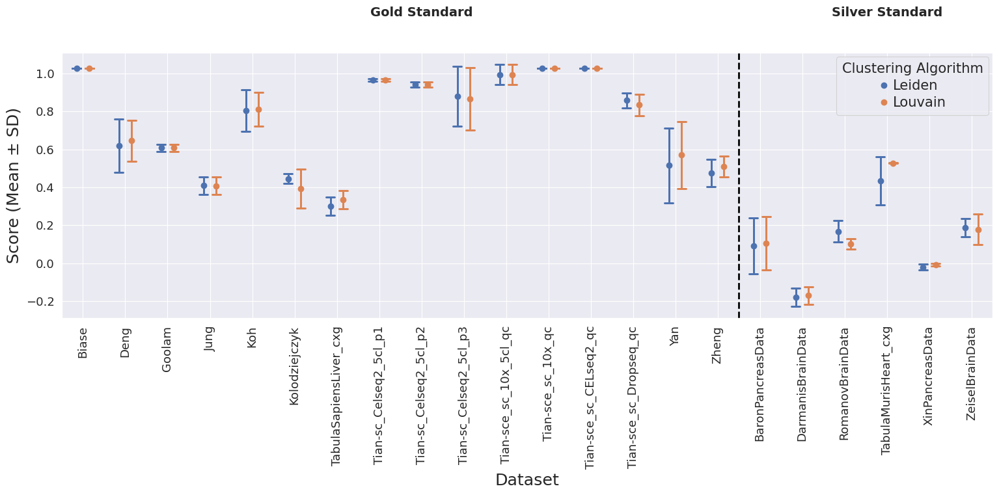

In [22]:


#figure(figsize=(10, 6))


sorted_datasets = best_comb_shrink.sort_values(['Standard','Dataset'])['Dataset'].unique()
sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)

b = sns.pointplot(data=appended_data_10, x='Dataset', y='PCA_score',hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3,order=sorted_datasets)




b.tick_params(labelsize=13)


### --- ADD SEPARATION LINE --- ###
# Find the index where Gold datasets start
divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, 1.3, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.3, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')
plt.draw()
plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('Score (Mean ± SD)')
plt.legend(
    title="Clustering Algorithm",
    fontsize="small",           # Font size for legend labels
    title_fontsize="small",     # Font size for the legend title
    labelspacing=0.3,           # Vertical space between legend entries
    handlelength=0.7,           # Length of the legend handles
    handletextpad=0.3,          # Padding between handle and label
    borderpad=0.4,              # Padding inside the legend box
    borderaxespad=0.3,          # Padding between axes and legend box
    loc="upper right",          # Legend position
    frameon=True                # Keep the frame visible for sizing
)
plt.grid(True)
plt.show()

#### Scenario with +- percentage of optimal value

In [23]:
best_comb_shrink

,Dataset,Clustering_algorithm,Quality_Function,Similarity_Measure,K_Neighbors,Graph_type,PCA_score,ARI,NMI,PSI,Max_across_res_values,Resolution,Mean_PCA_score,Standard
0,BaronPancreasData,Leiden,RBERVertexPartition,Spearman,15,Gauss,0.193503,0.797967,0.651355,0.030827,1,0.021,-0.22084919826429297,silver
1,BaronPancreasData,Louvain,RBERVertexPartition,Spearman,15,Gauss,0.193503,0.797967,0.651355,0.030827,1,0.021,-0.22027559616019815,silver
2,Biase,Leiden,RBERVertexPartition,Phi,14,Gauss,1.025212,1.000000,1.000000,1.000000,81,1.161,None,gold
3,Biase,Louvain,RBERVertexPartition,Phi,14,Gauss,1.025212,1.000000,1.000000,1.000000,81,1.161,None,gold
4,DarmanisBrainData,Leiden,RBERVertexPartition,Spearman,6,Jaccard_seurat,-0.077911,0.249719,0.503346,0.359857,5,0.261,None,silver
5,DarmanisBrainData,Louvain,RBERVertexPartition,Spearman,7,Jaccard_seurat,-0.072344,0.252043,0.510524,0.360890,1,0.361,None,silver
6,Deng,Leiden,RBConfigurationVertexPartition,Bray-Curtis,5,Gauss,0.739511,0.882567,0.905434,0.706455,16,0.201,0.34204937528830937,gold
7,Deng,Louvain,RBERVertexPartition,Bray-Curtis,5,Umap,0.739511,0.882567,0.905434,0.706455,19,0.201,None,gold
8,Goolam,Leiden,RBERVertexPartition,Euclidean,64,Jaccard_phenograph,0.613919,0.891880,0.876055,0.489045,17,1.141,None,gold
9,Goolam,Louvain,RBERVertexPartition,Euclidean,64,Jaccard_phenograph,0.613919,0.891880,0.876055,0.489045,17,1.141,None,gold


In [ ]:
dfs=[]
for idx, row in best_comb_shrink.iterrows():
    # Find matches based on multiple column criteria
    best_k = row.K_Neighbors
    best_percentage =  math.ceil(best_k * 0.1)
    
    k_all_range = matches_k[idx]

    match_k = k_all_range[(k_all_range.K_Neighbors >= best_k - best_percentage) & (k_all_range.K_Neighbors <= best_k + best_percentage)]
    print(f"Optimal k for {row.Dataset},{row.Clustering_algorithm} = {best_k}. Range around optimal (with optimal k included) has {len(match_k)} values ")

    dfs.append(match_k)

# Concatenate all matches
appended_data_10_per = pd.concat(dfs)

/tmp/ipykernel_23132/679268688.py:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10_per, x='Dataset', y=metric, hue='Clustering_algorithm',
/tmp/ipykernel_23132/679268688.py:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10_per, x='Dataset', y=metric, hue='Clustering_algorithm',
/tmp/ipykernel_23132/679268688.py:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10_per, x='Dataset', y=metric, hue='Clustering_algorithm',


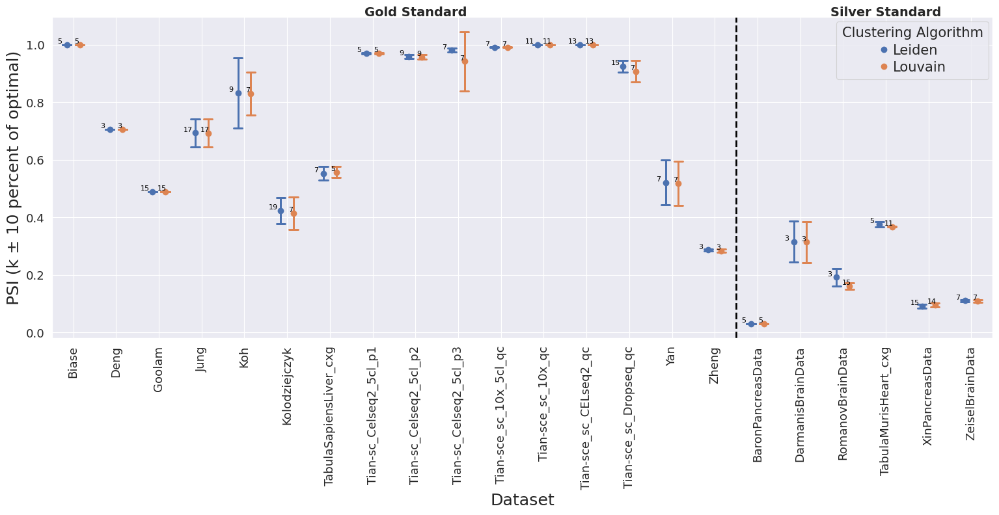

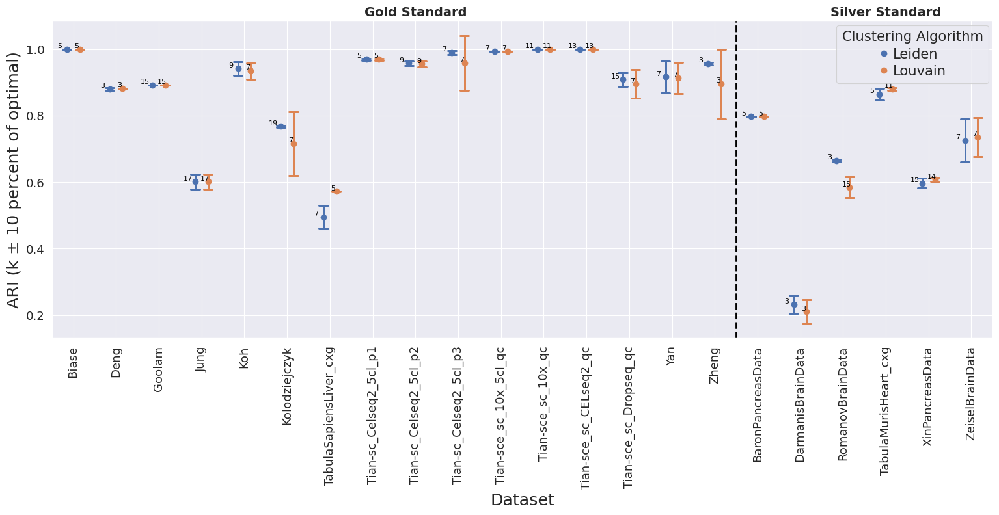

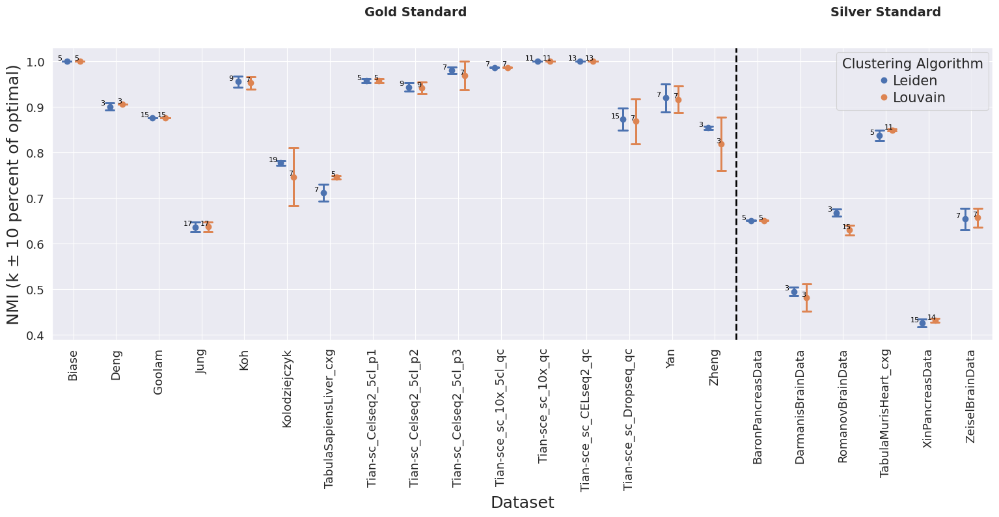

In [25]:
sorted_datasets = best_comb_shrink.sort_values(['Standard','Dataset'])['Dataset'].unique()

metrics = ['PSI', 'ARI', 'NMI']  # Replace with your actual metric column names
y_labels = ['PSI (Mean ± SD)', 'ARI (Mean ± SD)', 'NMI (Mean ± SD)']  # Custom Y-axis labels

for metric, y_label in zip(metrics, y_labels):
    plt.figure(figsize=(15.7, 8.27))


    # Create the point plot
    b = sns.pointplot(data=appended_data_10_per, x='Dataset', y=metric, hue='Clustering_algorithm',
                    ci='sd', legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)

    b.tick_params(labelsize=13)





    # Annotating each dataset with values from the dictionary



    dataset_count = defaultdict(int)

    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per.loc[
            (appended_data_10_per['Dataset'] == row.Dataset) & 
            (appended_data_10_per['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset[metric].mean()

        # Introduce a slight shift to avoid overlap
        offset = (dataset_count[row.Dataset] - 0.8) * 0.4  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count[row.Dataset] += 1  # Increment occurrence for next duplicate

        plt.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=8, color='black')  # Customize font





    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

    # Add a vertical separation line
    plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

    # Label sections
    plt.text(divider_index / 2, 1.1, 'Gold Standard', 
            horizontalalignment='center', fontsize=14, fontweight='bold')

    plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.1, 'Silver Standard', 
            horizontalalignment='center', fontsize=14, fontweight='bold')
    plt.draw()

    # Customize labels and layout
    plt.xlabel('Dataset')
    plt.xticks(rotation=90)
    plt.tight_layout()
    plt.ylabel(f'{metric} (k ± 10 percent of optimal)')
    plt.legend(
        title="Clustering Algorithm",
        fontsize="small",           # Font size for legend labels
        title_fontsize="small",     # Font size for the legend title
        labelspacing=0.3,           # Vertical space between legend entries
        handlelength=0.7,           # Length of the legend handles
        handletextpad=0.3,          # Padding between handle and label
        borderpad=0.4,              # Padding inside the legend box
        borderaxespad=0.3,          # Padding between axes and legend box
        loc="best",          # Legend position
        frameon=True                # Keep the frame visible for sizing
    )
    plt.grid(True)
    #plt.show()

    plt.tight_layout()


#### Compare different scenarios for k

/tmp/ipykernel_23132/3040886418.py:35: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='PCA_score', hue='Clustering_algorithm',
/tmp/ipykernel_23132/3040886418.py:48: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10, x='Dataset', y='PCA_score', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/3040886418.py:62: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per, x='Dataset', y='PCA_score', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/3040886418.py:74: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(


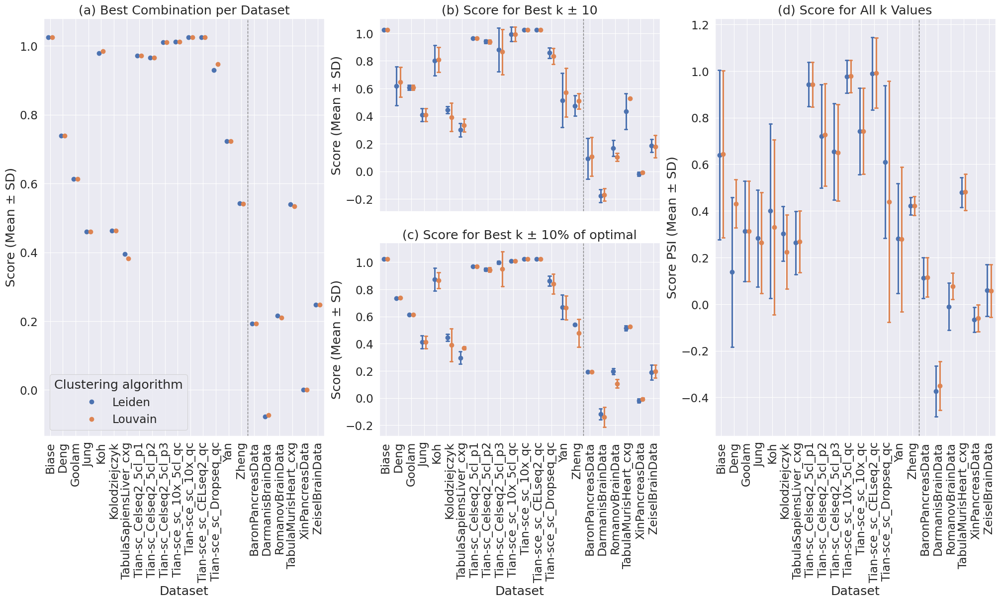

In [26]:
from matplotlib.gridspec import GridSpec
import matplotlib.pyplot as plt
import seaborn as sns
import math
from collections import defaultdict

# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10['PCA_score'].min(), 
               appended_data_avg['PCA_score'].min(), 
               appended_data_10_per['PCA_score'].min(),
               appended_data_avg['PCA_score'].min())
ylim_max = max(appended_data_10['PCA_score'].max(), 
               appended_data_avg['PCA_score'].max(), 
               appended_data_10_per['PCA_score'].max(),
               appended_data_avg['PCA_score'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='PCA_score', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('Score (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best Combination per Dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10, x='Dataset', y='PCA_score', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('Score (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) Score for Best k ± 10')
add_divider(ax2)
ax2.grid(True)

# Plot 3 - Top row, third column
#ax3 = fig.add_subplot(gs[0, 2])

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per, x='Dataset', y='PCA_score', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('Score (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(c) Score for Best k ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)

# Plot 5 - Bottom row, third column (Same as Plot 3)
#ax5 = fig.add_subplot(gs[1, 2])
ax3_combined = fig.add_subplot(gs[:, 2])
sns.pointplot(
    data=appended_data_avg, 
    x='Dataset', 
    y='PCA_score', 
    hue='Clustering_algorithm',
    ci='sd', 
    capsize=.2, 
    linestyle='', 
    dodge=0.3, 
    order=sorted_datasets, 
    ax=ax3_combined,
    legend=False
)
ax3_combined.set_xlabel('Dataset')
ax3_combined.set_ylabel('Score PSI (Mean ± SD)')
ax3_combined.tick_params(axis='x', rotation=90)
ax3_combined.set_title('(d) Score for All k Values')
add_divider(ax3_combined)
ax3_combined.grid(True)

plt.show()


### Robustness of resolution

In [29]:
matches_res= []
for idx, row in best_comb_shrink.iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset', 'Quality_Function', 'Similarity_Measure','K_Neighbors', 'Graph_type', 'Clustering_algorithm'])   
    best_res = row.Resolution
    matches = matches.sort_values(by="Resolution")
    matches_res.append(matches)

#### Scenario average across entire dataset

In [50]:
appended_data_avg_res = pd.concat(matches_res)

/tmp/ipykernel_23132/3438777762.py:7: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_avg_res, x='Dataset', y='PCA_score',hue='Clustering_algorithm',


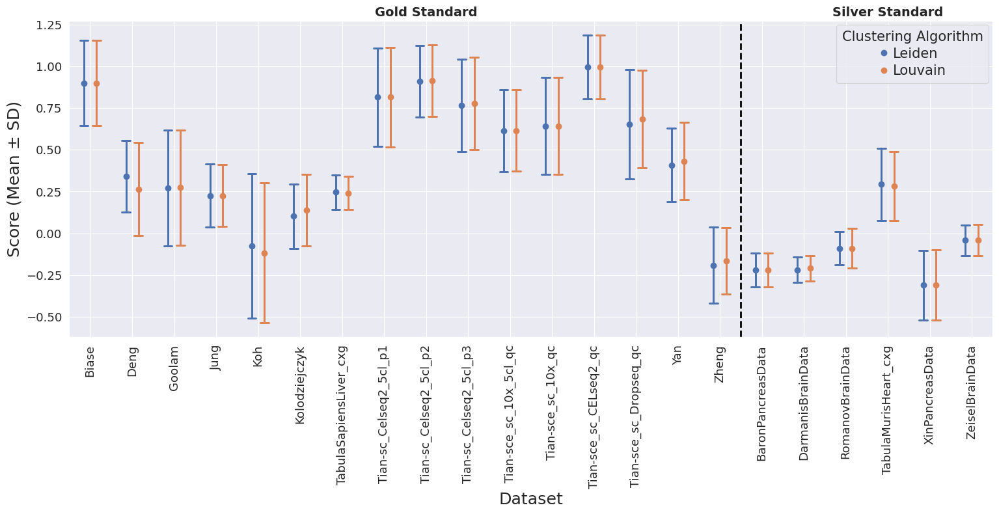

In [29]:
#figure(figsize=(10, 6))
sorted_datasets = best_comb_shrink.sort_values(['Standard','Dataset'])['Dataset'].unique()

sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)

b = sns.pointplot(data=appended_data_avg_res, x='Dataset', y='PCA_score',hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)


b.tick_params(labelsize=13)

divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, 1.3, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.3, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('Score (Mean ± SD)')
plt.legend(
    title="Clustering Algorithm",
    fontsize="small",           # Font size for legend labels
    title_fontsize="small",     # Font size for the legend title
    labelspacing=0.3,           # Vertical space between legend entries
    handlelength=0.7,           # Length of the legend handles
    handletextpad=0.3,          # Padding between handle and label
    borderpad=0.4,              # Padding inside the legend box
    borderaxespad=0.3,          # Padding between axes and legend box
    loc="upper right",          # Legend position
    frameon=True                # Keep the frame visible for sizing
)
plt.grid(True)
plt.show()

#### Scenario with +- absolute value

In [ ]:
dfs = []
for idx, row in best_comb_shrink.iterrows():
    best_res = row.Resolution
    res_all_range = matches_res[idx]
    match_res = res_all_range[(res_all_range.Resolution >= round((best_res - 0.2),3)) & 
                              (res_all_range.Resolution <= round((best_res + 0.2),3))]
    # if len(match_res) < 21:
    #     extra_needed = 21 - len(match_res)
        
    #     additional_matches_upper = res_all_range[res_all_range.Resolution > best_res + 0.2].head(extra_needed)
    #     remaining_needed = extra_needed - len(additional_matches_upper)
        
    #     additional_matches_lower = pd.DataFrame()
    #     if remaining_needed > 0:
    #         additional_matches_lower = res_all_range[res_all_range.Resolution < best_res - 0.2].tail(remaining_needed)
        
    #     match_res = pd.concat([match_res, additional_matches_upper, additional_matches_lower])
    print(f"Optimal k for {row.Dataset},{row.Clustering_algorithm} = {best_res}. Range around optimal (with optimal k included) has {len(match_res)} values ")

    #match_res = match_res.sort_values(by="Resolution").head(21)

    print(np.unique(match_res.Resolution))

    dfs.append(match_res)
appended_data_10_res = pd.concat(dfs)


/tmp/ipykernel_1598/2645856331.py:8: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI',hue='Clustering_algorithm',


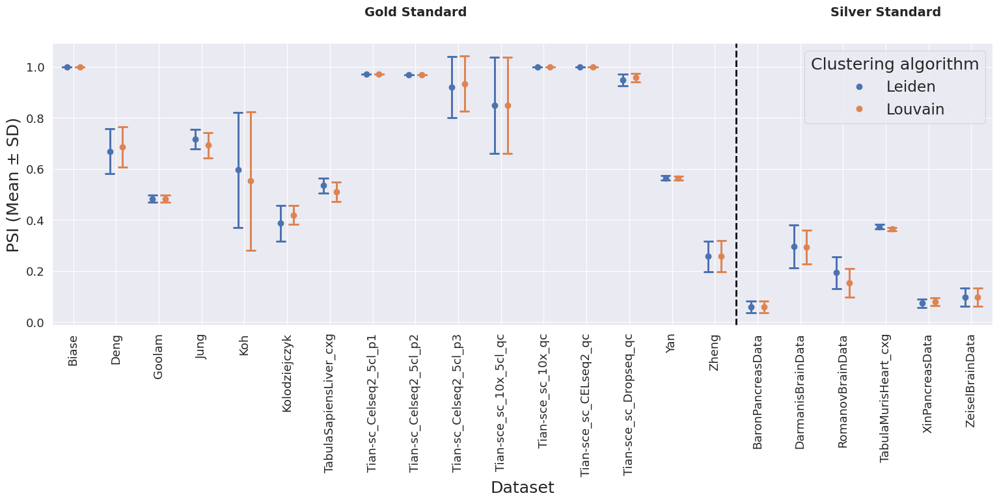

In [38]:


#figure(figsize=(10, 6))


sorted_datasets = best_comb_shrink.sort_values(['Standard','Dataset'])['Dataset'].unique()
sns.set_theme(rc={'figure.figsize':(15.7,8.27)})
sns.set_context("paper", font_scale=1.9)

b = sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI',hue='Clustering_algorithm',
             ci='sd',legend='full', capsize=.2, linestyle='', dodge=0.3,order=sorted_datasets)




b.tick_params(labelsize=13)


### --- ADD SEPARATION LINE --- ###
# Find the index where Gold datasets start
divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, 1.2, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.2, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')
plt.draw()
plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('PSI (Mean ± SD)')
plt.legend(title='Clustering algorithm', loc='best')
plt.grid(True)
plt.show()

#### Scenario with +- percentage of optimal value

In [ ]:
def ceil_to_nearest(value, base=0.001, step=0.02):
    index = math.ceil((value - base) / step)
    return round(base + index * step, 6)  # round to avoid floating point errors

dfs=[]
for idx, row in best_comb_shrink.iterrows():
    # Find matches based on multiple column criteria
    best_res = row.Resolution
    best_percentage =  ceil_to_nearest(best_res * 0.1)
    print(best_percentage)
    
    res_all_range = matches_res[idx]

    match_res= res_all_range[(res_all_range.Resolution >= best_res - best_percentage) & (res_all_range.Resolution <= best_res + best_percentage)]
    print(f"Optimal resolution for {row.Dataset},{row.Clustering_algorithm} = {best_res}. Range around optimal (with optimal res included) has {len(match_res)} values ")

    dfs.append(match_res)

# Concatenate all matches
appended_data_10_per_res = pd.concat(dfs)

/tmp/ipykernel_23132/655051152.py:2: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  b = sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PCA_score', hue='Clustering_algorithm',


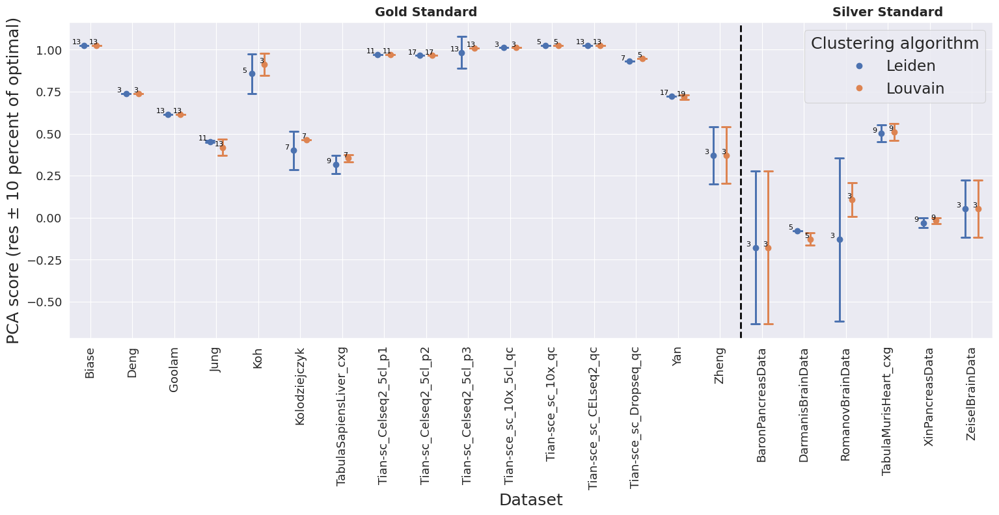

In [33]:




# Create the point plot
b = sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PCA_score', hue='Clustering_algorithm',
                  ci='sd', legend='full', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets)

b.tick_params(labelsize=13)




b.tick_params(labelsize=13)

# Annotating each dataset with values from the dictionary



dataset_count = defaultdict(int)

for idx, row in best_comb_shrink.iterrows():
    x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
    clustering_alg = row.Clustering_algorithm

    # Fetch corresponding dataset slice
    slice_dataset = appended_data_10_per_res.loc[
        (appended_data_10_per_res['Dataset'] == row.Dataset) & 
        (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
    ]

    value = len(slice_dataset)
    y_pos = slice_dataset.PCA_score.mean()

    # Introduce a slight shift to avoid overlap
    offset = (dataset_count[row.Dataset] - 0.8) * 0.4  # Adjust shifting scale if needed
    x_pos_shifted = x_pos + offset
    dataset_count[row.Dataset] += 1  # Increment occurrence for next duplicate

    plt.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
             s=f'{value}',  # Format the annotation text
             ha='center', va='bottom', fontsize=8, color='black')  # Customize font





divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))

# Add a vertical separation line
plt.axvline(x=divider_index - 0.5, color='black', linestyle='--', linewidth=2)

# Label sections
plt.text(divider_index / 2, 1.2, 'Gold Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')

plt.text(divider_index + ((len(sorted_datasets) - divider_index) / 2), 1.2, 'Silver Standard', 
         horizontalalignment='center', fontsize=14, fontweight='bold')
plt.draw()

# Customize labels and layout
plt.xlabel('Dataset')
plt.xticks(rotation=90)
plt.tight_layout()
plt.ylabel('PCA score (res ± 10 percent of optimal)')
plt.legend(title='Clustering algorithm', loc='best')
plt.grid(True)
#plt.show()

plt.tight_layout()


#### Compare different scenarios for resolution

##### Percentage change

/tmp/ipykernel_23132/2685700391.py:35: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
/tmp/ipykernel_23132/2685700391.py:48: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2685700391.py:85: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2685700391.py:123: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(


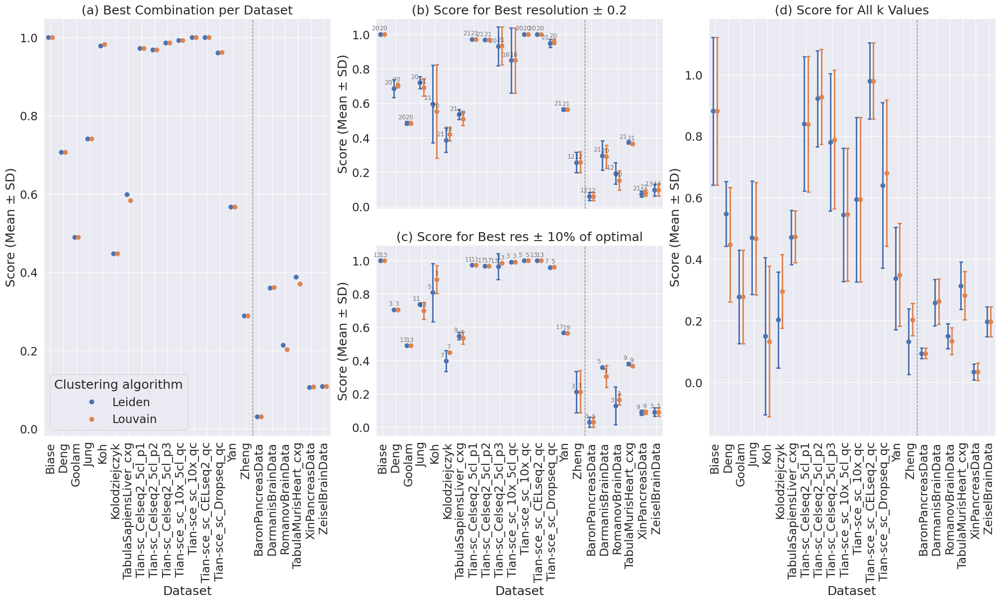

In [34]:
from matplotlib.gridspec import GridSpec
import matplotlib.pyplot as plt
import seaborn as sns
import math
from collections import defaultdict

# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10_res['PSI'].min(), 
               appended_data_avg_res['PSI'].min(), 
               appended_data_10_per_res['PSI'].min(),
               appended_data_avg_res['PSI'].min())
ylim_max = max(appended_data_10_res['PSI'].max(), 
               appended_data_avg_res['PSI'].max(), 
               appended_data_10_per_res['PSI'].max(),
               appended_data_avg_res['PSI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('Score (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best Combination per Dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('Score (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) Score for Best resolution ± 0.2')
add_divider(ax2)
ax2.grid(True)

dataset_count_abs = {ds: 0 for ds in sorted_datasets}  # Reset per plot
for idx, row in best_comb_shrink.iterrows():
    x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
    clustering_alg = row.Clustering_algorithm

    # Fetch corresponding dataset slice
    slice_dataset = appended_data_10_res.loc[
        (appended_data_10_res['Dataset'] == row.Dataset) & 
        (appended_data_10_res['Clustering_algorithm'] == row.Clustering_algorithm)
    ]

    value = len(slice_dataset)
    y_pos = slice_dataset.PSI.mean()+0.015

    # Introduce a slight shift to avoid overlap
    offset = (dataset_count_abs[row.Dataset] - 0.9) * 0.6  # Adjust shifting scale if needed
    x_pos_shifted = x_pos + offset
    dataset_count_abs[row.Dataset] += 1  # Increment occurrence for next duplicate

    ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
             s=f'{value}',  # Format the annotation text
             ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
#ax3 = fig.add_subplot(gs[0, 2])

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('Score (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(c) Score for Best res ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)
dataset_count = defaultdict(int)


dataset_count_per = {ds: 0 for ds in sorted_datasets}  # Reset per plot
for idx, row in best_comb_shrink.iterrows():
    x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
    clustering_alg = row.Clustering_algorithm

    # Fetch corresponding dataset slice
    slice_dataset = appended_data_10_per_res.loc[
        (appended_data_10_per_res['Dataset'] == row.Dataset) & 
        (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
    ]

    value = len(slice_dataset)
    y_pos = slice_dataset.PSI.mean()+0.015

    # Introduce a slight shift to avoid overlap
    offset = (dataset_count_per[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
    x_pos_shifted = x_pos + offset
    dataset_count_per[row.Dataset] += 1  # Increment occurrence for next duplicate

    ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
             s=f'{value}',  # Format the annotation text
             ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font


# Plot 5 - Bottom row, third column (Same as Plot 3)
#ax5 = fig.add_subplot(gs[1, 2])
ax3_combined = fig.add_subplot(gs[:, 2])
sns.pointplot(
    data=appended_data_avg_res, 
    x='Dataset', 
    y='PSI', 
    hue='Clustering_algorithm',
    ci='sd', 
    capsize=.2, 
    linestyle='', 
    dodge=0.3, 
    order=sorted_datasets, 
    ax=ax3_combined,
    legend=False
)
ax3_combined.set_xlabel('Dataset')
ax3_combined.set_ylabel('Score (Mean ± SD)')
ax3_combined.tick_params(axis='x', rotation=90)
ax3_combined.set_title('(d) Score for All k Values')
add_divider(ax3_combined)
ax3_combined.grid(True)




plt.show()


##### Absolute scenario

/tmp/ipykernel_23132/2685700391.py:35: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
/tmp/ipykernel_23132/2685700391.py:48: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2685700391.py:85: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2685700391.py:123: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(


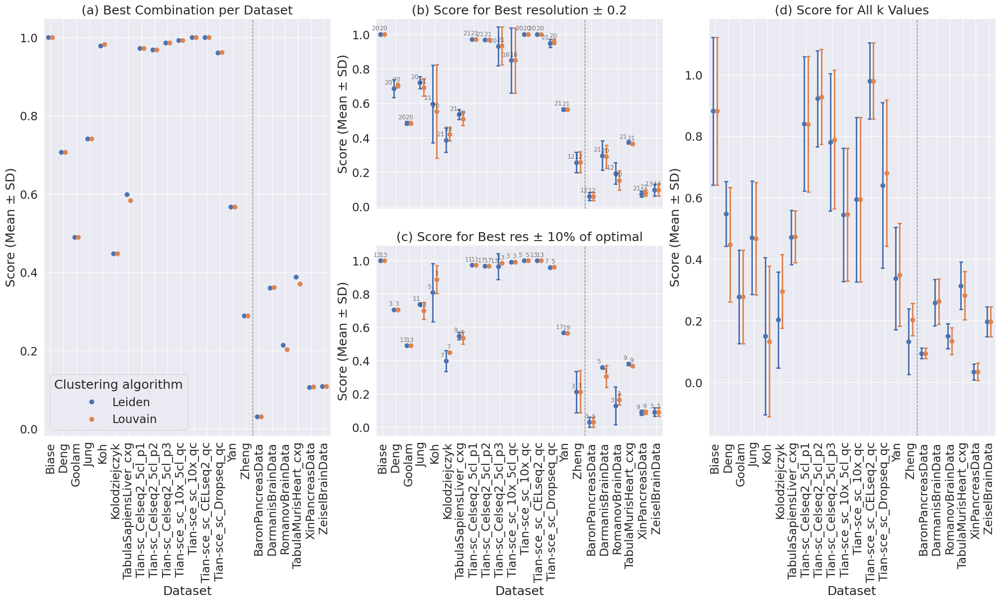

In [35]:
from matplotlib.gridspec import GridSpec
import matplotlib.pyplot as plt
import seaborn as sns
import math
from collections import defaultdict

# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10_res['PSI'].min(), 
               appended_data_avg_res['PSI'].min(), 
               appended_data_10_per_res['PSI'].min(),
               appended_data_avg_res['PSI'].min())
ylim_max = max(appended_data_10_res['PSI'].max(), 
               appended_data_avg_res['PSI'].max(), 
               appended_data_10_per_res['PSI'].max(),
               appended_data_avg_res['PSI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('Score (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best Combination per Dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('Score (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) Score for Best resolution ± 0.2')
add_divider(ax2)
ax2.grid(True)

dataset_count_abs = {ds: 0 for ds in sorted_datasets}  # Reset per plot
for idx, row in best_comb_shrink.iterrows():
    x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
    clustering_alg = row.Clustering_algorithm

    # Fetch corresponding dataset slice
    slice_dataset = appended_data_10_res.loc[
        (appended_data_10_res['Dataset'] == row.Dataset) & 
        (appended_data_10_res['Clustering_algorithm'] == row.Clustering_algorithm)
    ]

    value = len(slice_dataset)
    y_pos = slice_dataset.PSI.mean()+0.015

    # Introduce a slight shift to avoid overlap
    offset = (dataset_count_abs[row.Dataset] - 0.9) * 0.6  # Adjust shifting scale if needed
    x_pos_shifted = x_pos + offset
    dataset_count_abs[row.Dataset] += 1  # Increment occurrence for next duplicate

    ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
             s=f'{value}',  # Format the annotation text
             ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
#ax3 = fig.add_subplot(gs[0, 2])

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('Score (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(c) Score for Best res ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)
dataset_count = defaultdict(int)


dataset_count_per = {ds: 0 for ds in sorted_datasets}  # Reset per plot
for idx, row in best_comb_shrink.iterrows():
    x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
    clustering_alg = row.Clustering_algorithm

    # Fetch corresponding dataset slice
    slice_dataset = appended_data_10_per_res.loc[
        (appended_data_10_per_res['Dataset'] == row.Dataset) & 
        (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
    ]

    value = len(slice_dataset)
    y_pos = slice_dataset.PSI.mean()+0.015

    # Introduce a slight shift to avoid overlap
    offset = (dataset_count_per[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
    x_pos_shifted = x_pos + offset
    dataset_count_per[row.Dataset] += 1  # Increment occurrence for next duplicate

    ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
             s=f'{value}',  # Format the annotation text
             ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font


# Plot 5 - Bottom row, third column (Same as Plot 3)
#ax5 = fig.add_subplot(gs[1, 2])
ax3_combined = fig.add_subplot(gs[:, 2])
sns.pointplot(
    data=appended_data_avg_res, 
    x='Dataset', 
    y='PSI', 
    hue='Clustering_algorithm',
    ci='sd', 
    capsize=.2, 
    linestyle='', 
    dodge=0.3, 
    order=sorted_datasets, 
    ax=ax3_combined,
    legend=False
)
ax3_combined.set_xlabel('Dataset')
ax3_combined.set_ylabel('Score (Mean ± SD)')
ax3_combined.tick_params(axis='x', rotation=90)
ax3_combined.set_title('(d) Score for All k Values')
add_divider(ax3_combined)
ax3_combined.grid(True)




plt.show()


## Compare robustness of k and resolution 

### Percentage

#### ARI

/tmp/ipykernel_23132/2653767586.py:31: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='ARI', hue='Clustering_algorithm',
/tmp/ipykernel_23132/2653767586.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2653767586.py:78: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2653767586.py:89: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2653767586.py:124: FutureWarning: 

The `ci` pa

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_percentage/ARI_plot.png


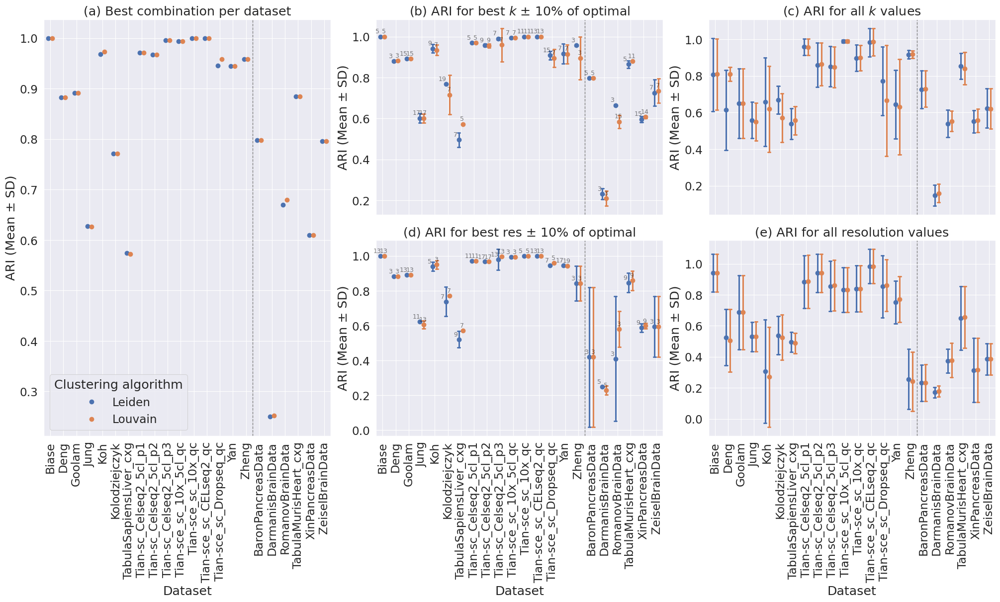

In [39]:
plot_text = True

# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10_per['ARI'].min(), 
               appended_data_avg_res['ARI'].min(), 
               appended_data_10_per_res['ARI'].min(),
               appended_data_avg['ARI'].min())
ylim_max = max(appended_data_10_per['ARI'].max(), 
               appended_data_avg['ARI'].max(), 
               appended_data_10_per_res['ARI'].max(),
               appended_data_avg['ARI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='ARI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('ARI (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10_per, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('ARI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) ARI for best $\mathit{k}$ ± 10% of optimal')
add_divider(ax2)
ax2.grid(True)

if plot_text: 
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per.loc[
            (appended_data_10_per['Dataset'] == row.Dataset) & 
            (appended_data_10_per['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.ARI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('ARI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) ARI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('ARI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) ARI for best res ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)

dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot

if plot_text:
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per_res.loc[
            (appended_data_10_per_res['Dataset'] == row.Dataset) & 
            (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.ARI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='ARI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('ARI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) ARI for all resolution values')
add_divider(ax5)
ax5.grid(True)
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_percentage/ARI_plot.png"
plt.savefig(filename, format='png', bbox_inches='tight')
print(f"Saved: {filename}")

plt.show()

#### PSI

/tmp/ipykernel_23132/2729829464.py:31: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
/tmp/ipykernel_23132/2729829464.py:44: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2729829464.py:78: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2729829464.py:89: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/2729829464.py:124: FutureWarning: 

The `ci` pa

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_percentage/PSI_plot_notext.eps


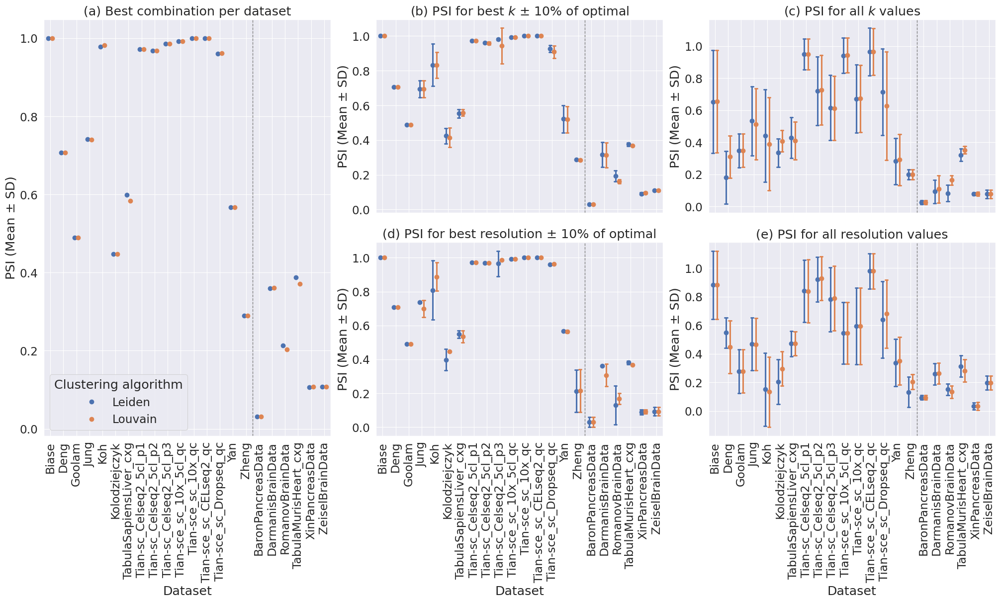

In [43]:
show_text = False

# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10_per['PSI'].min(), 
               appended_data_avg_res['PSI'].min(), 
               appended_data_10_per_res['PSI'].min(),
               appended_data_avg['PSI'].min())
ylim_max = max(appended_data_10_per['PSI'].max(), 
               appended_data_avg['PSI'].max(), 
               appended_data_10_per_res['PSI'].max(),
               appended_data_avg['PSI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('PSI (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10_per, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('PSI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) PSI for best $\mathit{k}$ ± 10% of optimal')
add_divider(ax2)
ax2.grid(True)

if show_text:
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per.loc[
            (appended_data_10_per['Dataset'] == row.Dataset) & 
            (appended_data_10_per['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.PSI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('PSI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) PSI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('PSI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) PSI for best resolution ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)


if show_text:
    dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per_res.loc[
            (appended_data_10_per_res['Dataset'] == row.Dataset) & 
            (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.PSI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('PSI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) PSI for all resolution values')
add_divider(ax5)
ax5.grid(True)

filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_percentage/PSI_plot_notext.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
print(f"Saved: {filename}")

plt.show()

#### NMI

/tmp/ipykernel_23132/3433632990.py:30: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='NMI', hue='Clustering_algorithm',
/tmp/ipykernel_23132/3433632990.py:43: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/3433632990.py:77: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/3433632990.py:88: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_23132/3433632990.py:122: FutureWarning: 

The `ci` pa

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_percentage/NMI_plot_notext.eps


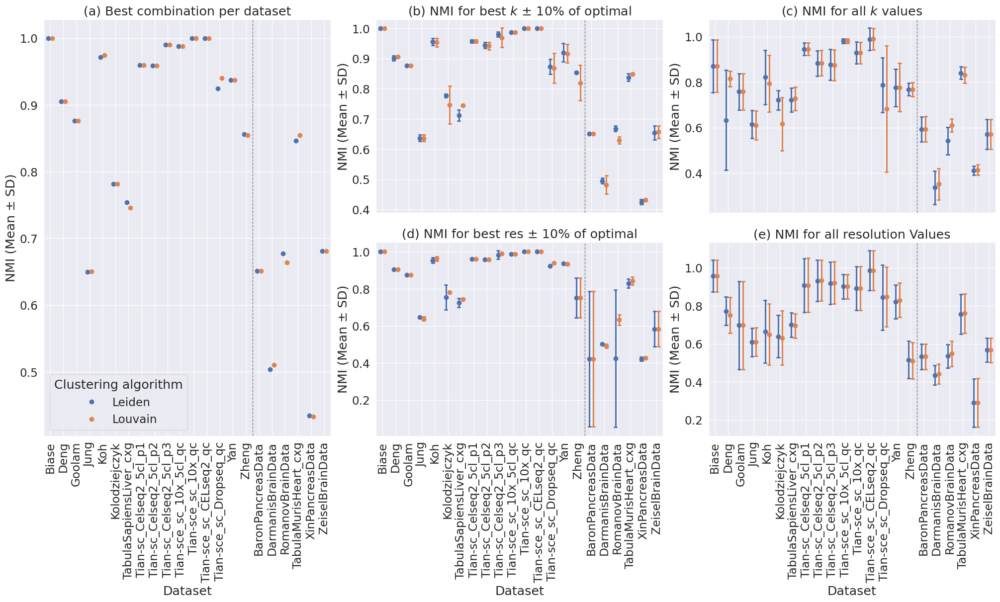

In [47]:
show_text =  False
# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10_per['NMI'].min(), 
               appended_data_avg_res['NMI'].min(), 
               appended_data_10_per_res['NMI'].min(),
               appended_data_avg['NMI'].min())
ylim_max = max(appended_data_10_per['NMI'].max(), 
               appended_data_avg['NMI'].max(), 
               appended_data_10_per_res['NMI'].max(),
               appended_data_avg['NMI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='NMI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('NMI (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10_per, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('NMI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) NMI for best $\mathit{k}$ ± 10% of optimal')
add_divider(ax2)
ax2.grid(True)

if show_text:
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per.loc[
            (appended_data_10_per['Dataset'] == row.Dataset) & 
            (appended_data_10_per['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.NMI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('NMI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) NMI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_per_res, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('NMI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) NMI for best res ± 10% of optimal')
add_divider(ax4)
ax4.grid(True)

if show_text:
    dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per_res.loc[
            (appended_data_10_per_res['Dataset'] == row.Dataset) & 
            (appended_data_10_per_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.NMI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='NMI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('NMI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) NMI for all resolution Values')
add_divider(ax5)
ax5.grid(True)

filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_percentage/NMI_plot_notext.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
print(f"Saved: {filename}")
plt.show()

### Absolute

#### PSI

/tmp/ipykernel_1598/1867267840.py:30: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
/tmp/ipykernel_1598/1867267840.py:43: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/1867267840.py:77: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/1867267840.py:88: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/1867267840.py:122: FutureWarning: 

The `ci` parameter is de

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_absolute/PSI_plot.png


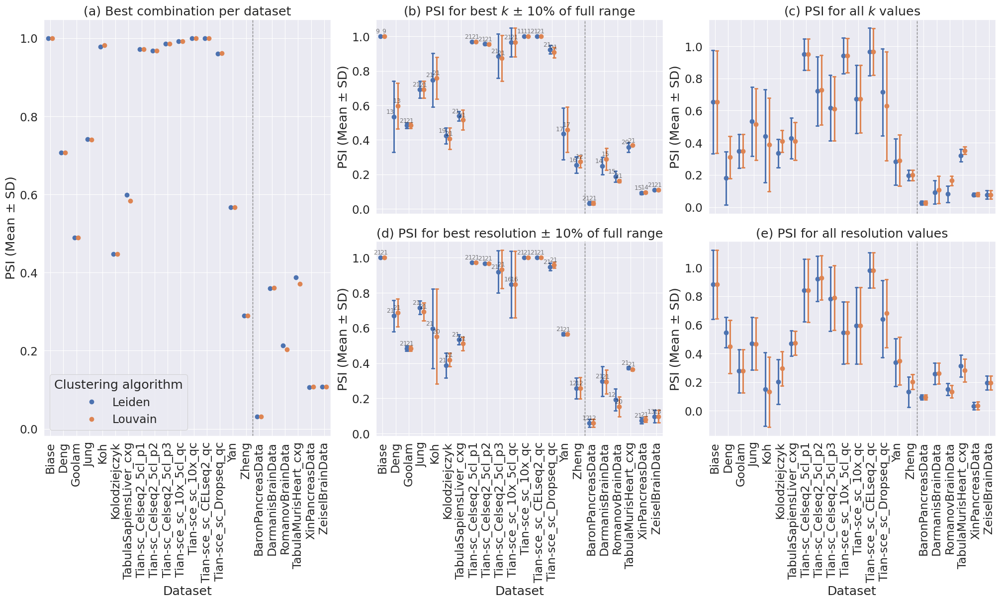

In [54]:
plot_text = True
# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10['PSI'].min(), 
               appended_data_avg_res['PSI'].min(), 
               appended_data_10_res['PSI'].min(),
               appended_data_avg['PSI'].min())
ylim_max = max(appended_data_10['PSI'].max(), 
               appended_data_avg['PSI'].max(), 
               appended_data_10_res['PSI'].max(),
               appended_data_avg['PSI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('PSI (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('PSI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) PSI for best $\mathit{k}$ ± 10% of full range')
add_divider(ax2)
ax2.grid(True)

if plot_text:
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10.loc[
            (appended_data_10['Dataset'] == row.Dataset) & 
            (appended_data_10['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.PSI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('PSI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) PSI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_res, x='Dataset', y='PSI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('PSI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) PSI for best resolution ± 10% of full range')
add_divider(ax4)
ax4.grid(True)

if plot_text: 
    dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_res.loc[
            (appended_data_10_res['Dataset'] == row.Dataset) & 
            (appended_data_10_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.PSI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='PSI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('PSI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) PSI for all resolution values')
add_divider(ax5)
ax5.grid(True)
# Save to file
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_absolute/PSI_plot.png"
plt.savefig(filename, format='png', bbox_inches='tight')
print(f"Saved: {filename}")

plt.show()

#### NMI

/tmp/ipykernel_1598/372918015.py:30: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='NMI', hue='Clustering_algorithm',
/tmp/ipykernel_1598/372918015.py:43: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/372918015.py:77: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/372918015.py:88: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_res, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/372918015.py:124: FutureWarning: 

The `ci` parameter is depreca

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_absolute/NMI_plot.png


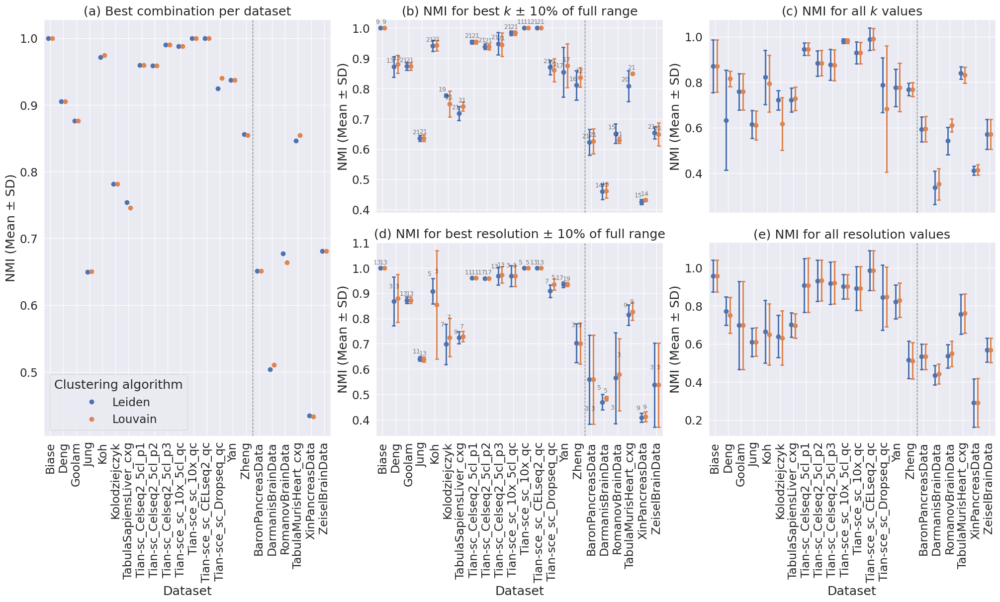

In [58]:
plot_text = True
# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10['NMI'].min(), 
               appended_data_avg_res['NMI'].min(), 
               appended_data_10_res['NMI'].min(),
               appended_data_avg['NMI'].min())
ylim_max = max(appended_data_10['NMI'].max(), 
               appended_data_avg['NMI'].max(), 
               appended_data_10_res['NMI'].max(),
               appended_data_avg['NMI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='NMI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('NMI (Mean ± SD)')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('NMI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) NMI for best $\mathit{k}$ ± 10% of full range')
add_divider(ax2)
ax2.grid(True)

if plot_text:
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10.loc[
            (appended_data_10['Dataset'] == row.Dataset) & 
            (appended_data_10['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.NMI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('NMI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) NMI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_res, x='Dataset', y='NMI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('NMI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) NMI for best resolution ± 10% of full range')
add_divider(ax4)
ax4.grid(True)



if plot_text:
    dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per_res.loc[
            (appended_data_10_res['Dataset'] == row.Dataset) & 
            (appended_data_10_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.NMI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='NMI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('NMI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) NMI for all resolution values')
add_divider(ax5)
ax5.grid(True)
# Save to file
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_absolute/NMI_plot.png"
plt.savefig(filename, format='png', bbox_inches='tight')
print(f"Saved: {filename}")


plt.show()

#### ARI

/tmp/ipykernel_1598/3411786445.py:30: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=best_comb, x='Dataset', y='ARI', hue='Clustering_algorithm',
/tmp/ipykernel_1598/3411786445.py:43: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/3411786445.py:77: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_avg, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/3411786445.py:88: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=appended_data_10_res, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
/tmp/ipykernel_1598/3411786445.py:123: FutureWarning: 

The `ci` parameter is de

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_absolute/ARI_plot_notext.eps


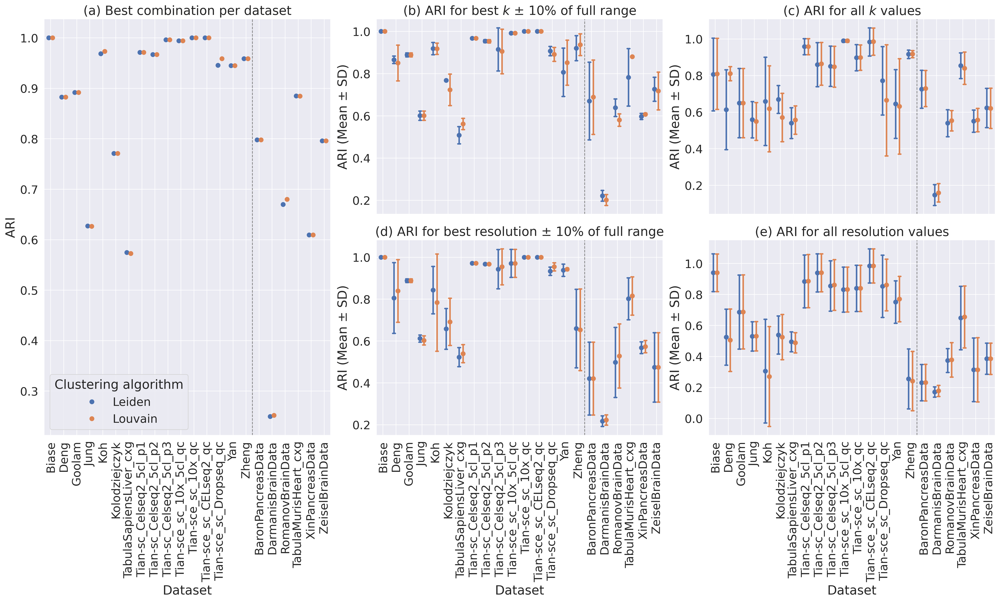

In [91]:
plot_text= False
# Set the figure size and context
sns.set_theme(rc={'figure.figsize': (20, 12)})
sns.set_context("paper", font_scale=1.9)

# Create a new figure with a GridSpec layout
fig = plt.figure(constrained_layout=True, figsize=(20, 12))
gs = GridSpec(2, 3, figure=fig)

# Define sorted datasets
sorted_datasets = sorted(best_comb['Dataset'].unique(), key=lambda x: (best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0], x))

# Define common y-axis limits
ylim_min = min(appended_data_10['ARI'].min(), 
               appended_data_avg_res['ARI'].min(), 
               appended_data_10_res['ARI'].min(),
               appended_data_avg['ARI'].min())
ylim_max = max(appended_data_10['ARI'].max(), 
               appended_data_avg['ARI'].max(), 
               appended_data_10_res['ARI'].max(),
               appended_data_avg['ARI'].max())

# Function to add a vertical divider
def add_divider(ax):
    divider_index = list(sorted_datasets).index(next(x for x in sorted_datasets if best_comb.loc[best_comb['Dataset'] == x, 'Standard'].iloc[0] == 'silver'))
    ax.axvline(x=divider_index - 0.5, color='gray', linestyle='--', linewidth=1)

# Plot 1 - Takes up two rows in the first column
ax1 = fig.add_subplot(gs[:, 0])
sns.pointplot(data=best_comb, x='Dataset', y='ARI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax1)
ax1.set_xlabel('Dataset')
ax1.set_ylabel('ARI')
ax1.tick_params(axis='x', rotation=90)
ax1.legend(title='Clustering algorithm', loc='best')  # Legend only on Plot 1
ax1.set_title('(a) Best combination per dataset')
#ax1.invert_yaxis()
add_divider(ax1)
ax1.grid(True)

# Plot 2 - Top row, second column
ax2 = fig.add_subplot(gs[0, 1])
sns.pointplot(data=appended_data_10, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax2)
ax2.set_xlabel('')
ax2.set_ylabel('ARI (Mean ± SD)')
ax2.set_xticklabels([])
ax2.set_title('(b) ARI for best $\mathit{k}$ ± 10% of full range')
add_divider(ax2)
ax2.grid(True)

if plot_text:
    dataset_count_k = {ds: 0 for ds in sorted_datasets}  # Reset per plot
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10.loc[
            (appended_data_10['Dataset'] == row.Dataset) & 
            (appended_data_10['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.ARI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_k[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_k[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax2.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 3 - Top row, third column
ax3 = fig.add_subplot(gs[0, 2])
sns.pointplot(data=appended_data_avg, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax3)
ax3.set_xlabel('')
ax3.set_ylabel('ARI (Mean ± SD)')
ax3.set_xticklabels([])
ax3.set_title('(c) ARI for all $\mathit{k}$ values')
add_divider(ax3)
ax3.grid(True)

# Plot 4 - Bottom row, second column
ax4 = fig.add_subplot(gs[1, 1])
sns.pointplot(data=appended_data_10_res, x='Dataset', y='ARI', hue='Clustering_algorithm', legend=False,
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax4)
ax4.set_xlabel('Dataset')
ax4.set_ylabel('ARI (Mean ± SD)')
ax4.tick_params(axis='x', rotation=90)
ax4.set_title('(d) ARI for best resolution ± 10% of full range')
add_divider(ax4)
ax4.grid(True)

dataset_count_res = {ds: 0 for ds in sorted_datasets}  # Reset per plot

if plot_text:
    for idx, row in best_comb_shrink.iterrows():
        x_pos = list(sorted_datasets).index(row.Dataset)  # Base x position
        clustering_alg = row.Clustering_algorithm

        # Fetch corresponding dataset slice
        slice_dataset = appended_data_10_per_res.loc[
            (appended_data_10_res['Dataset'] == row.Dataset) & 
            (appended_data_10_res['Clustering_algorithm'] == row.Clustering_algorithm)
        ]

        value = len(slice_dataset)
        y_pos = slice_dataset.ARI.mean()+0.01
        # Introduce a slight shift to avoid overlap
        offset = (dataset_count_res[row.Dataset] - 0.8) * 0.5  # Adjust shifting scale if needed
        x_pos_shifted = x_pos + offset
        dataset_count_res[row.Dataset] += 1  # Increment occurrence for next duplicate

        ax4.text(x=x_pos_shifted, y=y_pos,  # Adjusted x-position
                s=f'{value}',  # Format the annotation text
                ha='center', va='bottom', fontsize=9, color='black',alpha=0.5)  # Customize font

# Plot 5 - Bottom row, third column (Same as Plot 3)
ax5 = fig.add_subplot(gs[1, 2])
sns.pointplot(data=appended_data_avg_res, x='Dataset', y='ARI', hue='Clustering_algorithm',
              ci='sd', capsize=.2, linestyle='', dodge=0.3, order=sorted_datasets, ax=ax5, legend=False)
ax5.set_xlabel('Dataset')
ax5.set_ylabel('ARI (Mean ± SD)')
ax5.tick_params(axis='x', rotation=90)
ax5.set_title('(e) ARI for all resolution values')
add_divider(ax5)
ax5.grid(True)

# Save to file
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_absolute/ARI_plot_notext.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
print(f"Saved: {filename}")
plt.show()

## Robustness of graph types - $k$

Check the distribution of PSI  for different graph types

In [60]:
matches_graph_type= []
for idx, row in best_comb_shrink.sort_values(by=['Standard','Dataset']).iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset', 'Quality_Function', 'Similarity_Measure','Resolution', 'Clustering_algorithm'])
    matches['standard'] = row.Standard  
    best_k = row.K_Neighbors
    #matches = matches.sort_values(by="K_Neighbors")
    matches_graph_type.append(matches)

/tmp/ipykernel_23132/123087130.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches['standard'] = row.Standard
/tmp/ipykernel_23132/123087130.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  matches['standard'] = row.Standard
/tmp/ipykernel_23132/123087130.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

### Leiden

#### Main manuscript datasets

In [61]:
gold = ['Biase', 'Yan', 'Deng','Goolam' ,'Koh', 'Tian-sc_Celseq2_5cl_p3', 'Tian-sce_sc_10x_5cl_qc', 'TabulaSapiensLiver_cxg', 'Zheng']
silver = list(np.unique(best_comb_shrink.loc[best_comb_shrink['Standard']=='silver'].Dataset))

In [62]:
leiden_gold = []
for dataset in matches_graph_type:
    if (dataset.Clustering_algorithm =='Leiden').all() and (dataset.Dataset.iloc[0] in gold or dataset.Dataset.iloc[0] in silver):
        leiden_gold.append(dataset.loc[dataset['Clustering_algorithm']=='Leiden'])

        Dataset Clustering_algorithm Similarity_Measure  K_Neighbors  \
2067023   Biase               Leiden                Phi           33   
2067326   Biase               Leiden                Phi           32   
2067629   Biase               Leiden                Phi           30   
2067932   Biase               Leiden                Phi           36   
2068235   Biase               Leiden                Phi           41   
...         ...                  ...                ...          ...   
2326088   Biase               Leiden                Phi           29   
2326391   Biase               Leiden                Phi           42   
2326694   Biase               Leiden                Phi           12   
2326997   Biase               Leiden                Phi            9   
2327300   Biase               Leiden                Phi           34   

            Quality_Function      Graph_type  Resolution       ARI       PSI  \
2067023  RBERVertexPartition  Jaccard_seurat       1.16

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_main.eps


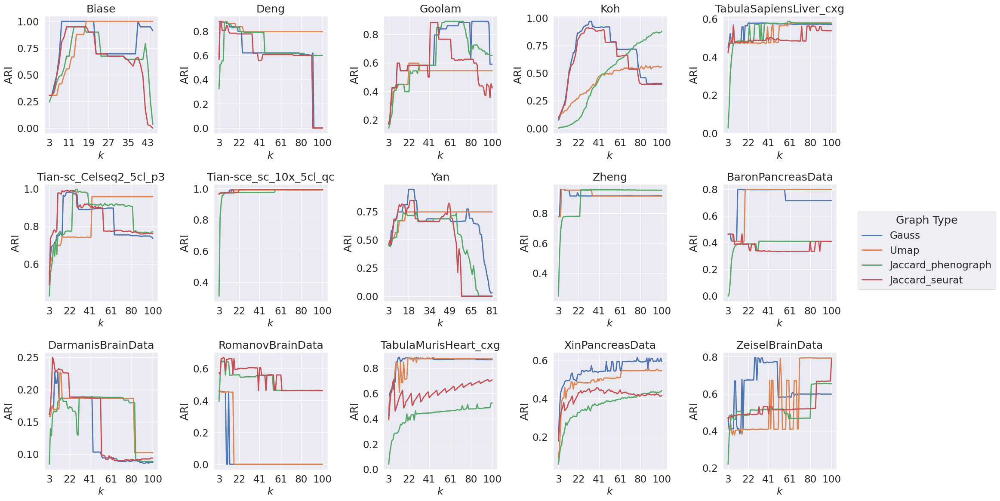

In [66]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(12.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 15
num_rows = 3
num_cols = 5

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_k = leiden_gold[index]
    print(match_k)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Gauss'], ax=axs[index],label='Gauss',linewidth= 2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Umap'], ax=axs[index], label='Umap',linewidth= 2 ,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_phenograph'], ax=axs[index], label='Jaccard_phenograph',linewidth =2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_seurat'], ax=axs[index], label='Jaccard_seurat',linewidth =2,legend=False)

    
    if (match_k.Dataset == 'Biase').all():
        tick_values = np.linspace(3, 43, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)

    elif (match_k.Dataset == 'Yan').all():
        tick_values = np.linspace(3, 81, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    else:

        tick_values = np.linspace(3, 100, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_k.Dataset.iloc[index])
    axs[index].set_xlabel('$k$', fontsize=17)
    axs[index].set_ylabel('ARI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Graph Type")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_main.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
print(f"Saved: {filename}")
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

#### Supplementary material datasets

In [64]:
leiden_not = []
for dataset in matches_graph_type:
    if (dataset.Clustering_algorithm =='Leiden').all() and (dataset.Dataset.iloc[0] not in gold and dataset.Dataset.iloc[0] not in silver):
        leiden_not.append(dataset.loc[dataset['Clustering_algorithm']=='Leiden'])

        Dataset Clustering_algorithm Similarity_Measure  K_Neighbors  \
5837042    Jung               Leiden                Phi           22   
5837345    Jung               Leiden                Phi           32   
5837648    Jung               Leiden                Phi           30   
5837951    Jung               Leiden                Phi           18   
5838254    Jung               Leiden                Phi           98   
...         ...                  ...                ...          ...   
6518489    Jung               Leiden                Phi           31   
6518792    Jung               Leiden                Phi           53   
6519095    Jung               Leiden                Phi           25   
6519398    Jung               Leiden                Phi            9   
6519701    Jung               Leiden                Phi           19   

                       Quality_Function          Graph_type  Resolution  \
5837042  RBConfigurationVertexPartition               Gauss 

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_supp.eps


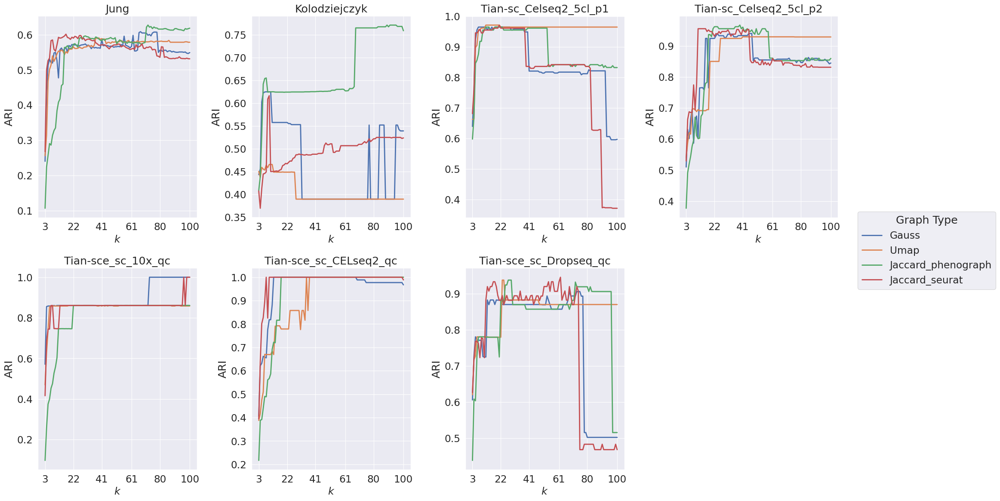

In [67]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(12.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 7
num_rows = 2
num_cols = 4

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_k = leiden_not[index]
    print(match_k)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Gauss'], ax=axs[index],label='Gauss',linewidth= 2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Umap'], ax=axs[index], label='Umap',linewidth= 2 ,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_phenograph'], ax=axs[index], label='Jaccard_phenograph',linewidth =2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_seurat'], ax=axs[index], label='Jaccard_seurat',linewidth =2,legend=False)

    
    if (match_k.Dataset == 'Biase').all():
        tick_values = np.linspace(3, 43, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    else:

        tick_values = np.linspace(3, 100, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_k.Dataset.iloc[index])
    axs[index].set_xlabel('$k$', fontsize=17)
    axs[index].set_ylabel('ARI')
for j in range(num_plots, num_rows * num_cols):
    fig.delaxes(axs[j])  # This will remove the empty plot area
# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Graph Type")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_supp.eps"
plt.savefig(filename, format = 'eps', bbox_inches='tight')
print(f"Saved: {filename}")
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

### Louvain

#### Main manuscript datasets

In [72]:
louvain_gold = []
for dataset in matches_graph_type:
    if (dataset.Clustering_algorithm =='Louvain').all() and (dataset.Dataset.iloc[0] in gold or dataset.Dataset.iloc[0] in silver):
        louvain_gold.append(dataset.loc[dataset['Clustering_algorithm']=='Louvain'])

In [ ]:
louvain_gold

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_main_louv.eps


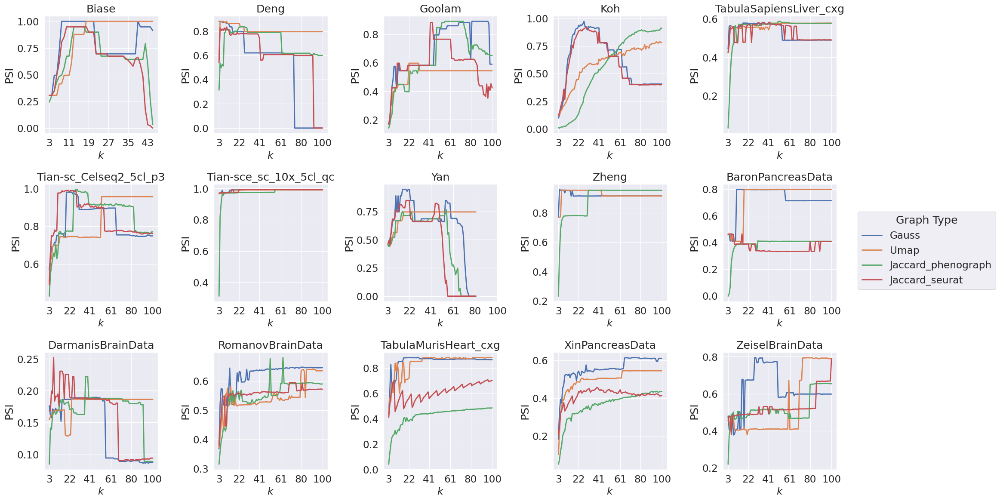

In [74]:
# Assuming you have a total of 15 plots to create
num_plots = 15
num_rows = 3
num_cols = 5

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_k = louvain_gold[index]
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Gauss'], ax=axs[index],label='Gauss',linewidth= 2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Umap'], ax=axs[index], label='Umap',linewidth= 2 ,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_phenograph'], ax=axs[index], label='Jaccard_phenograph',linewidth =2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_seurat'], ax=axs[index], label='Jaccard_seurat',linewidth =2,legend=False)

    
    if (match_k.Dataset == 'Biase').all():
        tick_values = np.linspace(3, 43, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    else:

        tick_values = np.linspace(3, 100, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_k.Dataset.iloc[index])
    axs[index].set_xlabel('$k$', fontsize=17)
    axs[index].set_ylabel('PSI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Graph Type")
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_main_louv.eps"
plt.savefig(filename, format='eps', bbox_inches='tight')
print(f"Saved: {filename}")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

#### Supplementary material datasets

In [75]:
louvain_not = []
for dataset in matches_graph_type:
    if (dataset.Clustering_algorithm =='Louvain').all() and (dataset.Dataset.iloc[0] not in gold and dataset.Dataset.iloc[0] not in silver):
        louvain_not.append(dataset.loc[dataset['Clustering_algorithm']=='Louvain'])

        Dataset Clustering_algorithm Similarity_Measure  K_Neighbors  \
6638784    Jung              Louvain                Phi           41   
6639087    Jung              Louvain                Phi           76   
6639390    Jung              Louvain                Phi           71   
6639693    Jung              Louvain                Phi           23   
6639996    Jung              Louvain                Phi           62   
...         ...                  ...                ...          ...   
7379619    Jung              Louvain                Phi           59   
7379922    Jung              Louvain                Phi            4   
7380225    Jung              Louvain                Phi           71   
7380528    Jung              Louvain                Phi           32   
7380831    Jung              Louvain                Phi           94   

                       Quality_Function Graph_type  Resolution       ARI  \
6638784  RBConfigurationVertexPartition      Gauss       1.

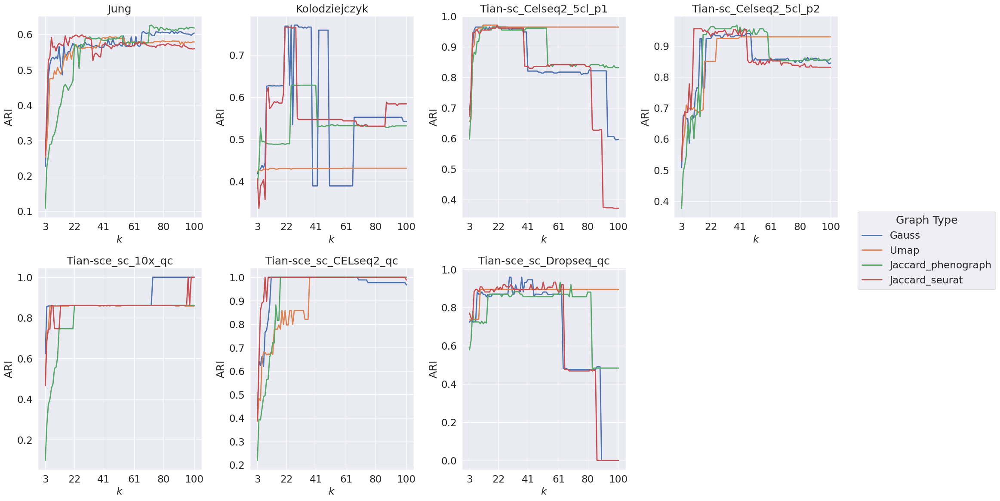

In [77]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(12.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 7
num_rows = 2
num_cols = 4

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_k = louvain_not[index]
    print(match_k)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Gauss'], ax=axs[index],label='Gauss',linewidth= 2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Umap'], ax=axs[index], label='Umap',linewidth= 2 ,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_phenograph'], ax=axs[index], label='Jaccard_phenograph',linewidth =2,legend=False)
    sns.lineplot(x="K_Neighbors", y="ARI", data=match_k.loc[match_k['Graph_type']=='Jaccard_seurat'], ax=axs[index], label='Jaccard_seurat',linewidth =2,legend=False)

    
    if (match_k.Dataset == 'Biase').all():
        tick_values = np.linspace(3, 43, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    else:

        tick_values = np.linspace(3, 100, num=6, dtype=int)
        axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
        axs[index].set_xticks(tick_values)
    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_k.Dataset.iloc[index])
    axs[index].set_xlabel('$k$', fontsize=17)
    axs[index].set_ylabel('ARI')
for j in range(num_plots, num_rows * num_cols):
    fig.delaxes(axs[j])  # This will remove the empty plot area
# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Graph Type")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_graph_type/ARI_plot_supp_louv.png"
plt.savefig(filename, format='png', bbox_inches='tight')
print(f"Saved: {filename}")
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

## Robustness of quality functions - resolution

In [78]:
matches_quality_fun= []
for idx, row in best_comb_shrink.sort_values(by=['Standard','Dataset']).iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset', 'Similarity_Measure','K_Neighbors','Graph_type', 'Clustering_algorithm']).copy()
    matches['standard'] = row.Standard    
    matches_quality_fun.append(matches)

In [79]:
gold = ['Biase', 'Yan', 'Deng','Goolam' ,'Koh', 'Tian-sc_Celseq2_5cl_p3', 'Tian-sce_sc_10x_5cl_qc', 'TabulaSapiensLiver_cxg', 'Zheng']
silver = list(np.unique(best_comb_shrink.loc[best_comb_shrink['Standard']=='silver'].Dataset))

### Leiden

#### Main manuscript datasets

In [80]:
leiden_main_qf = []
for dataset in matches_quality_fun:
    if (dataset.Clustering_algorithm =='Leiden').all() and (dataset.Dataset.iloc[0] in gold or dataset.Dataset.iloc[0] in silver):
        leiden_main_qf.append(dataset)

In [33]:
leiden_main_qf

[        Dataset Clustering_algorithm Similarity_Measure  K_Neighbors  \
 2317647   Biase               Leiden                Phi           14   
 2317648   Biase               Leiden                Phi           14   
 2317649   Biase               Leiden                Phi           14   
 2317650   Biase               Leiden                Phi           14   
 2317651   Biase               Leiden                Phi           14   
 ...         ...                  ...                ...          ...   
 2317945   Biase               Leiden                Phi           14   
 2317946   Biase               Leiden                Phi           14   
 2317947   Biase               Leiden                Phi           14   
 2317948   Biase               Leiden                Phi           14   
 2317949   Biase               Leiden                Phi           14   
 
                        Quality_Function Graph_type  Resolution       ARI  \
 2317647  RBConfigurationVertexPartition     

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_main.eps


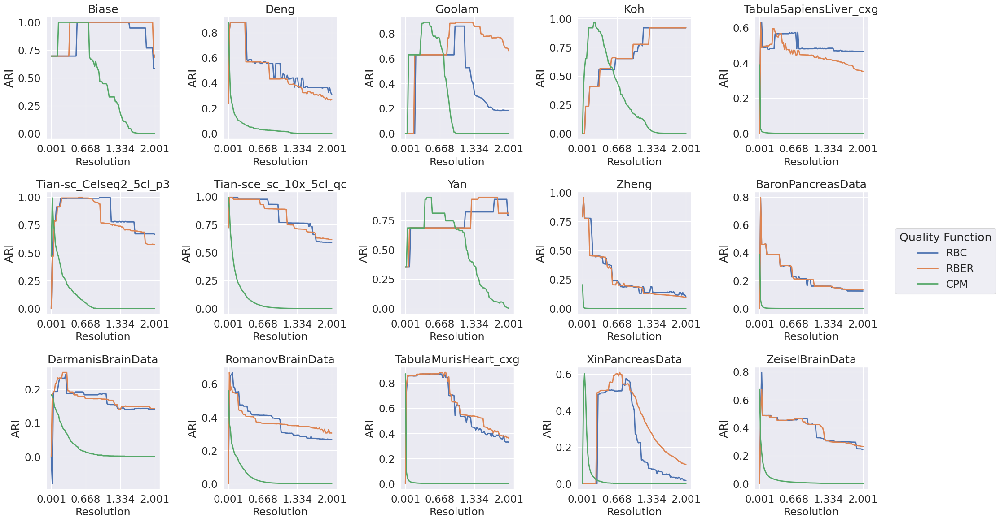

In [84]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(10.7,6.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 15
num_rows = 3
num_cols = 5

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_res = leiden_main_qf[index]
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBConfigurationVertexPartition'], ax=axs[index],label='RBC',legend=False,linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBERVertexPartition'], ax=axs[index], label='RBER', legend=False, linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='CPMVertexPartition'], ax=axs[index], label='CPM', legend=False, linewidth=2)
    tick_values = np.linspace(0.001, 2.001, num=4, dtype=float)
    axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
    axs[index].set_xticks(tick_values)

    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_res.Dataset.iloc[index])
    axs[index].set_xlabel('Resolution', fontsize=17)
    axs[index].set_ylabel('ARI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Quality Function")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_main.eps"
plt.savefig(filename, format = 'eps', bbox_inches='tight')
print(f"Saved: {filename}")
# Display the plot
#plt.show()

#### Supplementary material

In [85]:
leiden_supp_qf = []
for dataset in matches_quality_fun:
    if (dataset.Clustering_algorithm =='Leiden').all() and (dataset.Dataset.iloc[0] not in gold and dataset.Dataset.iloc[0] not in silver):
        leiden_supp_qf.append(dataset.loc[dataset['Clustering_algorithm']=='Leiden'])

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


Saved: /work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_supp.eps


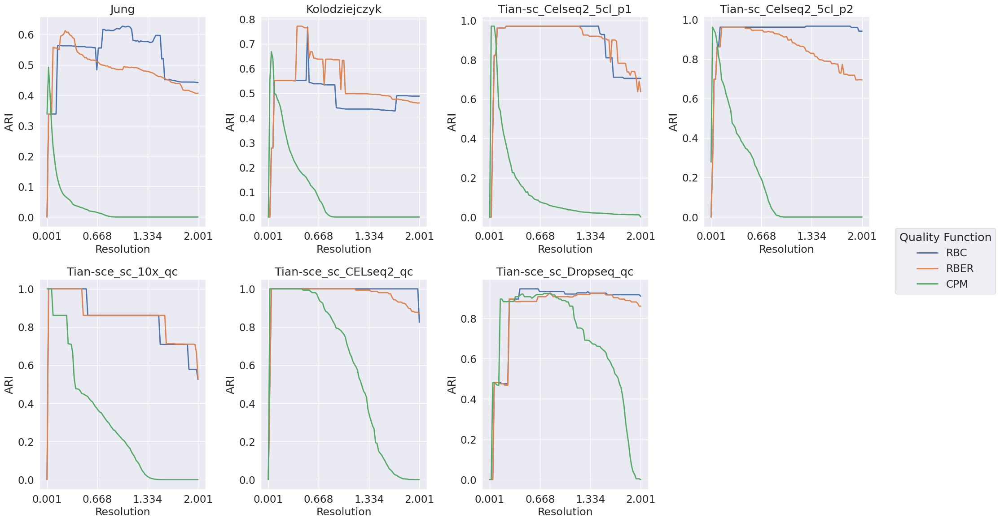

In [87]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(12.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 7
num_rows = 2
num_cols = 4

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))
plt.subplots_adjust(hspace=0.4)
# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_res = leiden_supp_qf[index]
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBConfigurationVertexPartition'], ax=axs[index],label='RBC',legend=False,linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBERVertexPartition'], ax=axs[index], label='RBER', legend=False, linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='CPMVertexPartition'], ax=axs[index], label='CPM', legend=False, linewidth=2)
    tick_values = np.linspace(0.001, 2.001, num=4, dtype=float)
    axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
    axs[index].set_xticks(tick_values)

    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_res.Dataset.iloc[index])
    axs[index].set_xlabel('Resolution', fontsize=17)
    axs[index].set_ylabel('ARI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
for j in range(num_plots, num_rows * num_cols):
    fig.delaxes(axs[j])  # This will remove the empty plot area
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Quality Function")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_supp.eps"
plt.savefig(filename, format = 'eps', bbox_inches='tight')
print(f"Saved: {filename}")
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

### Louvain

#### Main manuscript datasets

In [88]:
louvain_main_qf = []
for dataset in matches_quality_fun:
    if (dataset.Clustering_algorithm =='Louvain').all() and (dataset.Dataset.iloc[0] in gold or dataset.Dataset.iloc[0] in silver):
        louvain_main_qf.append(dataset)

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_main_louv.png


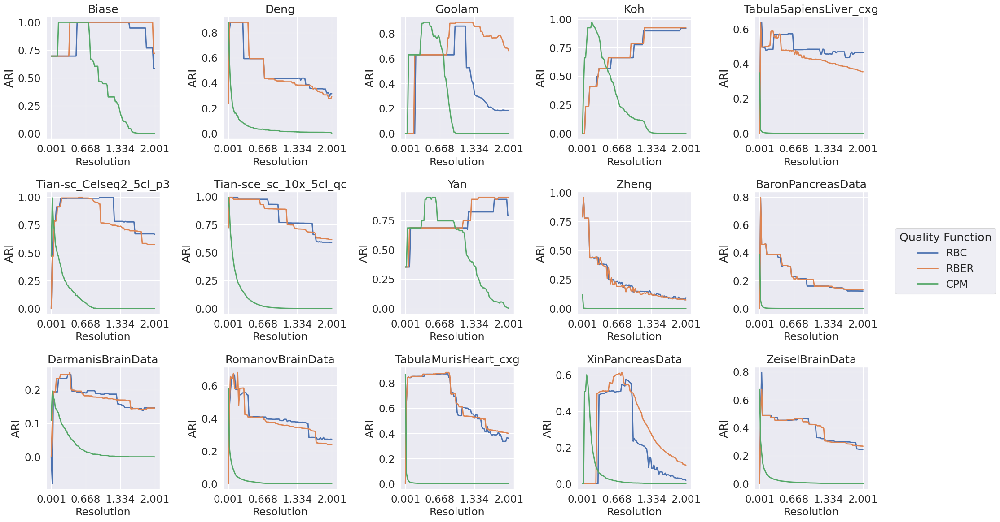

In [90]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(10.7,6.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 15
num_rows = 3
num_cols = 5

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))

# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_res = louvain_main_qf[index]
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBConfigurationVertexPartition'], ax=axs[index],label='RBC',legend=False,linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBERVertexPartition'], ax=axs[index], label='RBER', legend=False, linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='CPMVertexPartition'], ax=axs[index], label='CPM', legend=False, linewidth=2)
    tick_values = np.linspace(0.001, 2.001, num=4, dtype=float)
    axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
    axs[index].set_xticks(tick_values)

    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_res.Dataset.iloc[index])
    axs[index].set_xlabel('Resolution', fontsize=17)
    axs[index].set_ylabel('ARI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()

fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Quality Function")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_main_louv.png"
plt.savefig(filename, format = 'png', bbox_inches='tight')
print(f"Saved: {filename}")
# Display the plot
#plt.show()

#### Supplementary material

In [91]:
louvain_supp_qf = []
for dataset in matches_quality_fun:
    if (dataset.Clustering_algorithm =='Louvain').all() and (dataset.Dataset.iloc[0] not in gold and dataset.Dataset.iloc[0] not in silver):
        louvain_supp_qf.append(dataset.loc[dataset['Clustering_algorithm']=='Louvain'])

Saved: /work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_supp_louv.png


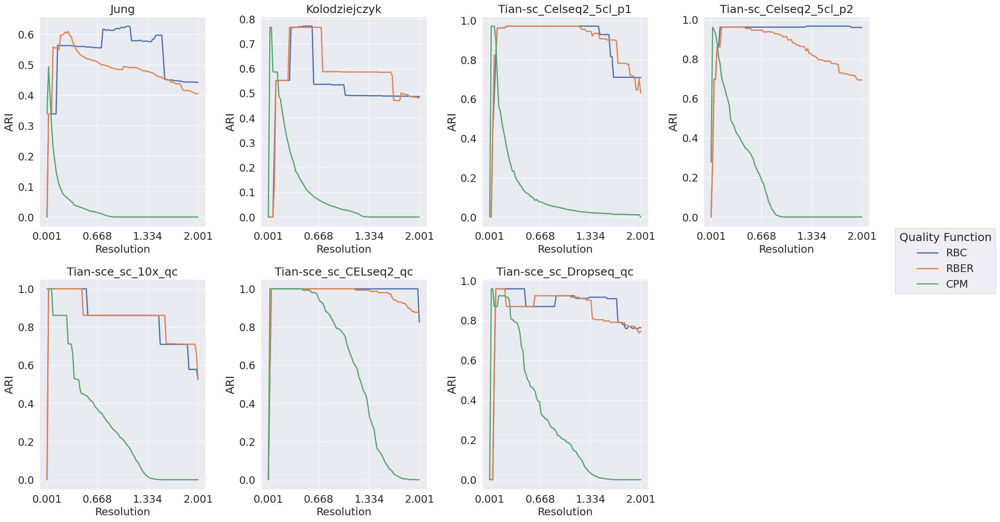

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.ticker import MaxNLocator
from matplotlib.ticker import FixedLocator
from matplotlib.ticker import (MultipleLocator, AutoMinorLocator)

#Identify the best combination for each dataset for louvain algorithm, and match the same hyper-parameters with leidenb 

sns.set_theme(rc={'figure.figsize':(12.7,8.27)})
sns.set_context("paper", font_scale=1.9)

# Assuming you have a total of 15 plots to create
num_plots = 7
num_rows = 2
num_cols = 4

# Create a figure and axes for subplots
fig, axs = plt.subplots(num_rows, num_cols, figsize=(20, 12))
plt.subplots_adjust(hspace=0.4)
# Flatten the axs array to easily access each subplot
axs = axs.flatten()


# Loop through different indices to generate matches and create plots
for index in range(num_plots):
    # Generate matches based on the current index
    # Create a line plot using Seaborn relplot
    match_res = louvain_supp_qf[index]
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBConfigurationVertexPartition'], ax=axs[index],label='RBC',legend=False,linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='RBERVertexPartition'], ax=axs[index], label='RBER', legend=False, linewidth=2)
    sns.lineplot(x="Resolution", y="ARI", data=match_res.loc[match_res['Quality_Function']=='CPMVertexPartition'], ax=axs[index], label='CPM', legend=False, linewidth=2)
    tick_values = np.linspace(0.001, 2.001, num=4, dtype=float)
    axs[index].xaxis.set_major_locator(FixedLocator(tick_values))
    axs[index].set_xticks(tick_values)

    # axs[index].xaxis.set_major_locator(MultipleLocator())
    # for i,label in enumerate(axs[index].get_xticklabels()):
    #         #print(i)
    #     if i == 0:
    #             #print('here')
    #         label.set_visible(False)

    

    # Set the title for the current subplot based on the current index
    axs[index].set_title(match_res.Dataset.iloc[index])
    axs[index].set_xlabel('Resolution', fontsize=17)
    axs[index].set_ylabel('ARI')

# Create a single legend for all subplots
handles, labels = axs[0].get_legend_handles_labels()
for j in range(num_plots, num_rows * num_cols):
    fig.delaxes(axs[j])  # This will remove the empty plot area
fig.legend(handles, labels, loc='center left', bbox_to_anchor=(1, 0.5), title="Quality Function")
# Adjust layout to prevent overlap of titles
plt.tight_layout()
filename = f"/work/Master_Project/Notebooks/plots_paper/robustness_quality_fun/ARI_plot_supp_louv.png"
plt.savefig(filename, format = 'png', bbox_inches='tight')
print(f"Saved: {filename}")
#plt.savefig('/work/Master_Project/output/robust_k_graph_type.png', bbox_inches='tight')
# Display the plot
#plt.show()

## Performance analysis of hyper-parameters

##### To have consistent plots

In [63]:
custom_order = ['Phi', 'Rho', 'Bray-Curtis','Cosine', 'Pearson', 'Spearman','Euclidean']

# Convert 'Value' column to categorical with custom order
all_results['Similarity_Measure'] = pd.Categorical(all_results['Similarity_Measure'], categories=custom_order, ordered=True)

# Sort DataFrame by the 'Value' column using the custom order
all_results = all_results.sort_values(by='Similarity_Measure')


### Peformance under optimal conditions (best k and best resolution)

Performance under optimal condition per combination

In [95]:
matches_best_k_res= []
for idx, row in best_comb_shrink.sort_values(by=['Standard','Dataset']).iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','K_Neighbors', 'Clustering_algorithm','Resolution']).copy()
    matches['standard'] = row.Standard    
    matches_best_k_res.append(matches)

In [96]:
df_matches_best_k_res = pd.concat(matches_best_k_res)

/tmp/ipykernel_23132/3080584685.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient p

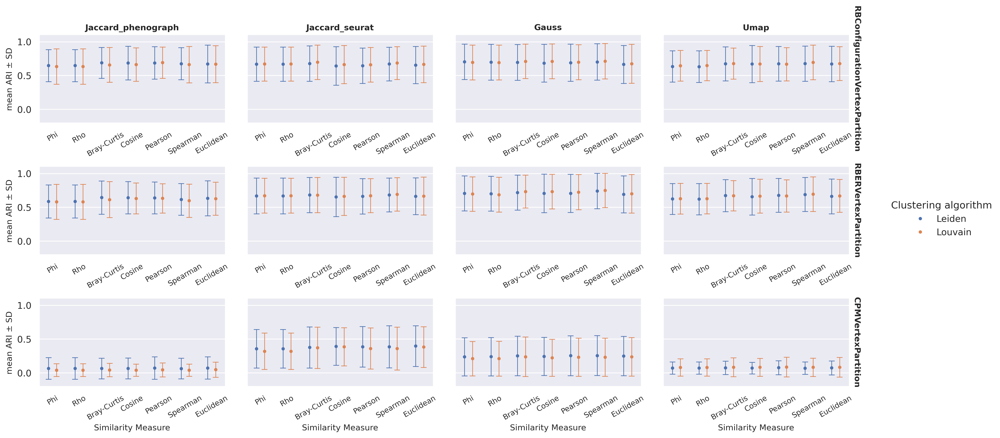

In [98]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=df_matches_best_k_res, kind="point",errorbar='sd',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1.1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1.1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SD' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_res/optimal_k_res_ARI.eps',format='eps', bbox_inches='tight')

### Optimal k and varying resolution

#### Informed/Guided scenario

In [64]:
matches_best_k_res_informed = []

for idx, row in best_comb_shrink.iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','K_Neighbors', 'Clustering_algorithm']).copy()
    best_res = row.Resolution
    match_res = matches[(matches.Resolution >= round((best_res - 0.2),3)) & 
                              (matches.Resolution <= round((best_res + 0.2),3))]
    print(f"Optimal resolution for {row.Dataset},{row.Clustering_algorithm} = {best_res}. Range around optimal (with optimal resolution included) has {len(match_res)} values ")
    matches_best_k_res_informed.append(match_res)

df_matches_best_k_res_informed = pd.concat(matches_best_k_res_informed)

Optimal resolution for BaronPancreasData,Leiden = 0.021. Range around optimal (with optimal resolution included) has 1008 values 
Optimal resolution for BaronPancreasData,Louvain = 0.021. Range around optimal (with optimal resolution included) has 1008 values 
Optimal resolution for Biase,Leiden = 1.161. Range around optimal (with optimal resolution included) has 1764 values 
Optimal resolution for Biase,Louvain = 1.161. Range around optimal (with optimal resolution included) has 1764 values 
Optimal resolution for DarmanisBrainData,Leiden = 0.261. Range around optimal (with optimal resolution included) has 1764 values 
Optimal resolution for DarmanisBrainData,Louvain = 0.361. Range around optimal (with optimal resolution included) has 1764 values 
Optimal resolution for Deng,Leiden = 0.201. Range around optimal (with optimal resolution included) has 1764 values 
Optimal resolution for Deng,Louvain = 0.201. Range around optimal (with optimal resolution included) has 1764 values 
Optima

In [65]:
aggregate_informed_k = df_matches_best_k_res_informed.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()

/tmp/ipykernel_1598/2801088591.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregate_informed_k = df_matches_best_k_res_informed.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()


In [16]:
agg_check_k = aggregate_informed_k.groupby(['Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PSI'].mean().reset_index()
agg_check_k = aggregate_informed_k.groupby(['Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PSI'].mean().reset_index()
agg_check_res = aggregate_informed_res.groupby(['Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PSI'].mean().reset_index()

/tmp/ipykernel_941/3435809695.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg_check_k = aggregate_informed_k.groupby(['Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PSI'].mean().reset_index()


KeyError: 'Column not found: PSI'

In [ ]:
check_res = best_check.loc[np.isclose(best_check.PSI, agg_check_res.PSI, atol=0.002)]

In [ ]:
check_res

In [ ]:
check_k = best_check.loc[np.isclose(best_check.PSI, agg_check_k.PSI, atol=0.002)]

In [ ]:
check_k

In [ ]:
best_check = df_matches_best_k_res.groupby(['Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PSI'].mean().reset_index()
best_check[~mask]

In [ ]:
aggregate_informed_k

/tmp/ipykernel_1598/4174729187.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

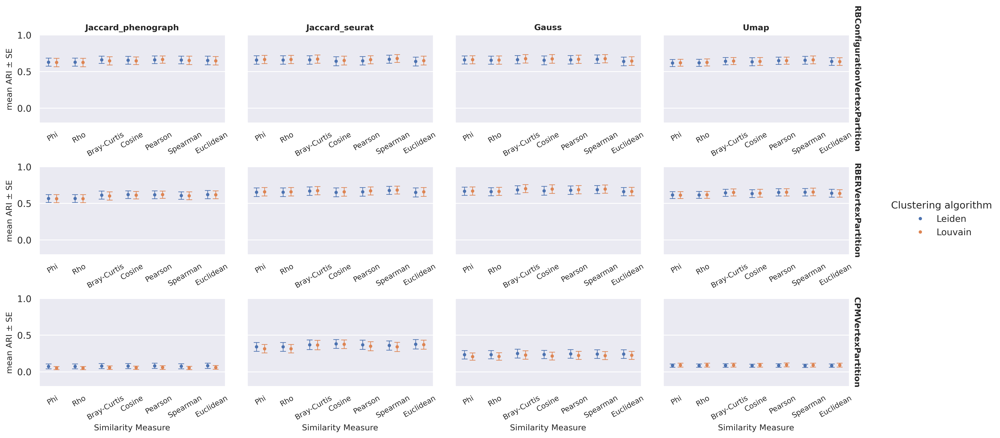

In [67]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_informed_k, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_vary_res/informed_scenario_ARI.eps',format='eps', bbox_inches='tight')

##### Adjusted y-axes

/tmp/ipykernel_1598/3497287879.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

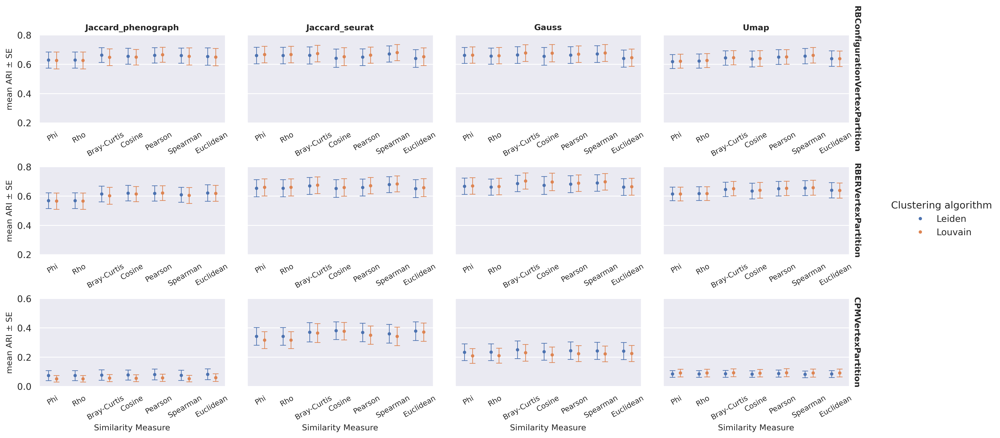

In [69]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_informed_k, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)

g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            
n_cols = len(g.col_names)
ylims = [
    (0.2, 0.8),  # For RBConfigurationVertexPartition
    (0.2, 0.8),  # For RBERVertexPartition
    (0.0, 0.6)  # For CPMVertexPartition
]

for i, (ax_row, ylim) in enumerate(zip(g.axes, ylims)):
    for ax in ax_row:
        ax.set_ylim(ylim)

for row in g.axes:
    for j, ax in enumerate(row):
        if j != 0:  # Not the first column
            ax.set_yticklabels([])
            ax.set_ylabel('')
# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_vary_res/informed_scenario_adjust_axs_ARI.eps',format='eps', bbox_inches='tight')

#### Uninformed scenario

In [70]:
matches_best_k_res_all= []
for idx, row in best_comb_shrink.sort_values(by=['Standard','Dataset']).iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','K_Neighbors', 'Clustering_algorithm']).copy()
    matches['standard'] = row.Standard    
    matches_best_k_res_all.append(matches)

In [71]:
df_matches_best_k_res_all = pd.concat(matches_best_k_res_all)

In [72]:
aggregate_uninformed_k = df_matches_best_k_res_all.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()

/tmp/ipykernel_1598/2461493538.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregate_uninformed_k = df_matches_best_k_res_all.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()


/tmp/ipykernel_1598/3968845933.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

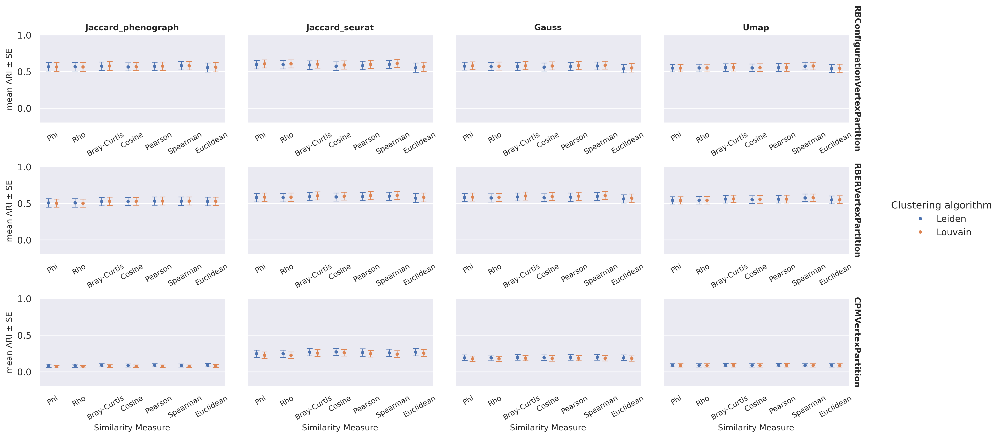

In [74]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed_k, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_vary_res/uninformed_scenario_ARI.eps',format='eps', bbox_inches='tight')

##### Adjusted y-axes

/tmp/ipykernel_1598/2651571662.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

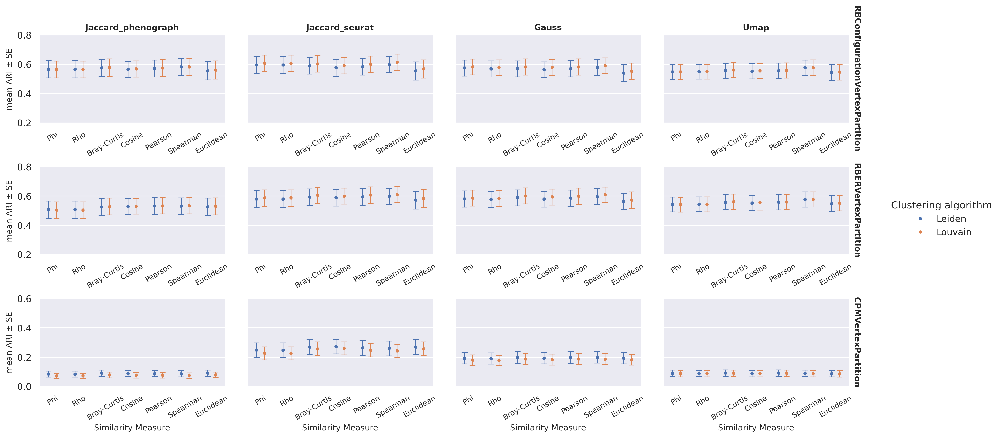

In [77]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed_k, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')


n_cols = len(g.col_names)
ylims = [
    (0.2, 0.8),  # For RBConfigurationVertexPartition
    (0.2, 0.8),  # For RBERVertexPartition
    (0.0, 0.6)  # For CPMVertexPartition
]

for i, (ax_row, ylim) in enumerate(zip(g.axes, ylims)):
    for ax in ax_row:
        ax.set_ylim(ylim)

for row in g.axes:
    for j, ax in enumerate(row):
        if j != 0:  # Not the first column
            ax.set_yticklabels([])
            ax.set_ylabel('')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_vary_res/uninformed_scenario_adjust_axs_ARI.png',format = 'png', bbox_inches='tight')

/tmp/ipykernel_911/2101400529.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="PSI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pal

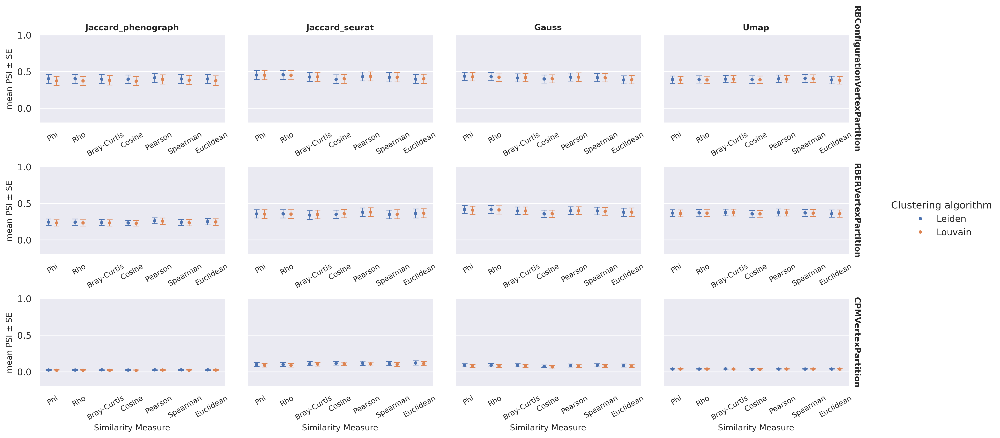

<Figure size 5610x3081 with 0 Axes>

In [36]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="PSI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed_k, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PSI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean PSI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_k_vary_res/uninformed_scenario.eps', format= 'eps', bbox_inches='tight')

/tmp/ipykernel_2423/738331512.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="PSI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",


/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient p

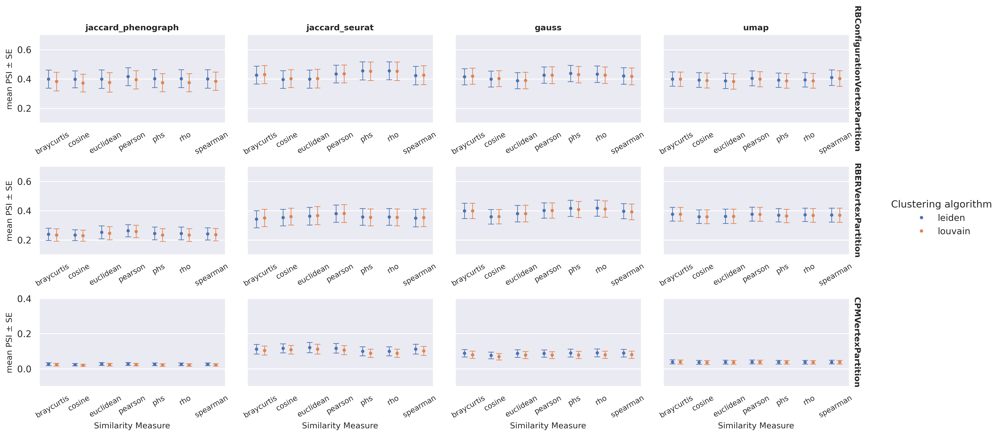

In [53]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="PSI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PSI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
# for ax in g.axes.flatten():
#     ax.set_ylim(0.0, 0.6)

# n_cols = len(g.col_names)
# for i, ax in enumerate(g.axes.flatten()):
#     ax.set_ylim(0.0, 0.6)
#     if i % n_cols != 0:
#         ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean PSI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

n_cols = len(g.col_names)
ylims = [
    (0.1, 0.7),  # For RBConfigurationVertexPartition
    (0.1, 0.7),  # For RBERVertexPartition
    (-0.1, 0.4)  # For CPMVertexPartition
]

for i, (ax_row, ylim) in enumerate(zip(g.axes, ylims)):
    for ax in ax_row:
        ax.set_ylim(ylim)

for row in g.axes:
    for j, ax in enumerate(row):
        if j != 0:  # Not the first column
            ax.set_yticklabels([])
            ax.set_ylabel('')

            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')

Fix resolution and  K_number  and then compare all of the other metrics between algorithms.


For every best-combination per dataset, fix K_neighbors and resolution accordingly to this combination, and then find values for the rest of hyper_parameters. Finding optimal resolution and K may help to benchmark other non-numerical hyper-parameters. We look for the best-combinations, per dataset, per algorithm (optimal number of k and resolution) they were often different between algorithms. 

If we had a chance to adjust K-value and resolution value per dataset, how changing other parameters affect the result? 

In [120]:
dfs = []

for idx,row in best_comb_shrink.iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','Resolution', 'K_Neighbors','Clustering_algorithm'])
    #print(best_k)
    #print(np.unique(match_k.K_Neighbors))
    #print(match_k.shape)
    dfs.append(matches)


In [121]:
appended_data_best = pd.concat(dfs)

In [122]:
custom_order = ['phs', 'rho', 'braycurtis','cosine', 'pearson', 'spearman','euclidean']

# Convert 'Value' column to categorical with custom order
appended_data_best['Similarity_Measure'] = pd.Categorical(appended_data_best['Similarity_Measure'], categories=custom_order, ordered=True)

# Sort DataFrame by the 'Value' column using the custom order
appended_dat_best = appended_data_best.sort_values(by='Similarity_Measure')

# Display the sorted DataFrame
#print("Sorted DataFrame:")
#print(df_sorted)


dat_best = appended_dat_best.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()

/tmp/ipykernel_2942/813181019.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dat_best = appended_dat_best.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()


In [123]:
dat_best

,Dataset,Clustering_algorithm,Similarity_Measure,Quality_Function,Graph_type,PCA_score
0,BaronPancreasData,leiden,phs,CPMVertexPartition,gauss,-0.432389
1,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_phenograph,-0.544366
2,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_seurat,-0.458204
3,BaronPancreasData,leiden,phs,CPMVertexPartition,umap,-0.486945
4,BaronPancreasData,leiden,phs,RBConfigurationVertexPartition,gauss,-0.128162
...,...,...,...,...,...,...
3691,Zheng,louvain,euclidean,RBConfigurationVertexPartition,umap,0.350783
3692,Zheng,louvain,euclidean,RBERVertexPartition,gauss,0.542886
3693,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_phenograph,-0.101094
3694,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_seurat,NaN


/tmp/ipykernel_2942/1296565983.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradi

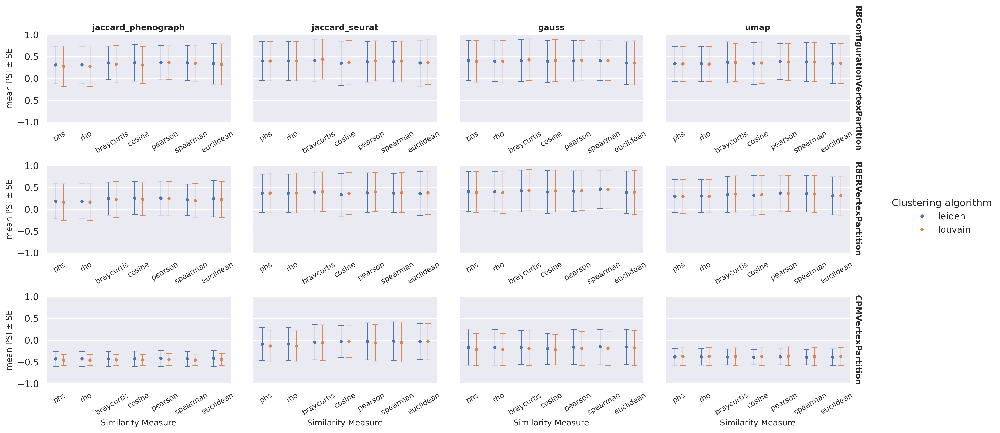

In [124]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=dat_best, kind="point",errorbar='sd',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['jaccard_phenograph','jaccard_seurat','gauss','umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PCA_score", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-1, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-1, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean PSI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')

/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient p

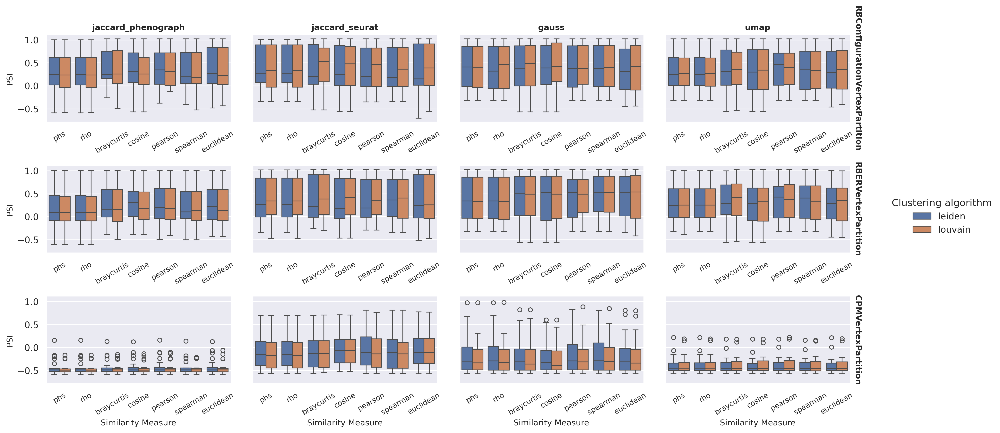

In [126]:
import seaborn as sns 
import matplotlib.pyplot as plt
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300

#sns.set_context("paper", font_scale=2) 

#similarity_measures_order = ['phs', 'cosine', 'pearson', 'spearman', 'braycurtis','euclidean','rho']  # Adjust this list as per your data
g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",col_order=['jaccard_phenograph','jaccard_seurat','gauss','umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'],
                data=dat_best, kind="box",
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,legend='full')
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PCA_score", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=True)

#for pair in g.axes_dict:                                       
    #g.axes_dict[pair].set_xticklabels(similarity_measures_order)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('PSI' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

#g.set_axis_labels(,'PSI')
# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)


### Optimal resolution and varying k

#### Informed/Guided scenario

In [78]:
matches_best_res_k_informed = []
for idx, row in best_comb_shrink.iterrows():
    matches_k = match_rows_fast(row, all_results, ['Dataset','Resolution','Clustering_algorithm'])  
    print(len(np.unique(matches_k.K_Neighbors)))
    range_k = len(np.unique(matches_k.K_Neighbors))
    best_k = row.K_Neighbors
    optimal_range = round(range_k * 0.1)

    # Select values within the range of best_k ± 0.1% of the whole range 
    match_k_range = matches_k[(matches_k.K_Neighbors >= best_k - optimal_range) & (matches_k.K_Neighbors <= best_k + optimal_range)]

    

    # # If fewer than 21 matches, adjust by taking extra values
    # if len(match_k) < 21:
    #     extra_needed = 21 - len(match_k)
        
    #     # Try to take from upper range first
    #     additional_matches_upper = k_all_range[k_all_range.K_Neighbors > best_k + 10].head(extra_needed)
    #     remaining_needed = extra_needed - len(additional_matches_upper)
        
    #     # If still not enough, take from lower range
    #     additional_matches_lower = pd.DataFrame()
    #     if remaining_needed > 0:
    #         additional_matches_lower = k_all_range[k_all_range.K_Neighbors < best_k - 10].tail(remaining_needed)
        
    #     # Combine original matches with extra matches
    #     match_k = pd.concat([match_k, additional_matches_upper, additional_matches_lower])

    # Ensure exactly 21 rows and keep K_Neighbors sorted
    #match_k = match_k.sort_values(by="K_Neighbors").head(optimal_range)

    matches_best_res_k_informed.append(match_k_range)

# Concatenate all matches
df_matches_best_res_k_informed = pd.concat(matches_best_res_k_informed)

98
98
43
43
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
98
79
79
98
98
98
98


In [79]:
aggregate_informed_res = df_matches_best_res_k_informed.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()

/tmp/ipykernel_1598/258896132.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregate_informed_res = df_matches_best_res_k_informed.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()


/tmp/ipykernel_1598/1676722802.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

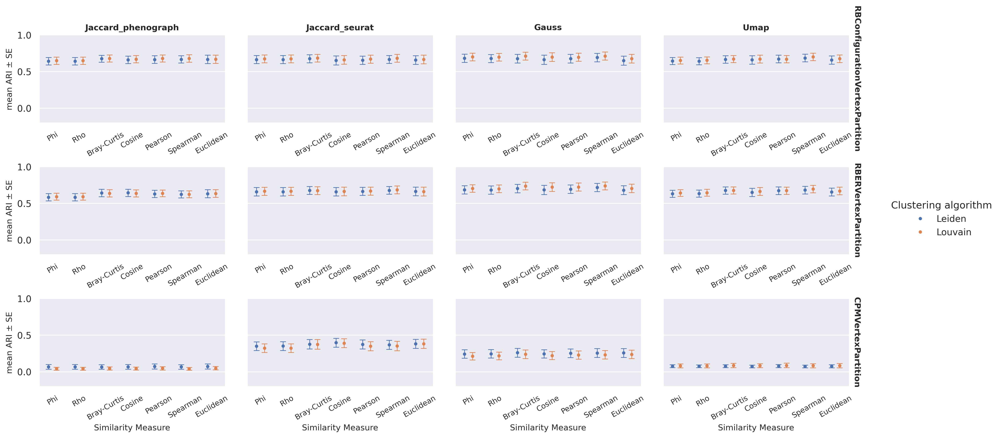

In [81]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_informed_res, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_res_vary_k/informed_scenario_ARI.eps',format = 'eps', bbox_inches='tight')

##### Adjusted y-axes

/tmp/ipykernel_1598/4188253576.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient pa

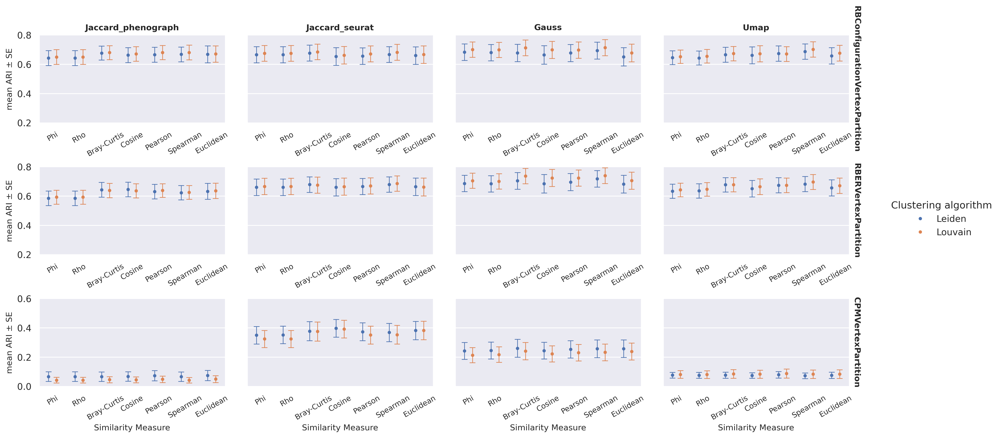

In [84]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_informed_res, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)

g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            
n_cols = len(g.col_names)
ylims = [
    (0.2, 0.8),  # For RBConfigurationVertexPartition
    (0.2, 0.8),  # For RBERVertexPartition
    (0.0, 0.6)  # For CPMVertexPartition
]

for i, (ax_row, ylim) in enumerate(zip(g.axes, ylims)):
    for ax in ax_row:
        ax.set_ylim(ylim)

for row in g.axes:
    for j, ax in enumerate(row):
        if j != 0:  # Not the first column
            ax.set_yticklabels([])
            ax.set_ylabel('')
# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_res_vary_k/informed_scenario_adjust_axs_ARI.png', format= 'png', bbox_inches='tight')

*Are certain metrics consistently associated with higher/lower ARI values across datasets? 
*Euclidean in majority of cases have the longest whiskers 
*CPMVertexPartition optimization with jaccard and umap graphs lead to results having median ARI below 0.2 for all of the similarity metric.
*Median ARI score for Leiden was always higher in case of proportionality-based metrics- phs and rho (which were benchmarked and proposed as an alternative to other (distance-based, correlation-based)).



#### Uninformed scenario

In [85]:
matches_best_res_k_all= []
for idx, row in best_comb_shrink.sort_values(by=['Standard','Dataset']).iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','Resolution', 'Clustering_algorithm']).copy()
    matches['standard'] = row.Standard    
    matches_best_res_k_all.append(matches)

In [86]:
df_matches_best_res_k_all = pd.concat(matches_best_res_k_all)

In [87]:
aggregate_uninformed_res = df_matches_best_res_k_all.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()

/tmp/ipykernel_1598/761035120.py:1: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  aggregate_uninformed_res = df_matches_best_res_k_all.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['ARI'].mean().reset_index()


/tmp/ipykernel_23132/2830040321.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient p

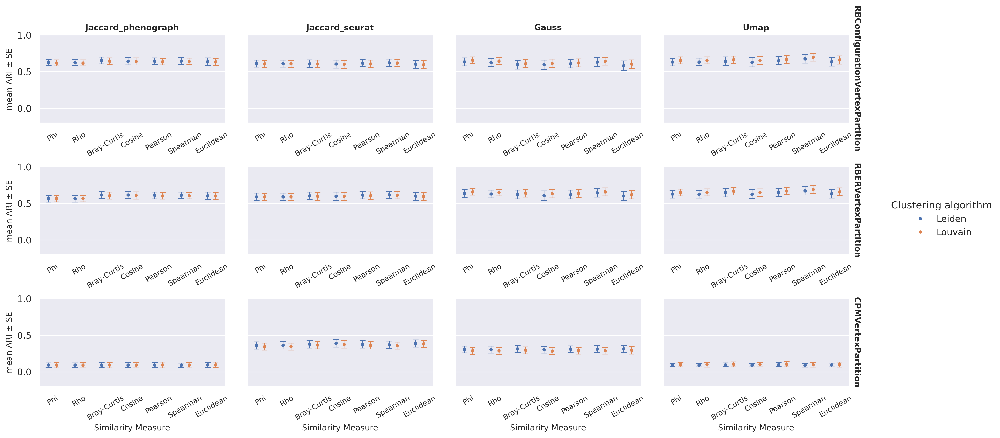

In [120]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed_res, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-0.2, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-0.2, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_res_vary_k/uninformed_scenario_ARI.png', format= 'png', bbox_inches='tight')

##### Adjusted y-axes

/tmp/ipykernel_23132/1707238316.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient p

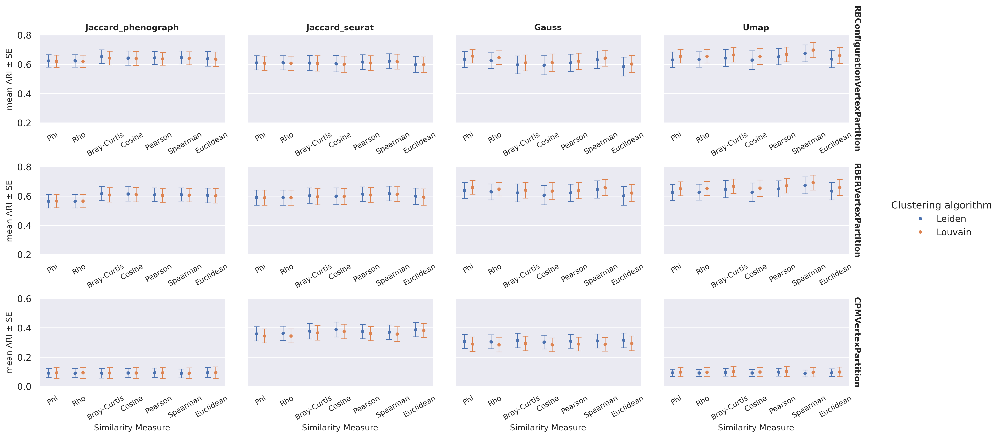

In [122]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="ARI", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=aggregate_uninformed_res, kind="point",errorbar='se',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['Jaccard_phenograph','Jaccard_seurat','Gauss','Umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="ARI", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)

g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean ARI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            
n_cols = len(g.col_names)
ylims = [
    (0.2, 0.8),  # For RBConfigurationVertexPartition
    (0.2, 0.8),  # For RBERVertexPartition
    (0.0, 0.6)  # For CPMVertexPartition
]

for i, (ax_row, ylim) in enumerate(zip(g.axes, ylims)):
    for ax in ax_row:
        ax.set_ylim(ylim)

for row in g.axes:
    for j, ax in enumerate(row):
        if j != 0:  # Not the first column
            ax.set_yticklabels([])
            ax.set_ylabel('')
# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
plt.savefig('/work/Master_Project/Notebooks/plots_paper/performance_analysis/optimal_res_vary_k/uninformed_scenario_adjust_yaxis_ARI.png', format = 'png', bbox_inches='tight')

In [50]:
aggregate_uninformed_res

,Dataset,Clustering_algorithm,Similarity_Measure,Quality_Function,Graph_type,PSI
0,BaronPancreasData,leiden,phs,CPMVertexPartition,gauss,0.004086
1,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_phenograph,0.000935
2,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_seurat,0.003092
3,BaronPancreasData,leiden,phs,CPMVertexPartition,umap,0.003167
4,BaronPancreasData,leiden,phs,RBConfigurationVertexPartition,gauss,0.100797
...,...,...,...,...,...,...
3691,Zheng,louvain,euclidean,RBConfigurationVertexPartition,umap,0.183976
3692,Zheng,louvain,euclidean,RBERVertexPartition,gauss,0.165240
3693,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_phenograph,0.002187
3694,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_seurat,NaN


In [49]:
aggregate_uninformed_k

,Dataset,Clustering_algorithm,Similarity_Measure,Quality_Function,Graph_type,PSI
0,BaronPancreasData,leiden,phs,CPMVertexPartition,gauss,0.004086
1,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_phenograph,0.000935
2,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_seurat,0.003092
3,BaronPancreasData,leiden,phs,CPMVertexPartition,umap,0.003167
4,BaronPancreasData,leiden,phs,RBConfigurationVertexPartition,gauss,0.100797
...,...,...,...,...,...,...
3691,Zheng,louvain,euclidean,RBConfigurationVertexPartition,umap,0.183976
3692,Zheng,louvain,euclidean,RBERVertexPartition,gauss,0.165240
3693,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_phenograph,0.002187
3694,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_seurat,NaN


### Optimal choice of k but varied resolution

#### Guided scenario

In [123]:
def ceil_to_nearest(value, base=0.001, step=0.02):
    index = math.ceil((value - base) / step)
    return round(base + index * step, 6)  # round to avoid floating point errors

dfs=[]
for idx, row in best_comb_shrink.iterrows():
    # Find matches based on multiple column criteria
    best_res = row.Resolution
    best_percentage =  ceil_to_nearest(best_res * 0.1)
    print(best_percentage)
    matches = match_rows_fast(row, all_results, ['Dataset','K_Neighbors'])

    match_res= matches[(matches.Resolution >= best_res - best_percentage) & (matches.Resolution <= best_res + best_percentage)]
    print(f"Optimal resolution for {row.Dataset},{row.Clustering_algorithm} = {best_res}. Range around optimal (with optimal res included) has {len(match_res)} values ")

    dfs.append(match_res)

# Concatenate all matches
appended_data_informed_res = pd.concat(dfs)

0.021
Optimal resolution for BaronPancreasData,Leiden = 0.021. Range around optimal (with optimal res included) has 504 values 
0.021
Optimal resolution for BaronPancreasData,Louvain = 0.021. Range around optimal (with optimal res included) has 504 values 
0.121
Optimal resolution for Biase,Leiden = 1.161. Range around optimal (with optimal res included) has 2184 values 
0.121
Optimal resolution for Biase,Louvain = 1.161. Range around optimal (with optimal res included) has 2184 values 
0.041
Optimal resolution for DarmanisBrainData,Leiden = 0.261. Range around optimal (with optimal res included) has 840 values 
0.041
Optimal resolution for DarmanisBrainData,Louvain = 0.361. Range around optimal (with optimal res included) has 840 values 
0.021
Optimal resolution for Deng,Leiden = 0.201. Range around optimal (with optimal res included) has 504 values 
0.021
Optimal resolution for Deng,Louvain = 0.201. Range around optimal (with optimal res included) has 504 values 
0.121
Optimal resolu

In [124]:
custom_order = ['phs', 'rho', 'braycurtis','cosine', 'pearson', 'spearman','euclidean']

# Convert 'Value' column to categorical with custom order
appended_data_informed_res['Similarity_Measure'] = pd.Categorical(appended_data_informed_res['Similarity_Measure'], categories=custom_order, ordered=True)

# Sort DataFrame by the 'Value' column using the custom order
appended_data_informed_res = appended_data_informed_res.sort_values(by='Similarity_Measure')

# Display the sorted DataFrame
#print("Sorted DataFrame:")
#print(df_sorted)


dat_0125 = appended_data_informed_res.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()

/tmp/ipykernel_23132/4132290863.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dat_0125 = appended_data_informed_res.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()


/tmp/ipykernel_5505/2856874791.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradi

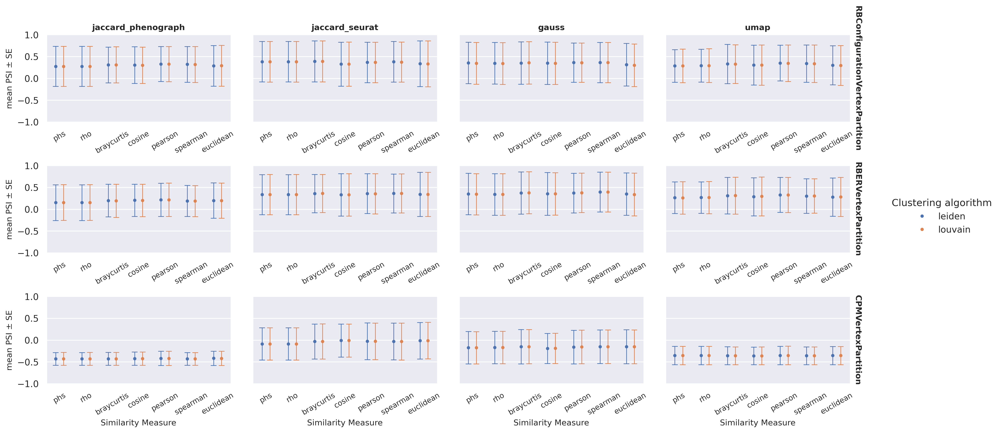

In [81]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=dat_0125, kind="point",errorbar='sd',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['jaccard_phenograph','jaccard_seurat','gauss','umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PCA_score", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-1, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-1, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean PSI ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')

#### Uninformed scenario

In [19]:
dfs = []


for idx, row in best_comb_shrink.iterrows():
    matches = match_rows_fast(row, all_results, ['Dataset','K_Neighbors'])
    dfs.append(matches)
appended_data_all_res = pd.concat(dfs)

In [20]:
custom_order = ['phs', 'rho', 'braycurtis','cosine', 'pearson', 'spearman','euclidean']

# Convert 'Value' column to categorical with custom order
appended_data_all_res['Similarity_Measure'] = pd.Categorical(appended_data_all_res['Similarity_Measure'], categories=custom_order, ordered=True)

# Sort DataFrame by the 'Value' column using the custom order
appended_dat_all_res = appended_data_all_res.sort_values(by='Similarity_Measure')

# Display the sorted DataFrame
#print("Sorted DataFrame:")
#print(df_sorted)


dat_all_res = appended_dat_all_res.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()

/tmp/ipykernel_1753/460882837.py:14: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  dat_all_res = appended_dat_all_res.groupby(['Dataset','Clustering_algorithm', 'Similarity_Measure', 'Quality_Function', 'Graph_type'])['PCA_score'].mean().reset_index()


/tmp/ipykernel_1753/3007054395.py:3: FutureWarning: 

The `errwidth` parameter is deprecated. And will be removed in v0.15.0. Pass `err_kws={'linewidth': 0.8}` instead.

  g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations.
  self._figure.tight_layout(*args, **kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradient palette using color= is deprecated and will be removed in v0.14.0. Set `palette='dark:#4c72b0'` for the same effect.

  func(*plot_args, **plot_kwargs)
/work/Master_Project/miniconda3/envs/sc_benchmark/lib/python3.11/site-packages/seaborn/axisgrid.py:854: FutureWarning: 

Setting a gradi

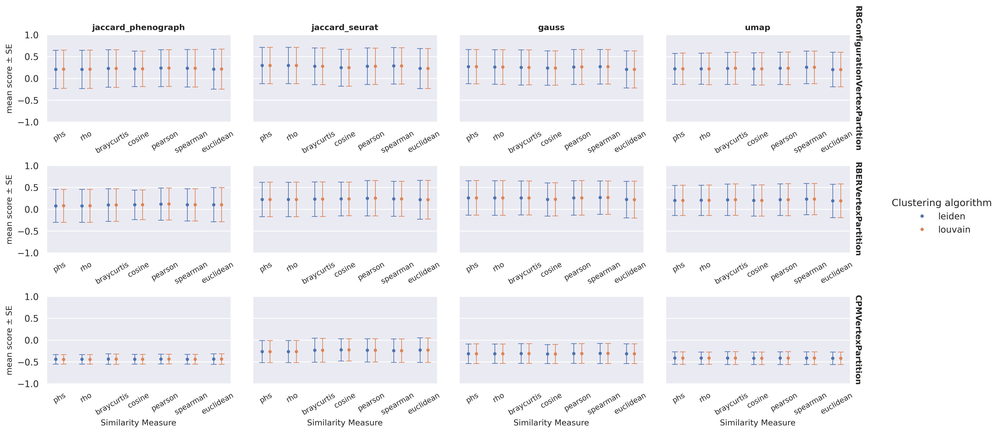

In [22]:
sns.set_theme(rc={'figure.figsize':(18.7,10.27)})
plt.rcParams['figure.dpi'] = 300
g = sns.catplot(x="Similarity_Measure", y="PCA_score", hue="Clustering_algorithm", col="Graph_type", row="Quality_Function",
                data=dat_all_res, kind="point",errorbar='sd',markersize=2, sharey=False,
                height=2.5, aspect=1.5,margin_titles=True,sharex=False,linestyle='',errwidth=0.8, capsize=.2, dodge=0.3,col_order=['jaccard_phenograph','jaccard_seurat','gauss','umap'],row_order=['RBConfigurationVertexPartition','RBERVertexPartition','CPMVertexPartition'])
g.map_dataframe(sns.stripplot, x="Similarity_Measure", y="PCA_score", 
                hue="Clustering_algorithm", 
                alpha=0.0, dodge=0.3,size=1)
g.fig.subplots_adjust(top=0.92, wspace=0.12,hspace=0.5)
for ax in g.axes.flatten():
    ax.set_ylim(-1, 1)

n_cols = len(g.col_names)
for i, ax in enumerate(g.axes.flatten()):
    ax.set_ylim(-1, 1)
    if i % n_cols != 0:
        ax.set_yticklabels([])
g.set_xticklabels(rotation=30,fontsize=9)
g.set_titles(row_template="{row_name}",col_template="{col_name}", size=10,fontweight='bold')
g.set_xlabels('Similarity Measure', fontsize=10)
g.set_ylabels('mean score ± SE' , fontsize= 10)
g._legend.set_title('Clustering algorithm')

# for i,ax in enumerate(g.axes.flatten()):
#     if i in [0, 1, 2]:
#         ax.set_ylim(-0.5,1)
#         if i==1 or i==2:
#             ax.set_yticklabels([])
#     elif i in [3, 4, 5]:
#         ax.set_ylim(-0.5,1)
#         if i==4 or i==5:
#             ax.set_yticklabels([])            
#     elif i in [6, 7, 8]:
#         ax.set_ylim(-0.5,1)
#         if i==7 or i==8:
#             ax.set_yticklabels([])
#     elif i in [9, 10, 11]:
#         ax.set_ylim(-0.5,1)
#         if i==10 or i==11:
#             ax.set_yticklabels([])
            
            

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')

# g.map(sns.stripplot, "sex", "total_bill", "smoker", 
#       palette=["#404040"], alpha=0.6, dodge=True)
#plt.show()
#plt.savefig('/work/Master_Project/output/k_res_20_ylim.png', bbox_inches='tight')


In [56]:
aggregate_informed_res

,Dataset,Clustering_algorithm,Similarity_Measure,Quality_Function,Graph_type,PSI
0,BaronPancreasData,leiden,phs,CPMVertexPartition,gauss,0.057921
1,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_phenograph,0.003744
2,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_seurat,0.027097
3,BaronPancreasData,leiden,phs,CPMVertexPartition,umap,0.032520
4,BaronPancreasData,leiden,phs,RBConfigurationVertexPartition,gauss,0.028459
...,...,...,...,...,...,...
3691,Zheng,louvain,euclidean,RBConfigurationVertexPartition,umap,0.281766
3692,Zheng,louvain,euclidean,RBERVertexPartition,gauss,0.264982
3693,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_phenograph,0.160416
3694,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_seurat,NaN


In [57]:
aggregate_informed_k

,Dataset,Clustering_algorithm,Similarity_Measure,Quality_Function,Graph_type,PSI
0,BaronPancreasData,leiden,phs,CPMVertexPartition,gauss,0.022379
1,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_phenograph,0.003186
2,BaronPancreasData,leiden,phs,CPMVertexPartition,jaccard_seurat,0.019261
3,BaronPancreasData,leiden,phs,CPMVertexPartition,umap,0.017377
4,BaronPancreasData,leiden,phs,RBConfigurationVertexPartition,gauss,0.056864
...,...,...,...,...,...,...
3691,Zheng,louvain,euclidean,RBConfigurationVertexPartition,umap,0.252732
3692,Zheng,louvain,euclidean,RBERVertexPartition,gauss,0.258771
3693,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_phenograph,0.001884
3694,Zheng,louvain,euclidean,RBERVertexPartition,jaccard_seurat,NaN


## Dependency between known clusters structure and hyper-parameters

In [87]:
def entropy_2(labels, base=None):
  """ Computes entropy of label distribution. """

  n_labels = len(labels)

  if n_labels <= 1:
    return 0

  value,counts = np.unique(labels, return_counts=True)
  probs = counts / n_labels
  n_classes = np.count_nonzero(probs)

  if n_classes <= 1:
    return 0

  ent = 0.

  # Compute entropy
  base = e if base is None else base
  for i in probs:
    ent -= i * log(i, base)

  return ent

In [88]:
best_comb_clust_prop = best_comb_shrink.copy()
for idx, row in best_comb_shrink.iterrows():
    clustering = cfg.check_clusters_number(row.Dataset)
    no_clusters = len(clustering.cat.categories)
    counts = clustering.value_counts().values
    probs = counts / counts.sum()
    gini = 1 - np.sum(probs**2)
    entropy = entropy_2(clustering.value_counts().values)
    best_comb_clust_prop.loc[idx,'Gini'] = gini
    best_comb_clust_prop.loc[idx, 'No_clusters'] = no_clusters
    best_comb_clust_prop.loc[idx, 'Entropy'] = entropy
    best_comb_clust_prop.loc[idx, 'Dataset_size'] = len(clustering)


In [89]:
bins = pd.cut(best_comb_clust_prop.Entropy, bins = 3, labels =['balanced', 'modaretly imbalanced', 'highly imbalanced'])

In [90]:
best_comb_clust_prop.loc[:, 'Clustering imbalance'] = bins

In [131]:
best_comb_clust_prop.loc[best_comb_clust_prop['No_clusters']==3]

,Dataset,Clustering_algorithm,Quality_Function,Similarity_Measure,K_Neighbors,Graph_type,PSI,ARI,NMI,PCA_score,Max_across_resolution_values,Resolution,Mean_PCA_score,Standard,Gini,No_clusters,Entropy,Dataset_size,Clustering imbalance
2,Biase,leiden,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,81,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced
3,Biase,louvain,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,81,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced
14,Kolodziejczyk,leiden,RBERVertexPartition,cosine,92,jaccard_phenograph,0.447306,0.771030,0.781894,0.546478,4,0.421,0.09105332564741017,gold,0.647295,3.0,1.098612,704.0,balanced
15,Kolodziejczyk,louvain,RBConfigurationVertexPartition,braycurtis,27,gauss,0.447306,0.771030,0.781894,0.546478,7,0.521,None,gold,0.647295,3.0,1.098612,704.0,balanced
30,Tian-sce_sc_10x_qc,leiden,RBConfigurationVertexPartition,braycurtis,100,gauss,1.000000,1.000000,1.000000,1.331625,26,0.281,None,gold,0.665451,3.0,1.098612,902.0,balanced
31,Tian-sce_sc_10x_qc,louvain,RBConfigurationVertexPartition,braycurtis,100,gauss,1.000000,1.000000,1.000000,1.331625,26,0.281,None,gold,0.665451,3.0,1.098612,902.0,balanced
32,Tian-sce_sc_CELseq2_qc,leiden,RBConfigurationVertexPartition,braycurtis,51,jaccard_seurat,1.000000,1.000000,1.000000,1.331625,98,1.021,None,gold,0.658133,3.0,0.636514,274.0,balanced
33,Tian-sce_sc_CELseq2_qc,louvain,RBConfigurationVertexPartition,braycurtis,51,jaccard_seurat,1.000000,1.000000,1.000000,1.331625,98,1.021,None,gold,0.658133,3.0,0.636514,274.0,balanced
34,Tian-sce_sc_Dropseq_qc,leiden,RBConfigurationVertexPartition,braycurtis,62,jaccard_seurat,0.960167,0.945597,0.924398,1.207847,13,0.521,None,gold,0.663072,3.0,1.098612,225.0,balanced
35,Tian-sce_sc_Dropseq_qc,louvain,RBConfigurationVertexPartition,cosine,29,gauss,0.961765,0.958770,0.940313,1.228852,20,0.281,None,gold,0.663072,3.0,1.098612,225.0,balanced


In [142]:
# Group by (DATASET, No_clusters)
grouped = df_plot.groupby(['Dataset', 'K_Neighbors'])

# Apply fixed jitter within each group
jitter_amount = 0.5
offsets = []

for _, group in grouped:
    n = len(group)
    if n == 1:
        offsets.extend([0])
    else:
        # Centered offsets, evenly spaced (e.g. for 2: [-0.25, 0.25], for 3: [-0.5, 0, 0.5])
        jitter_range = jitter_amount * (n - 1)
        group_offsets = np.linspace(-jitter_range / 2, jitter_range / 2, n)
        offsets.extend(group_offsets)

df_plot['x_jittered'] = df_plot['No_clusters'] + offsets

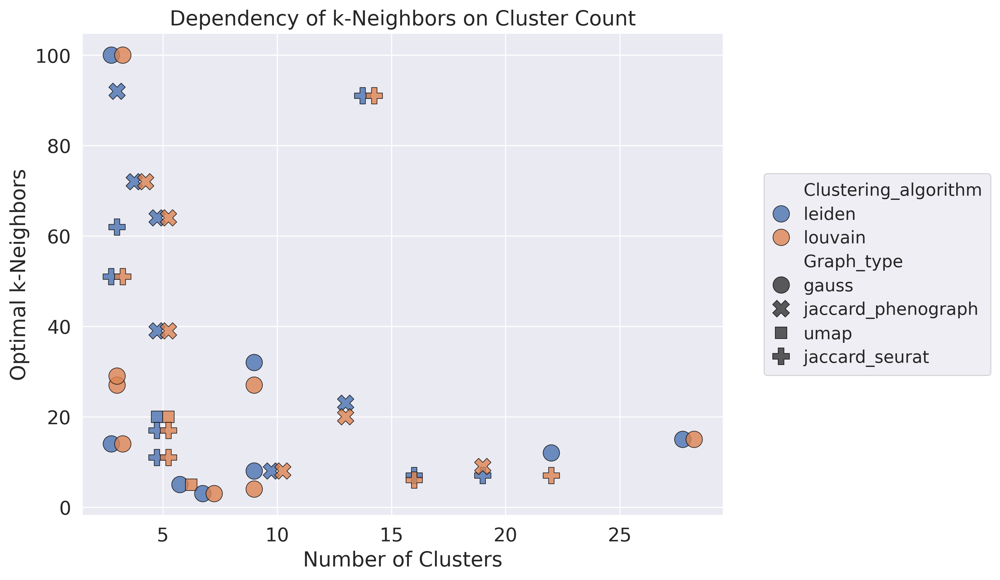

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size




# Bigger, more pronounced points
sns.scatterplot(
    data=df_plot,
    x='x_jittered',
    y='K_Neighbors',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Graph_type',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5,
              # Thin outline
)

# Axis labels & title
plt.xlabel("Number of Clusters")
plt.ylabel("Optimal k-Neighbors")
plt.title("Dependency of k-Neighbors on Cluster Count")

from matplotlib.lines import Line2D

# Unique values
colors = df_plot['Clustering_algorithm'].unique()
markers = df_plot['Graph_type'].unique()

# Color legend handles
color_handles = [
    Line2D([0], [0], marker='o', color='w', label=alg,
           markerfacecolor=sns.color_palette()[i], markersize=10, markeredgecolor='black')
    for i, alg in enumerate(colors)
]

# Marker legend handles
marker_map = {'o': 'Type 1', 's': 'Type 2'}  # example if you map them yourself
marker_handles = [
    Line2D([0], [0], marker=marker, color='gray', label=gt,
           markerfacecolor='gray', markersize=10, markeredgecolor='black')
    for gt, marker in zip(markers, ['o', 'X', 's', '^'])  # adjust to match actual mapping
]

# Add both legends
first_legend = plt.legend(handles=color_handles, title="Clustering Algorithm",
                          bbox_to_anchor=(1.05, 0.7), loc='center left', fontsize='small', title_fontsize='small')

plt.gca().add_artist(first_legend)  # Add the first legend manually

plt.legend(handles=marker_handles, title="Graph Type",
           bbox_to_anchor=(1.05, 0.4), loc='center left', fontsize='small', title_fontsize='small')


plt.tight_layout()
plt.grid(True)
plt.show()


In [144]:
df_plot

,Dataset,Clustering_algorithm,Quality_Function,Similarity_Measure,K_Neighbors,Graph_type,PSI,ARI,NMI,PCA_score,Max_across_resolution_values,Resolution,Mean_PCA_score,Standard,Gini,No_clusters,Entropy,Dataset_size,Clustering imbalance,x_jittered
0,BaronPancreasData,leiden,RBERVertexPartition,spearman,15,gauss,0.033198,0.808842,0.664659,0.110728,1,0.021,-0.24429538513100799,silver,0.565710,28.0,3.047277,8569.0,highly imbalanced,27.75
1,BaronPancreasData,louvain,RBERVertexPartition,spearman,15,gauss,0.033198,0.808842,0.664659,0.110728,1,0.021,-0.24378113627509157,silver,0.565710,28.0,3.047277,8569.0,highly imbalanced,28.25
2,Biase,leiden,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,81,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced,2.75
3,Biase,louvain,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,81,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced,3.25
4,DarmanisBrainData,leiden,RBConfigurationVertexPartition,spearman,8,jaccard_phenograph,0.356154,0.244824,0.503217,-0.042525,1,0.101,None,silver,0.587412,10.0,2.302585,466.0,highly imbalanced,9.75
5,DarmanisBrainData,louvain,RBConfigurationVertexPartition,spearman,8,jaccard_phenograph,0.356154,0.244824,0.503217,-0.042525,1,0.101,None,silver,0.587412,10.0,2.302585,466.0,highly imbalanced,10.25
6,Deng,leiden,RBConfigurationVertexPartition,braycurtis,5,gauss,0.706455,0.882567,0.905434,0.933299,16,0.201,0.49031469344393197,gold,0.688377,6.0,1.791759,268.0,modaretly imbalanced,5.75
7,Deng,louvain,RBERVertexPartition,braycurtis,5,umap,0.706455,0.882567,0.905434,0.933299,19,0.201,None,gold,0.688377,6.0,1.791759,268.0,modaretly imbalanced,6.25
8,Goolam,leiden,RBERVertexPartition,euclidean,64,jaccard_phenograph,0.489045,0.891880,0.876055,0.723349,17,1.141,None,gold,0.645682,5.0,1.332179,124.0,balanced,4.75
9,Goolam,louvain,RBERVertexPartition,euclidean,64,jaccard_phenograph,0.489045,0.891880,0.876055,0.723349,17,1.141,None,gold,0.645682,5.0,1.332179,124.0,balanced,5.25


<Axes: xlabel='No_clusters', ylabel='K_Neighbors'>

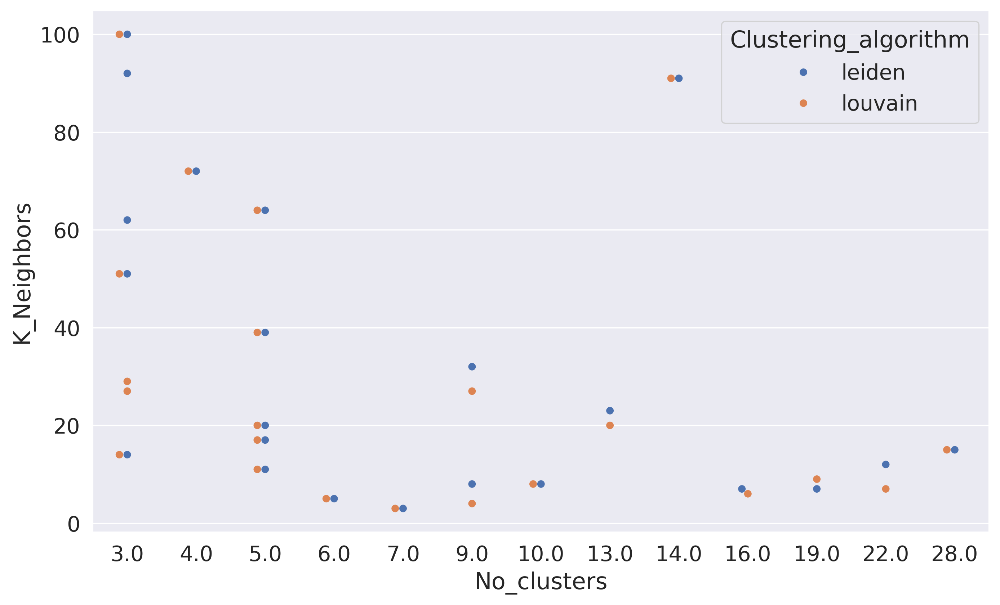

In [ ]:
sns.swarmplot(data=best_comb_clust_prop, x='No_clusters', y='K_Neighbors', hue='Clustering_algorithm')


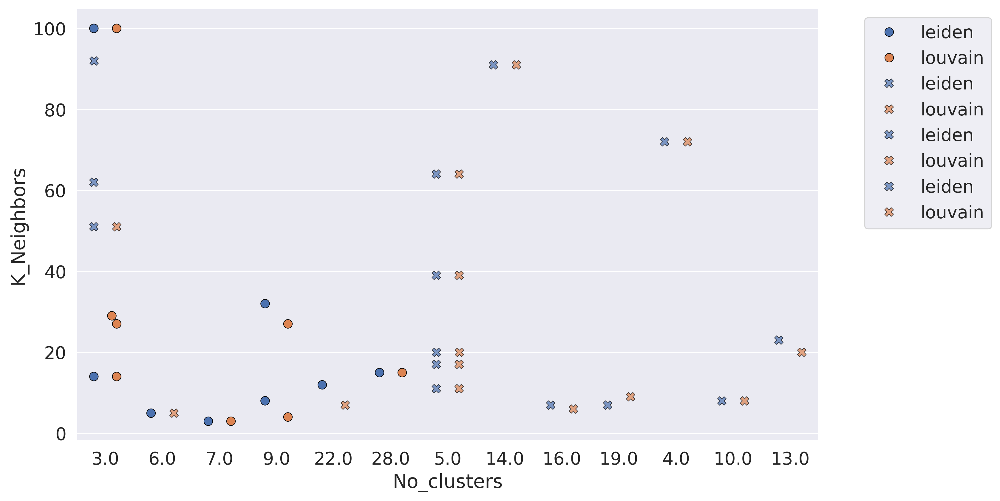

In [ ]:
# First layer
sns.swarmplot(
    data=best_comb_clust_prop[best_comb_clust_prop['Graph_type'] == 'gauss'],
    x='No_clusters',
    y='K_Neighbors',
    hue='Clustering_algorithm',
    dodge=True,
    marker='o',
    size=7,
    edgecolor='black',
    linewidth=0.5
)

# Second layer with different marker or transparency
sns.swarmplot(
    data=best_comb_clust_prop[best_comb_clust_prop['Graph_type'] == 'umap'],
    x='No_clusters',
    y='K_Neighbors',
    hue='Clustering_algorithm',
    dodge=True,
    marker='X',    # Different marker
    size=7,
    edgecolor='black',
    linewidth=0.5,
    alpha=0.7
)

sns.swarmplot(
    data=best_comb_clust_prop[best_comb_clust_prop['Graph_type'] == 'jaccard_seurat'],
    x='No_clusters',
    y='K_Neighbors',
    hue='Clustering_algorithm',
    dodge=True,
    marker='X',    # Different marker
    size=7,
    edgecolor='black',
    linewidth=0.5,
    alpha=0.7
)

sns.swarmplot(
    data=best_comb_clust_prop[best_comb_clust_prop['Graph_type'] == 'jaccard_phenograph'],
    x='No_clusters',
    y='K_Neighbors',
    hue='Clustering_algorithm',
    dodge=True,
    marker='X',    # Different marker
    size=7,
    edgecolor='black',
    linewidth=0.5,
    alpha=0.7
)


plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')


In [ ]:
df_plot

,Dataset,Clustering_algorithm,Quality_Function,Similarity_Measure,K_Neighbors,Graph_type,PSI,ARI,NMI,PCA_score,...,Resolution,Mean_PCA_score,Standard,Gini,No_clusters,Entropy,Dataset_size,Clustering imbalance,x_jittered,y_jittered
0,BaronPancreasData,leiden,RBERVertexPartition,spearman,15,gauss,0.033198,0.808842,0.664659,0.110728,...,0.021,-0.24429538513100799,silver,0.565710,28.0,3.047277,8569.0,highly imbalanced,27.926296,14.931705
1,BaronPancreasData,louvain,RBERVertexPartition,spearman,15,gauss,0.033198,0.808842,0.664659,0.110728,...,0.021,-0.24378113627509157,silver,0.565710,28.0,3.047277,8569.0,highly imbalanced,27.883025,14.862138
2,Biase,leiden,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,...,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced,2.853176,13.727194
3,Biase,louvain,RBERVertexPartition,phs,14,gauss,1.000000,1.000000,1.000000,1.331625,...,1.161,None,gold,0.633070,3.0,0.636514,49.0,balanced,3.237268,13.882976
4,DarmanisBrainData,leiden,RBConfigurationVertexPartition,spearman,8,jaccard_phenograph,0.356154,0.244824,0.503217,-0.042525,...,0.101,None,silver,0.587412,10.0,2.302585,466.0,highly imbalanced,9.856907,8.160577
5,DarmanisBrainData,louvain,RBConfigurationVertexPartition,spearman,8,jaccard_phenograph,0.356154,0.244824,0.503217,-0.042525,...,0.101,None,silver,0.587412,10.0,2.302585,466.0,highly imbalanced,10.223815,7.877784
6,Deng,leiden,RBConfigurationVertexPartition,braycurtis,5,gauss,0.706455,0.882567,0.905434,0.933299,...,0.201,0.49031469344393197,gold,0.688377,6.0,1.791759,268.0,modaretly imbalanced,5.894656,5.123953
7,Deng,louvain,RBERVertexPartition,braycurtis,5,umap,0.706455,0.882567,0.905434,0.933299,...,0.201,None,gold,0.688377,6.0,1.791759,268.0,modaretly imbalanced,5.925314,5.283998
8,Goolam,leiden,RBERVertexPartition,euclidean,64,jaccard_phenograph,0.489045,0.891880,0.876055,0.723349,...,1.141,None,gold,0.645682,5.0,1.332179,124.0,balanced,4.852607,63.891963
9,Goolam,louvain,RBERVertexPartition,euclidean,64,jaccard_phenograph,0.489045,0.891880,0.876055,0.723349,...,1.141,None,gold,0.645682,5.0,1.332179,124.0,balanced,5.221751,64.093879


<Axes: xlabel='No_clusters', ylabel='K_Neighbors'>

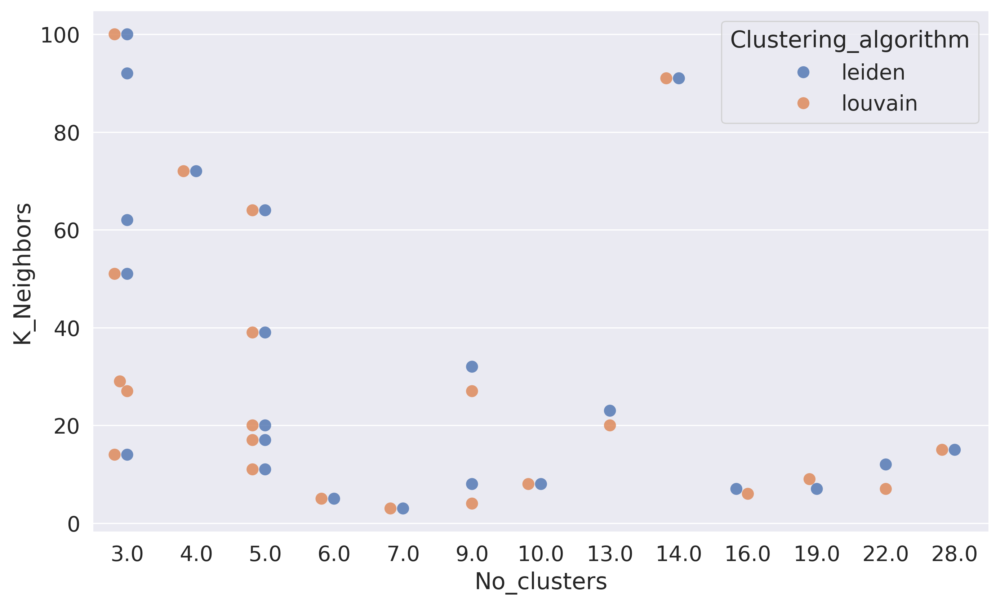

In [77]:
sns.swarmplot(
    data=best_comb_clust_no,
    x='No_clusters',
    y='K_Neighbors',
    hue='Clustering_algorithm',  # Optional
    size=8,
    alpha=0.8
)

<Axes: xlabel='No_clusters', ylabel='Resolution'>

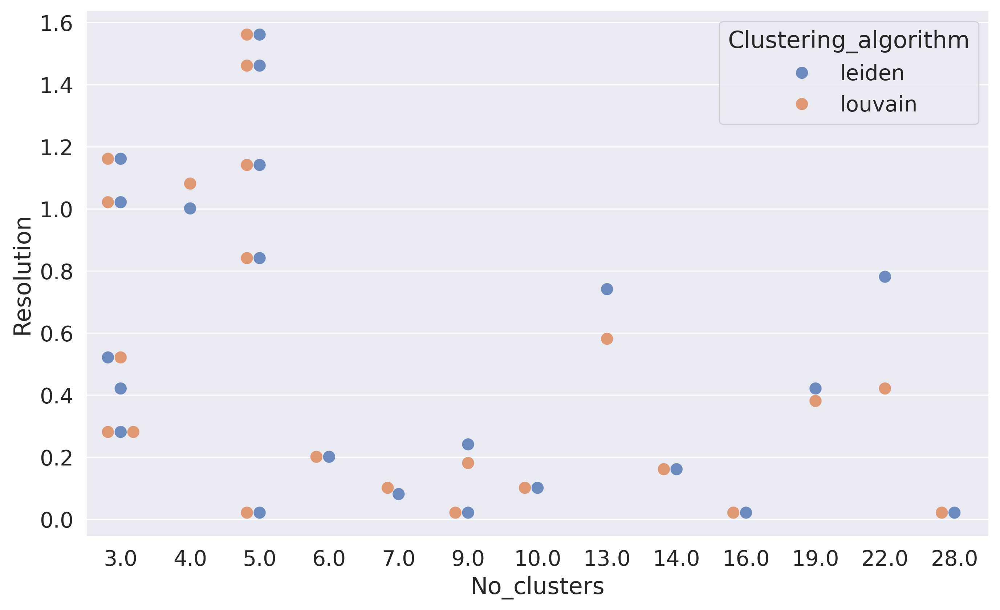

In [78]:
sns.swarmplot(
    data=best_comb_clust_no,
    x='No_clusters',
    y='Resolution',
    hue='Clustering_algorithm',  # Optional
    size=8,
    alpha=0.8
)

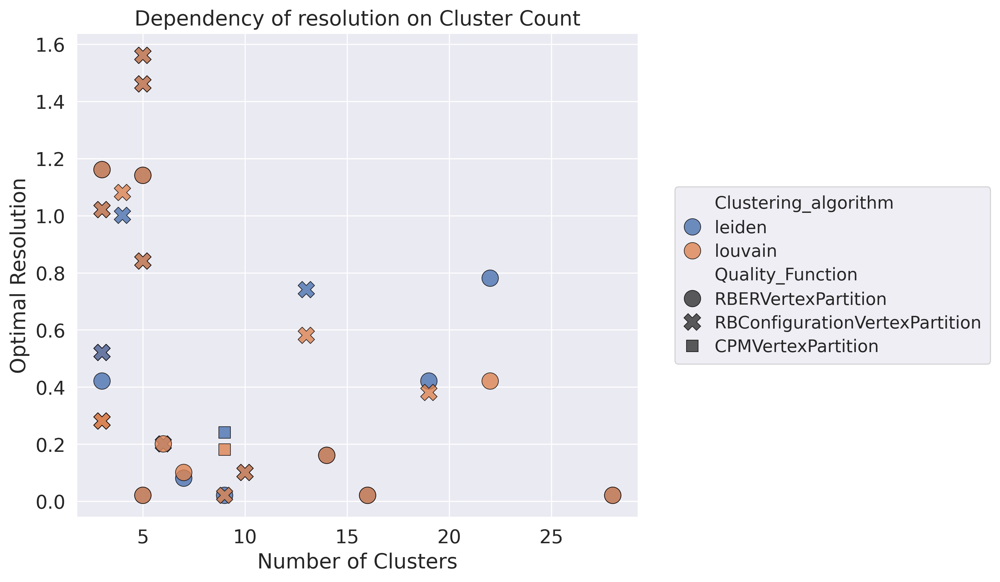

In [69]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size

# Bigger, more pronounced points
sns.scatterplot(
    data=best_comb_clust_no,
    x='No_clusters',
    y='Resolution',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Quality_Function',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5              # Thin outline
)

# Axis labels & title
plt.xlabel("Number of Clusters")
plt.ylabel("Optimal Resolution")
plt.title("Dependency of resolution on Cluster Count")

# Smaller, tidier legend
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    fontsize='small',          # Smaller legend text
    title_fontsize='small',
    borderpad=0.5,
    labelspacing=0.4,
    handlelength=1.0
)

plt.tight_layout()
plt.show()

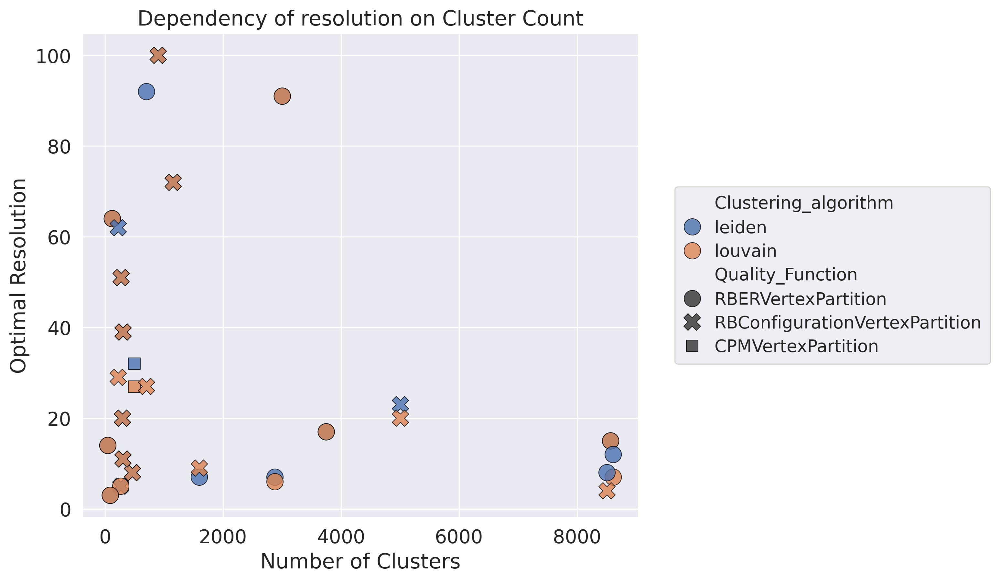

In [74]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size

# Bigger, more pronounced points
sns.scatterplot(
    data=best_comb_clust_no,
    x='Dataset_size',
    y='K_Neighbors',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Quality_Function',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5              # Thin outline
)

# Axis labels & title
plt.xlabel("Number of Clusters")
plt.ylabel("Optimal Resolution")
plt.title("Dependency of resolution on Cluster Count")

# Smaller, tidier legend
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    fontsize='small',          # Smaller legend text
    title_fontsize='small',
    borderpad=0.5,
    labelspacing=0.4,
    handlelength=1.0
)

plt.tight_layout()
plt.show()

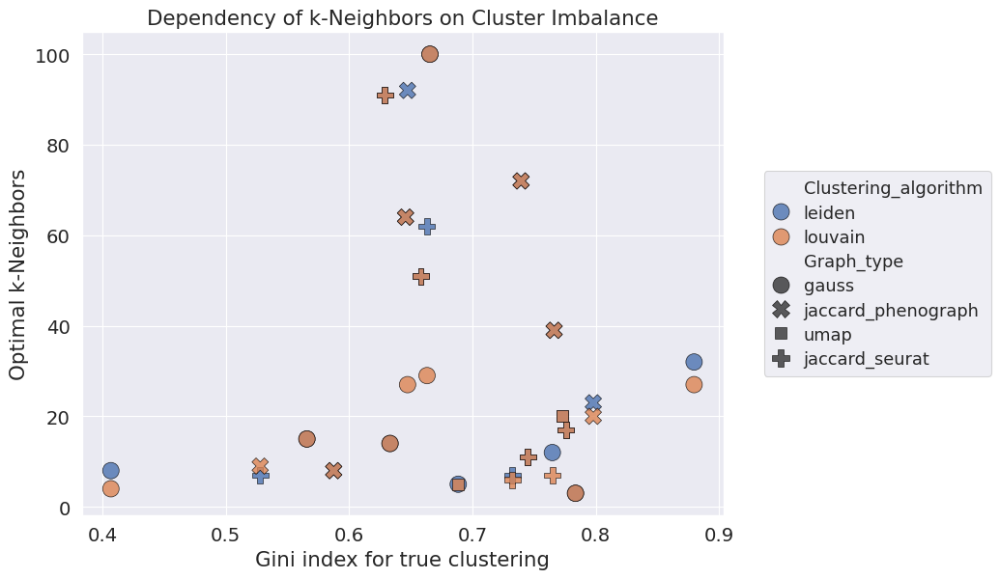

In [16]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size

# Bigger, more pronounced points
sns.scatterplot(
    data=best_comb_clust_no,
    x='Cluster_imbalance',
    y='K_Neighbors',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Graph_type',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5              # Thin outline
)

# Axis labels & title
plt.xlabel("Gini index for true clustering")
plt.ylabel("Optimal k-Neighbors")
plt.title("Dependency of k-Neighbors on Cluster Imbalance")

# Smaller, tidier legend
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    fontsize='small',          # Smaller legend text
    title_fontsize='small',
    borderpad=0.5,
    labelspacing=0.4,
    handlelength=1.0
)

plt.tight_layout()
plt.show()


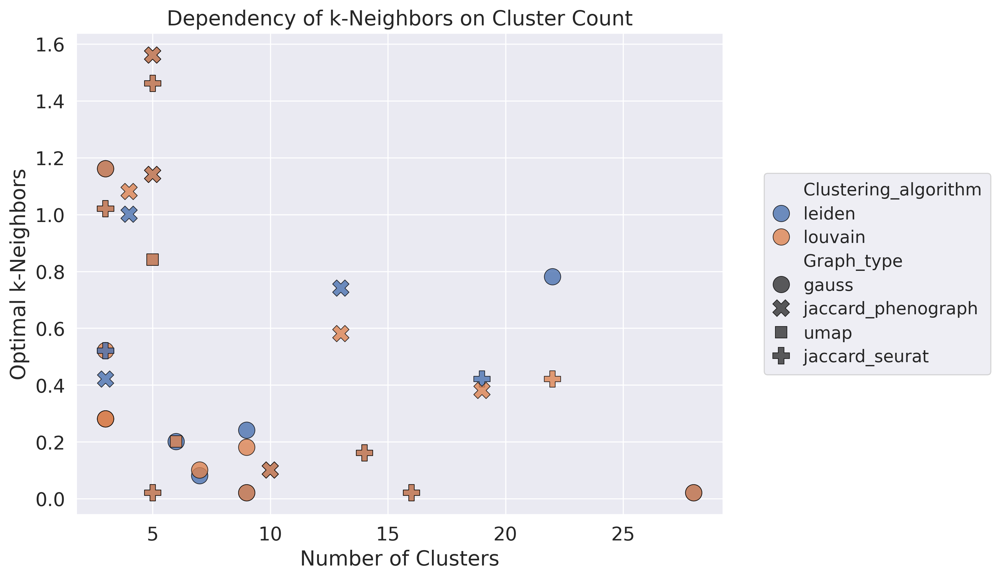

In [67]:

import seaborn as sns
import matplotlib.pyplot as plt

sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size

# Bigger, more pronounced points
sns.scatterplot(
    data=best_comb_clust_no,
    x='No_clusters',
    y='Resolution',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Graph_type',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5              # Thin outline
)

# Axis labels & title
plt.xlabel("Number of Clusters")
plt.ylabel("Optimal k-Neighbors")
plt.title("Dependency of k-Neighbors on Cluster Count")

# Smaller, tidier legend
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    fontsize='small',          # Smaller legend text
    title_fontsize='small',
    borderpad=0.5,
    labelspacing=0.4,
    handlelength=1.0
)

plt.tight_layout()
plt.show()


In [ ]:
sns.set_theme(rc={'figure.figsize': (10.7, 6.27)})
sns.set_context("paper", font_scale=1.6)  # Slightly lower to help with legend size

# Bigger, more pronounced points
sns.scatterplot(
    data=best_comb_clust_no,
    x='Dataset_size',
    y='K_Neighbors',
    alpha=0.8,
    hue='Clustering_algorithm', 
    style='Graph_type',
    s=150,                     # 🔥 Point size
    edgecolor='black',         # Optional: black outline for emphasis
    linewidth=0.5              # Thin outline
)

# Axis labels & title
plt.xlabel("Number of Cells in Dataset")
plt.ylabel("Optimal k-Neighbors")
plt.title("Dependency of k-Neighbors on Cell Count")

# Smaller, tidier legend
plt.legend(
    bbox_to_anchor=(1.05, 0.5),
    loc='center left',
    fontsize='small',          # Smaller legend text
    title_fontsize='small',
    borderpad=0.5,
    labelspacing=0.4,
    handlelength=1.0
)

plt.tight_layout()
plt.show()

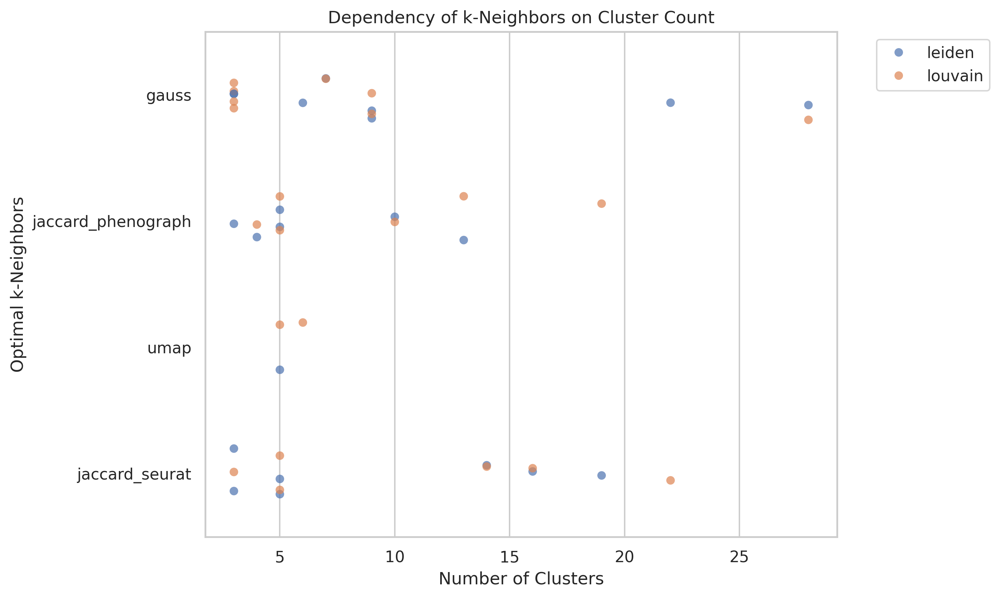

In [127]:
sns.set(style="whitegrid")
plt.figure(figsize=(10, 6))

sns.stripplot(
    data=best_comb_clust_no,
    x='No_clusters',
    y='Graph_type',
    jitter=0.2,
    size=6,
    alpha=0.7,
    hue='Clustering_algorithm',  # Optional: color by dataset
    dodge=False
)

plt.xlabel("Number of Clusters")
plt.ylabel("Optimal k-Neighbors")
plt.title("Dependency of k-Neighbors on Cluster Count")
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

## Heatmap for the best number of K, best graph method ('Gauss'), for one dataset (will be averaged over all datasets)

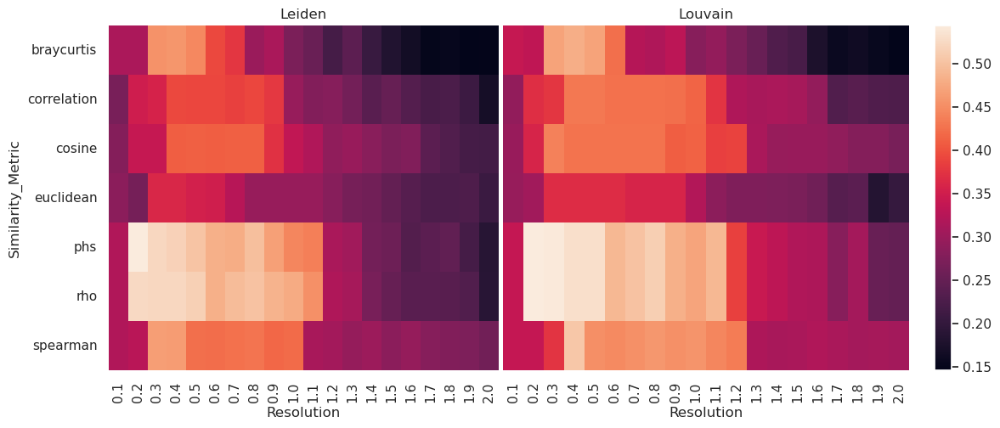

In [78]:
four_gauss_leiden=four_gauss[four_gauss['Clust_alg']=='leiden']
four_gauss_louvain=four_gauss[four_gauss['Clust_alg']=='louvain']
heatmap_data_1 = four_gauss_leiden.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_2 = four_gauss_louvain.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')


sns.set_theme(rc={'figure.figsize':(13.7,10.27)})

fig, (ax,ax2) = plt.subplots(ncols=2,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1, 1.3]})
fig.subplots_adjust(wspace=0.01)
sns.heatmap(heatmap_data_1, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_2, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
fig.colorbar(ax2.collections[0], ax=ax2,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Leiden')
ax2.set_ylabel('')
#ax2.yaxis.tick_right()
ax2.tick_params(rotation=90)
ax2.set_title('Louvain')
plt.show()

In [81]:
four_true_leid=four_true[four_true['Clust_alg']=='leiden']

In [82]:
four_true_leid

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
1809,RBConfigurationVertexPartition,0.1,spearman,4n_True,0.338456,Jung.h5ad,gauss,leiden
1810,RBConfigurationVertexPartition,0.2,spearman,4n_True,0.347159,Jung.h5ad,gauss,leiden
1811,RBConfigurationVertexPartition,0.3,spearman,4n_True,0.491872,Jung.h5ad,gauss,leiden
1812,RBConfigurationVertexPartition,0.4,spearman,4n_True,0.489315,Jung.h5ad,gauss,leiden
1813,RBConfigurationVertexPartition,0.5,spearman,4n_True,0.448163,Jung.h5ad,gauss,leiden
...,...,...,...,...,...,...,...,...
3492,RBConfigurationVertexPartition,1.6,euclidean,4n_True,0.252591,Jung.h5ad,umap,leiden
3493,RBConfigurationVertexPartition,1.7,euclidean,4n_True,0.250236,Jung.h5ad,umap,leiden
3494,RBConfigurationVertexPartition,1.8,euclidean,4n_True,0.227635,Jung.h5ad,umap,leiden
3495,RBConfigurationVertexPartition,1.9,euclidean,4n_True,0.211073,Jung.h5ad,umap,leiden


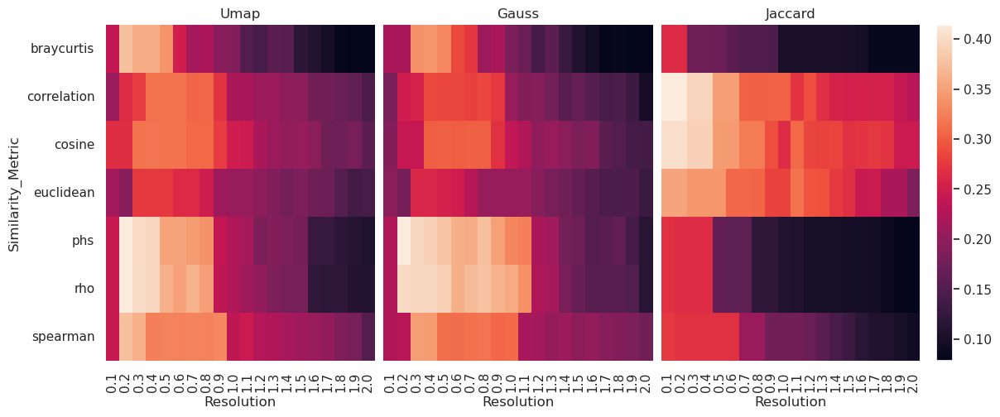

In [100]:
four_true_leid_u=four_true_leid[four_true_leid['Graph']=='umap']
four_true_leid_g=four_true_leid[four_true_leid['Graph']=='gauss']
four_true_leid_j=four_true_leid[four_true_leid['Graph']=='jaccard']
#four_gauss_louvain=four_gauss[four_gauss['Clust_alg']=='louvain']
heatmap_data_u = four_true_leid_u.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_g = four_true_leid_g.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_j = four_true_leid_j.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')


#sns.set_theme(rc={'figure.figsize':(1.7,10.27)})

fig, (ax,ax2,ax3) = plt.subplots(ncols=3,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1,1,1.2]})
fig.subplots_adjust(wspace=0.03)
sns.heatmap(heatmap_data_u, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_g, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
sns.heatmap(heatmap_data_j, cmap="rocket", ax=ax3, cbar=False,yticklabels=False)

fig.colorbar(ax3.collections[0], ax=ax3,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Umap')
ax2.set_title('Gauss')
ax3.set_title('Jaccard')

ax2.set_ylabel('')
ax3.set_ylabel('')
#ax2.yaxis.tick_right()
#ax.tick_params(rotation=90)
ax2.tick_params(rotation=90)

plt.show()

In [46]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics'
datasets_results=os.listdir(results_dir)

In [47]:
datasets_results

['Zheng',
 'Yan',
 'Goolam',
 'Biase',
 'Kolodziejczyk',
 'Tian',
 'Jung',
 'Koh',
 'Deng']

In [48]:
for data in datasets_results:
    for algorithm_clust in os.listdir(os.path.join(results_dir,data)):
        print(algorithm_clust)


Zheng.h5ad
Yan_RPKM.h5ad
Goolam.h5ad
Biase_fpkm.h5ad
Kolodziejczyk.h5ad
sce_sc_Dropseq_qc.h5ad
sce_sc_10x_5cl_qc.h5ad
sce_sc_10x_qc.h5ad
sc_Celseq2_5cl_p1.h5ad
sc_Celseq2_5cl_p3.h5ad
sc_Celseq2_5cl_p2.h5ad
sce_sc_CELseq2_qc.h5ad
Jung.h5ad
Koh_TPM.h5ad
Deng.h5ad


In [52]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for dataset in os.listdir(os.path.join(results_dir,data)):
        for algorithm_clust in os.listdir(os.path.join(results_dir,data,dataset)):
            for graph_con in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust)):
                for file in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con)):
                    df = pd.read_csv(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con,file), sep=",")
                    
                    ari_col=df['ar'].iloc[0:]
                    #print(df.iloc[1:,0].str.split('_').str[1]==0.2)
                        #resolution=df.iloc[0:,0].str.split('_').str[1]
                    resolution=df.iloc[0:,0].str.split('_').str[1]

                    quality_fun=df.iloc[0:,0].str.split('_').str[0]
                    similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                    if (k_value.split('_')[1]=='True'):
                        df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                    'K_Value': k_value, 'ari': ari_col,'Dataset':dataset, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                        dfs.append(df_extracted)
                    else: 
                        continue
            #dfs.append(df_extracted)
            #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]


In [53]:
result_df = pd.concat(dfs, ignore_index=True)


In [51]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,spearman,95n_True,0.223723,Zheng.h5ad,gauss,leiden
1,RBConfigurationVertexPartition,0.001,spearman,95n_True,0.000000,Zheng.h5ad,gauss,leiden
2,RBConfigurationVertexPartition,0.006,spearman,95n_True,0.749808,Zheng.h5ad,gauss,leiden
3,RBConfigurationVertexPartition,0.011,spearman,95n_True,0.749808,Zheng.h5ad,gauss,leiden
4,RBConfigurationVertexPartition,0.016,spearman,95n_True,0.749808,Zheng.h5ad,gauss,leiden
...,...,...,...,...,...,...,...,...
14411875,RBERVertexPartition,1.981,euclidean,25n_True,0.348073,Deng.h5ad,umap,leiden
14411876,RBERVertexPartition,1.986,euclidean,25n_True,0.348073,Deng.h5ad,umap,leiden
14411877,RBERVertexPartition,1.991,euclidean,25n_True,0.343575,Deng.h5ad,umap,leiden
14411878,RBERVertexPartition,1.996,euclidean,25n_True,0.343575,Deng.h5ad,umap,leiden


In [8]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,correlation,4n_True,0.362404,sce_sc_10x_qc.h5ad,umap,louvain
1,RBConfigurationVertexPartition,0.1,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
2,RBConfigurationVertexPartition,0.2,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
3,RBConfigurationVertexPartition,0.3,correlation,4n_True,0.783998,sce_sc_10x_qc.h5ad,umap,louvain
4,RBConfigurationVertexPartition,0.4,correlation,4n_True,0.509784,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
4759768,RBERVertexPartition,1.96,cosine,5n_True,0.255918,Jung.h5ad,umap,leiden
4759769,RBERVertexPartition,1.97,cosine,5n_True,0.248609,Jung.h5ad,umap,leiden
4759770,RBERVertexPartition,1.98,cosine,5n_True,0.253816,Jung.h5ad,umap,leiden
4759771,RBERVertexPartition,1.99,cosine,5n_True,0.253492,Jung.h5ad,umap,leiden


In [11]:
quality_f=result_df.groupby(['Quality_Fun'])['ari'].mean().reset_index()

In [12]:
quality_f

,Quality_Fun,ari
0,CPMVertexPartition,0.129050
1,ModularityVertexPartition,0.720108
2,RBConfigurationVertexPartition,0.692444
3,RBERVertexPartition,0.690801


In [139]:
pd.merge(result_df, quality_f, on=['Quality_Fun', 'ari'], how='inner')

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,CPMVertexPartition,0.1,spearman,5n_True,0.410905,sc_Celseq2_5cl_p2.h5ad,gauss,louvain
1,ModularityVertexPartition,NaN,euclidean,5n_True,0.961610,sc_Celseq2_5cl_p1.h5ad,gauss,leiden
2,RBConfigurationVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
3,RBConfigurationVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
4,RBConfigurationVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
5,RBConfigurationVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
6,RBConfigurationVertexPartition,0.5,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
7,RBERVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
8,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
9,RBERVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain


In [13]:
filtered_df = result_df[result_df['Quality_Fun'] == 'RBERVertexPartition']

# Sort the filtered DataFrame by 'ari' column in descending order
sorted_df = filtered_df.sort_values(by='ari', ascending=False)

# Extract the top 4 values of 'ari'
#top_4_ari_values = sorted_df['ari'].head(4)

sorted_df.head(15)

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
2631859,RBERVertexPartition,0.52,cosine,35n_True,1.0,sce_sc_CELseq2_qc.h5ad,jaccard,louvain
2725162,RBERVertexPartition,0.28,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725171,RBERVertexPartition,0.37,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725170,RBERVertexPartition,0.36,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725169,RBERVertexPartition,0.35,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725168,RBERVertexPartition,0.34,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725167,RBERVertexPartition,0.33,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725166,RBERVertexPartition,0.32,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725165,RBERVertexPartition,0.31,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2725164,RBERVertexPartition,0.3,spearman,25n_True,1.0,sce_sc_CELseq2_qc.h5ad,gauss,louvain


In [9]:
filtered_df = result_df[(result_df['Quality_Fun'] != 'CPMVertexPartition') & (result_df['Quality_Fun'] != 'ModularityVertexPartition')]

In [10]:
filt=filtered_df[(filtered_df['Resolution'] != '0.0')]

In [11]:
axis=np.unique(filt.Resolution)

In [12]:
axis

array(['0.01', '0.02', '0.03', '0.04', '0.05', '0.06', '0.07', '0.08',
       '0.09', '0.1', '0.11', '0.12', '0.13', '0.14', '0.15', '0.16',
       '0.17', '0.18', '0.19', '0.2', '0.21', '0.22', '0.23', '0.24',
       '0.25', '0.26', '0.27', '0.28', '0.29', '0.3', '0.31', '0.32',
       '0.33', '0.34', '0.35', '0.36', '0.37', '0.38', '0.39', '0.4',
       '0.41', '0.42', '0.43', '0.44', '0.45', '0.46', '0.47', '0.48',
       '0.49', '0.5', '0.51', '0.52', '0.53', '0.54', '0.55', '0.56',
       '0.57', '0.58', '0.59', '0.6', '0.61', '0.62', '0.63', '0.64',
       '0.65', '0.66', '0.67', '0.68', '0.69', '0.7', '0.71', '0.72',
       '0.73', '0.74', '0.75', '0.76', '0.77', '0.78', '0.79', '0.8',
       '0.81', '0.82', '0.83', '0.84', '0.85', '0.86', '0.87', '0.88',
       '0.89', '0.9', '0.91', '0.92', '0.93', '0.94', '0.95', '0.96',
       '0.97', '0.98', '0.99', '1.0', '1.01', '1.02', '1.03', '1.04',
       '1.05', '1.06', '1.07', '1.08', '1.09', '1.1', '1.11', '1.12',
       '1.13', '1

In [13]:
order=list(axis[4::5])

In [14]:
len(order)

40

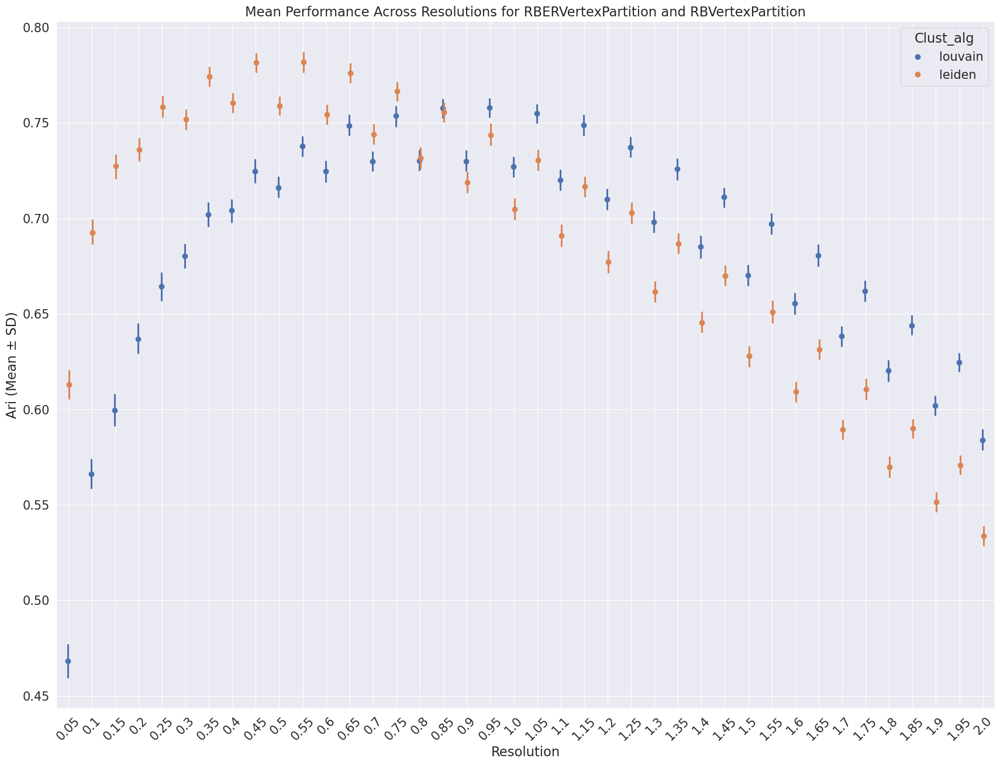

In [15]:
sns.set_theme(rc={'figure.figsize':(20.7,15.27)})
sns.set_context("paper", font_scale=1.7) 

plot=sns.pointplot(data=filt, x='Resolution', y='ari',hue='Clust_alg',
              dodge=True, estimator='mean',linestyle='none',order=order)
plt.xticks(rotation=45)
#plot.set_xticks(range(-20,20)) # <--- set the ticks first
#plot.set_xticklabels(list(axis[4::5]))

plt.xlabel('Resolution')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Resolutions for RBERVertexPartition and RBVertexPartition')
plt.grid(True)
#plt.setp(plot.get_xticklabels(), visible=False)
#plot.set_xticks(range(20)) 
  

plt.show()

In [16]:
filtered_cpm= result_df[(result_df['Quality_Fun'] == 'CPMVertexPartition')]

In [17]:
filtered_cpm

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
21,CPMVertexPartition,0.1,correlation,4n_True,0.035229,sce_sc_10x_qc.h5ad,umap,louvain
22,CPMVertexPartition,0.2,correlation,4n_True,0.019189,sce_sc_10x_qc.h5ad,umap,louvain
23,CPMVertexPartition,0.3,correlation,4n_True,0.014309,sce_sc_10x_qc.h5ad,umap,louvain
24,CPMVertexPartition,0.4,correlation,4n_True,0.010492,sce_sc_10x_qc.h5ad,umap,louvain
25,CPMVertexPartition,0.5,correlation,4n_True,0.007622,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
4759567,CPMVertexPartition,1.96,cosine,5n_True,0.000000,Jung.h5ad,umap,leiden
4759568,CPMVertexPartition,1.97,cosine,5n_True,0.000000,Jung.h5ad,umap,leiden
4759569,CPMVertexPartition,1.98,cosine,5n_True,0.000000,Jung.h5ad,umap,leiden
4759570,CPMVertexPartition,1.99,cosine,5n_True,0.000000,Jung.h5ad,umap,leiden


In [20]:
list(np.unique(filtered_cpm.Resolution)[1:20])

['0.01',
 '0.02',
 '0.03',
 '0.04',
 '0.05',
 '0.06',
 '0.07',
 '0.08',
 '0.09',
 '0.1',
 '0.11',
 '0.12',
 '0.13',
 '0.14',
 '0.15',
 '0.16',
 '0.17',
 '0.18',
 '0.19']

In [23]:
order=list(np.unique(filtered_cpm.Resolution)[1:30])

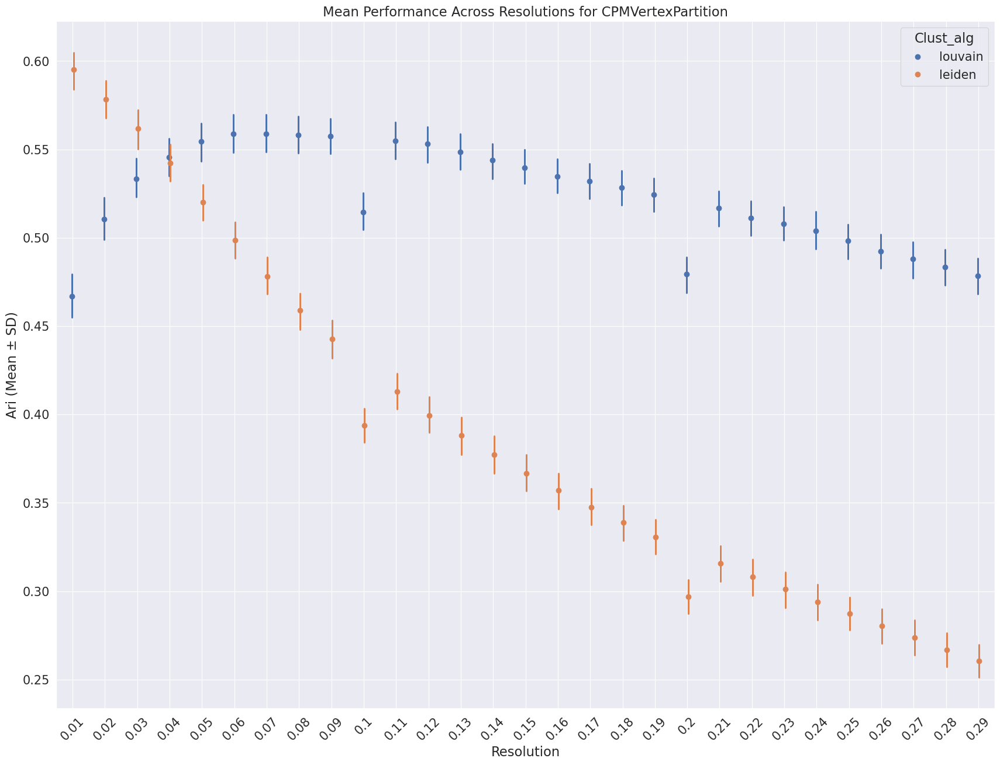

In [24]:
sns.set_theme(rc={'figure.figsize':(20.7,15.27)})
sns.set_context("paper", font_scale=1.7) 

plot=sns.pointplot(data=filtered_cpm, x='Resolution', y='ari',hue='Clust_alg',
              dodge=True, estimator='mean',linestyle='none',order=order)
plt.xticks(rotation=45)
#plot.set_xticks(range(-20,20)) # <--- set the ticks first
#plot.set_xticklabels(list(axis[4::5]))

plt.xlabel('Resolution')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Resolutions for CPMVertexPartition')
plt.grid(True)
#plt.setp(plot.get_xticklabels(), visible=False)
#plot.set_xticks(range(20)) 
  

plt.show()

In [59]:
result_df[result_df['Dataset']].str.split('_',expand=True)[0]

KeyError: "None of [Index(['Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad',\n       'Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad', 'Zheng.h5ad',\n       ...\n       'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad',\n       'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad', 'Deng.h5ad'],\n      dtype='object', length=14411880)] are in the [columns]"

In [72]:
result_df['Dataset'] = result_df['Dataset'].str.split('.', expand= True)[0]

In [73]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,spearman,95n_True,0.223723,Zheng,gauss,leiden
1,RBConfigurationVertexPartition,0.001,spearman,95n_True,0.000000,Zheng,gauss,leiden
2,RBConfigurationVertexPartition,0.006,spearman,95n_True,0.749808,Zheng,gauss,leiden
3,RBConfigurationVertexPartition,0.011,spearman,95n_True,0.749808,Zheng,gauss,leiden
4,RBConfigurationVertexPartition,0.016,spearman,95n_True,0.749808,Zheng,gauss,leiden
...,...,...,...,...,...,...,...,...
14411875,RBERVertexPartition,1.981,euclidean,25n_True,0.348073,Deng,umap,leiden
14411876,RBERVertexPartition,1.986,euclidean,25n_True,0.348073,Deng,umap,leiden
14411877,RBERVertexPartition,1.991,euclidean,25n_True,0.343575,Deng,umap,leiden
14411878,RBERVertexPartition,1.996,euclidean,25n_True,0.343575,Deng,umap,leiden


/tmp/ipykernel_1612/1037278630.py:3: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data=result_df, x='Dataset', y='ari',hue='Clust_alg',


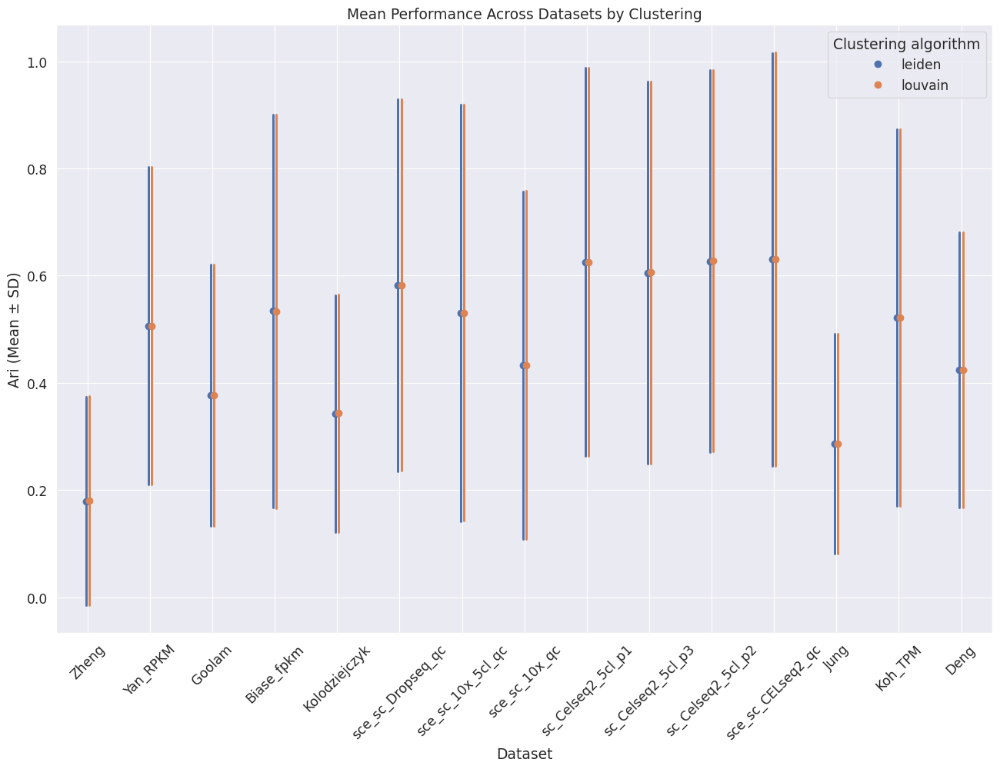

In [75]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.4) 
sns.pointplot(data=result_df, x='Dataset', y='ari',hue='Clust_alg',
              dodge=True, errorbar='sd',join=False)
plt.xticks(rotation=45)

plt.xlabel('Dataset')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Datasets by Clustering')
plt.legend(title='Clustering algorithm', loc='upper right')
plt.grid(True)
plt.show()

In [21]:
plot.get_xticklabels()

[Text(0, 0, '0.1'),
 Text(10, 0, '1.1'),
 Text(20, 0, '0.0'),
 Text(30, 0, '0.11'),
 Text(40, 0, '0.22'),
 Text(50, 0, '0.33'),
 Text(60, 0, '0.44'),
 Text(70, 0, '0.55'),
 Text(80, 0, '0.66'),
 Text(90, 0, '0.77'),
 Text(100, 0, '0.88'),
 Text(110, 0, '0.99'),
 Text(120, 0, '1.11'),
 Text(130, 0, '1.22'),
 Text(140, 0, '1.33'),
 Text(150, 0, '1.44'),
 Text(160, 0, '1.55'),
 Text(170, 0, '1.66'),
 Text(180, 0, '1.77'),
 Text(190, 0, '1.88'),
 Text(200, 0, '1.99')]

In [78]:
max_ari=result_df.groupby(['K_Value'])['ari'].max().reset_index()

In [79]:
max_ari

,K_Value,ari
0,3n_True,0.988560
1,4n_True,0.988560
2,5n_True,0.990401


In [21]:
result_df.groupby(['Graph'])['ari'].max().reset_index()

,Graph,ari
0,gauss,0.990401
1,jaccard,0.971975
2,umap,0.990401


In [ ]:
result_df.groupby(['Graph'])['ari'].max().reset_index()

In [11]:
filtered_rows = pd.merge(result_df, max_ari, on=['K_Value', 'ari'], how='inner')

All of this achieved for an "easy" dataset, so not very informative:

In [12]:
filtered_rows

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,RBConfigurationVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
1,RBConfigurationVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
2,RBConfigurationVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
3,RBConfigurationVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
4,RBConfigurationVertexPartition,0.5,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
5,RBERVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
6,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
7,RBERVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
8,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
9,RBERVertexPartition,0.5,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain


## Filtering out CPMVertexPartition for now, because resolution range needs to be changed to perform informative analysis

In [162]:
filtered=result_df[(result_df['Quality_Fun']!='CPMVertexPartition')&(result_df['Similarity_Metric']!='manhattan')]

/tmp/ipykernel_696/2331112637.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=filtered, x='Dataset', y='ari',hue='Clust_alg',
/tmp/ipykernel_696/2331112637.py:3: UserWarning: 

The `join` parameter is deprecated and will be removed in v0.15.0. You can remove the line between points with `linestyle='none'`.

  sns.pointplot(data=filtered, x='Dataset', y='ari',hue='Clust_alg',
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a

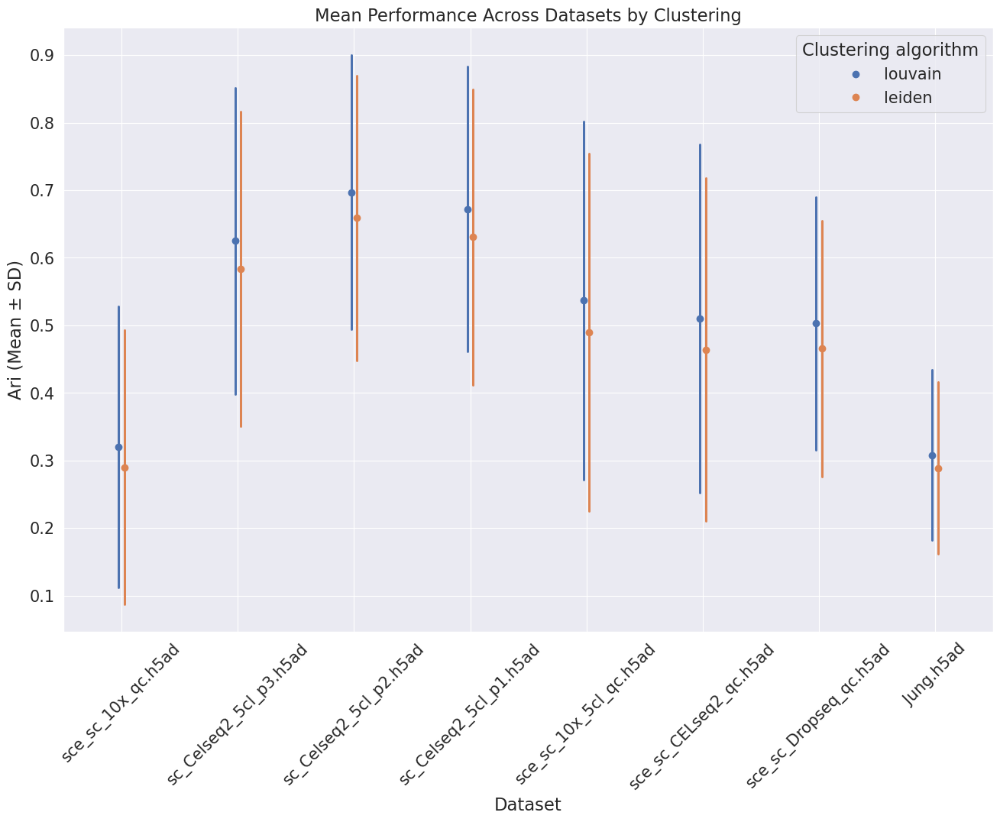

In [114]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=filtered, x='Dataset', y='ari',hue='Clust_alg',
              dodge=True, ci='sd',join=False)
plt.xticks(rotation=45)

plt.xlabel('Dataset')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Datasets by Clustering')
plt.legend(title='Clustering algorithm', loc='upper right')
plt.grid(True)
plt.show()

In [115]:
to_plot=filtered.groupby(['Quality_Fun','Resolution','Similarity_Metric','Graph','Clust_alg'])['ari'].mean().reset_index()

In [116]:
to_plot

,Quality_Fun,Resolution,Similarity_Metric,Graph,Clust_alg,ari
0,RBConfigurationVertexPartition,0.1,braycurtis,gauss,leiden,0.830730
1,RBConfigurationVertexPartition,0.1,braycurtis,gauss,louvain,0.824394
2,RBConfigurationVertexPartition,0.1,braycurtis,jaccard,leiden,0.652044
3,RBConfigurationVertexPartition,0.1,braycurtis,jaccard,louvain,0.688536
4,RBConfigurationVertexPartition,0.1,braycurtis,umap,leiden,0.822490
...,...,...,...,...,...,...
1675,RBERVertexPartition,2.0,spearman,gauss,louvain,0.424992
1676,RBERVertexPartition,2.0,spearman,jaccard,leiden,0.195162
1677,RBERVertexPartition,2.0,spearman,jaccard,louvain,0.244257
1678,RBERVertexPartition,2.0,spearman,umap,leiden,0.369782


/tmp/ipykernel_696/4199977114.py:16: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sn=sns.catplot(data=to_plot, x='Resolution', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)


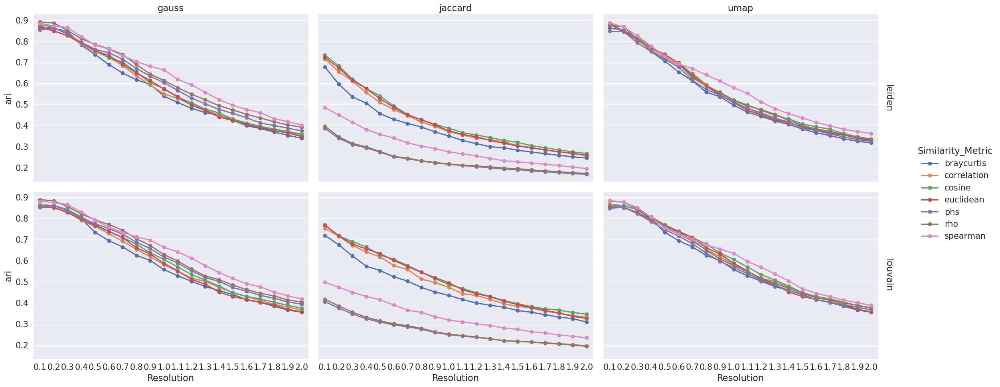

In [118]:
#sns.set(font_scale=1)
#sns.set(rc={'figure.figsize':(12.7,9.27)})
#sn=sns.catplot(data=k_four_rb, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', aspect=1.5)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
#plt.show()



#sns.set_theme(font_scale=10)
sns.set_theme(rc={'figure.figsize':(13.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
#sns.set_context("paper", rc={"font.size":10,"axes.titlesize":10,"axes.labelsize":5})   

sn=sns.catplot(data=to_plot, x='Resolution', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
sn.set_titles(row_template='{row_name}',col_template='{col_name}')
#plt.show()

In [151]:
to_plot=filtered.groupby(['Quality_Fun','K_Value','Similarity_Metric','Graph','Clust_alg'])['ari'].mean().reset_index()

In [40]:
k_s=[]
for element in result_df.K_Value.values:
    k_s.append(element.split('n')[0])

In [65]:
result_df['K_Value'] = result_df['K_Value'].apply(lambda x: x.split('n')[0])
result_df['K_Value'] = pd.to_numeric(result_df['K_Value'], errors='coerce')


In [66]:
k_s=result_df.K_Value.values

In [67]:
k_s

array([4, 4, 4, ..., 5, 5, 5])

In [62]:
test_list = [int(i) for i in k_s]


In [68]:
order=np.unique(k_s)

In [69]:
order

array([  3,   4,   5,  10,  15,  20,  25,  30,  35,  40,  45,  50,  55,
        60,  65,  70,  75,  80,  85,  90,  95, 100])

/tmp/ipykernel_152298/2972139611.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sn=sns.catplot(data=result_df, x='K_Value', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=3, aspect=1.5,margin_titles=True,ci=None,order=list(order))


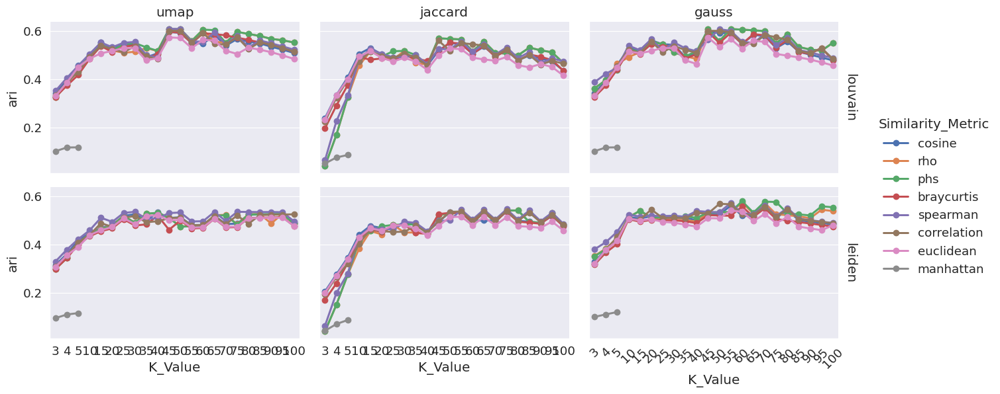

In [72]:
#sns.set_theme(font_scale=10)
sns.set_theme(rc={'figure.figsize':(13.7,10.27)})
sns.set_context("paper", font_scale=1.5) 
#sns.set_context("paper", rc={"font.size":10,"axes.titlesize":10,"axes.labelsize":5})   

sn=sns.catplot(data=result_df, x='K_Value', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=3, aspect=1.5,margin_titles=True,ci=None,order=list(order))
plt.xticks(rotation=45)

#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
sn.set_titles(row_template='{row_name}',col_template='{col_name}')
plt.show()

In [156]:
filtered

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,correlation,4n_True,0.362404,sce_sc_10x_qc.h5ad,umap,louvain
1,RBConfigurationVertexPartition,0.1,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
2,RBConfigurationVertexPartition,0.2,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
3,RBConfigurationVertexPartition,0.3,correlation,4n_True,0.783998,sce_sc_10x_qc.h5ad,umap,louvain
4,RBConfigurationVertexPartition,0.4,correlation,4n_True,0.509784,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
58153,RBConfigurationVertexPartition,1.6,cosine,5n_True,0.282997,Jung.h5ad,umap,leiden
58154,RBConfigurationVertexPartition,1.7,cosine,5n_True,0.284477,Jung.h5ad,umap,leiden
58155,RBConfigurationVertexPartition,1.8,cosine,5n_True,0.270926,Jung.h5ad,umap,leiden
58156,RBConfigurationVertexPartition,1.9,cosine,5n_True,0.254384,Jung.h5ad,umap,leiden


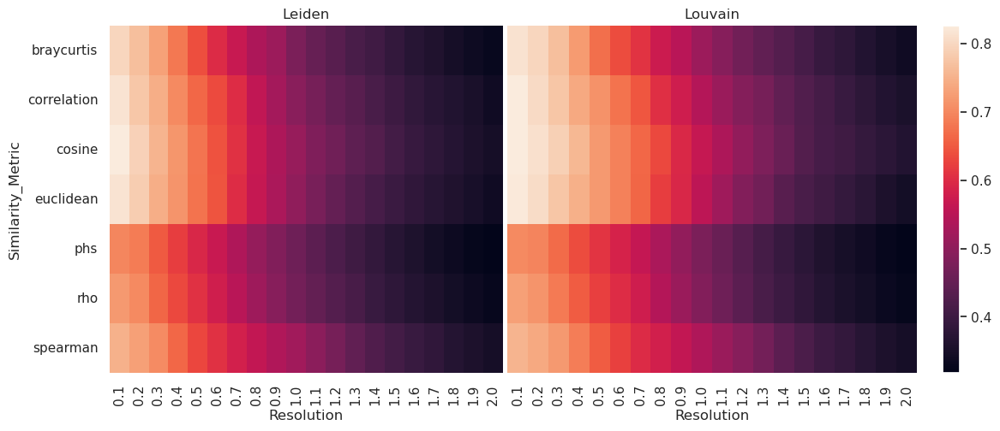

In [155]:
filtered_leiden=filtered[filtered['Clust_alg']=='leiden']
filtered_louvain=filtered[filtered['Clust_alg']=='louvain']
heatmap_data_1 = filtered_leiden.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_2 = filtered_louvain.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')


sns.set_theme(rc={'figure.figsize':(13.7,10.27)})

fig, (ax,ax2) = plt.subplots(ncols=2,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1, 1.3]})
fig.subplots_adjust(wspace=0.01)
sns.heatmap(heatmap_data_1, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_2, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
fig.colorbar(ax2.collections[0], ax=ax2,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Leiden')
ax2.set_ylabel('')
#ax2.yaxis.tick_right()
ax2.tick_params(rotation=90)
ax2.set_title('Louvain')
plt.show()

In [172]:
filtered_knn=filtered[filtered['Graph']!='jaccard']

In [175]:
filtered_knn_jung=filtered_knn[filtered_knn['Dataset']=='Jung.h5ad']

/tmp/ipykernel_696/2315146768.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  filtered_leiden_knn=filtered_knn_jung[filtered_knn['Clust_alg']=='leiden']
/tmp/ipykernel_696/2315146768.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  filtered_louvain_knn=filtered_knn_jung[filtered_knn['Clust_alg']=='louvain']


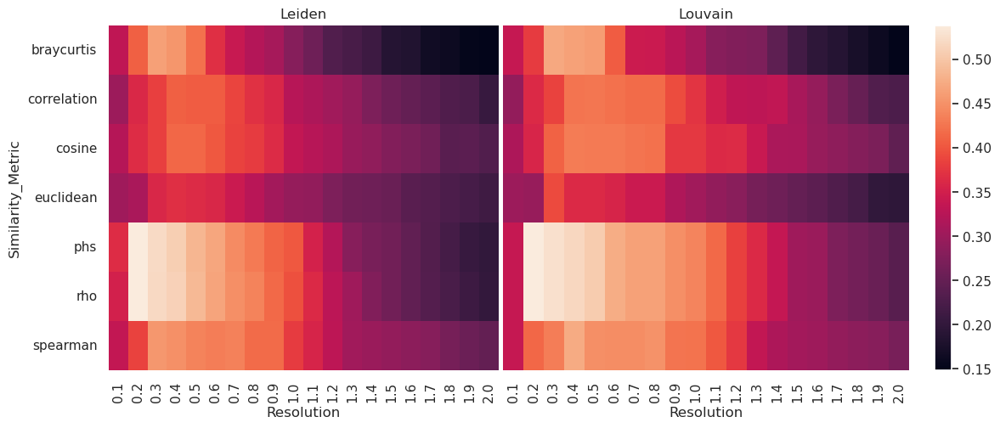

In [176]:
filtered_leiden_knn=filtered_knn_jung[filtered_knn['Clust_alg']=='leiden']
filtered_louvain_knn=filtered_knn_jung[filtered_knn['Clust_alg']=='louvain']
heatmap_data_1 = filtered_leiden_knn.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_2 = filtered_louvain_knn.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')


sns.set_theme(rc={'figure.figsize':(13.7,10.27)})

fig, (ax,ax2) = plt.subplots(ncols=2,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1, 1.3]})
fig.subplots_adjust(wspace=0.01)
sns.heatmap(heatmap_data_1, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_2, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
fig.colorbar(ax2.collections[0], ax=ax2,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Leiden')
ax2.set_ylabel('')
#ax2.yaxis.tick_right()
ax2.tick_params(rotation=90)
ax2.set_title('Louvain')
plt.show()

In [178]:
filtered

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,correlation,4n_True,0.362404,sce_sc_10x_qc.h5ad,umap,louvain
1,RBConfigurationVertexPartition,0.1,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
2,RBConfigurationVertexPartition,0.2,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
3,RBConfigurationVertexPartition,0.3,correlation,4n_True,0.783998,sce_sc_10x_qc.h5ad,umap,louvain
4,RBConfigurationVertexPartition,0.4,correlation,4n_True,0.509784,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
58891,RBConfigurationVertexPartition,1.6,cosine,5n_True,0.282997,Jung.h5ad,umap,leiden
58892,RBConfigurationVertexPartition,1.7,cosine,5n_True,0.284477,Jung.h5ad,umap,leiden
58893,RBConfigurationVertexPartition,1.8,cosine,5n_True,0.270926,Jung.h5ad,umap,leiden
58894,RBConfigurationVertexPartition,1.9,cosine,5n_True,0.254384,Jung.h5ad,umap,leiden


In [179]:
filtered_lei=filtered[filtered['Clust_alg']=='louvain']

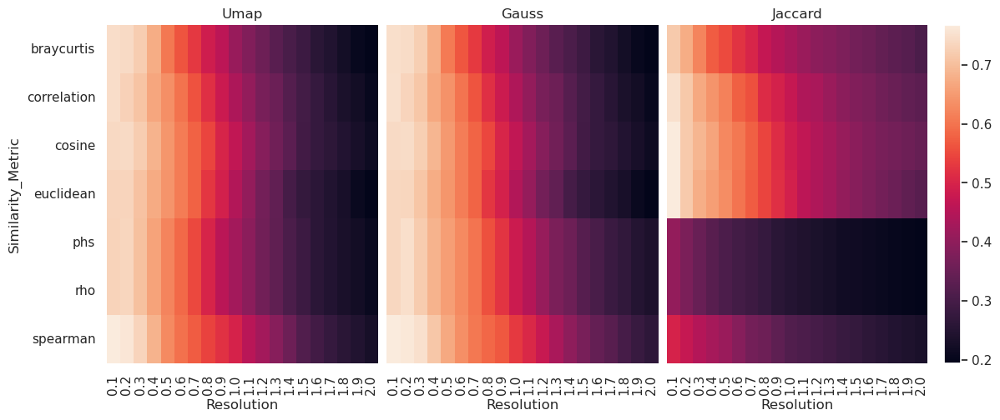

In [180]:
four_true_leid_u=filtered_lei[filtered_lei['Graph']=='umap']
four_true_leid_g=filtered_lei[filtered_lei['Graph']=='gauss']
four_true_leid_j=filtered_lei[filtered_lei['Graph']=='jaccard']
#four_gauss_louvain=four_gauss[four_gauss['Clust_alg']=='louvain']
heatmap_data_u = four_true_leid_u.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_g = four_true_leid_g.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')
heatmap_data_j = four_true_leid_j.pivot_table(index='Similarity_Metric', columns=['Resolution'], values='ari', aggfunc='mean')


#sns.set_theme(rc={'figure.figsize':(1.7,10.27)})

fig, (ax,ax2,ax3) = plt.subplots(ncols=3,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1,1,1.2]})
fig.subplots_adjust(wspace=0.03)

sns.heatmap(heatmap_data_u, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_g, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
sns.heatmap(heatmap_data_j, cmap="rocket", ax=ax3, cbar=False,yticklabels=False)

fig.colorbar(ax3.collections[0], ax=ax3,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Umap')
ax2.set_title('Gauss')
ax3.set_title('Jaccard')

ax2.set_ylabel('')
ax3.set_ylabel('')
#ax2.yaxis.tick_right()
#ax.tick_params(rotation=90)
ax2.tick_params(rotation=90)

plt.show()

## The same for separate datasets

In [145]:
filtered_jung=result_df[(result_df['Dataset']=='Jung.h5ad')&(result_df['Similarity_Metric']!='manhattan')&(result_df['Quality_Fun']!='CPMVertexPartition')]

In [147]:
filtered_jung

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
53802,RBConfigurationVertexPartition,0.1,correlation,5n_True,0.380269,Jung.h5ad,jaccard,louvain
53803,RBConfigurationVertexPartition,0.2,correlation,5n_True,0.374450,Jung.h5ad,jaccard,louvain
53804,RBConfigurationVertexPartition,0.3,correlation,5n_True,0.412862,Jung.h5ad,jaccard,louvain
53805,RBConfigurationVertexPartition,0.4,correlation,5n_True,0.412862,Jung.h5ad,jaccard,louvain
53806,RBConfigurationVertexPartition,0.5,correlation,5n_True,0.412862,Jung.h5ad,jaccard,louvain
...,...,...,...,...,...,...,...,...
58891,RBConfigurationVertexPartition,1.6,cosine,5n_True,0.282997,Jung.h5ad,umap,leiden
58892,RBConfigurationVertexPartition,1.7,cosine,5n_True,0.284477,Jung.h5ad,umap,leiden
58893,RBConfigurationVertexPartition,1.8,cosine,5n_True,0.270926,Jung.h5ad,umap,leiden
58894,RBConfigurationVertexPartition,1.9,cosine,5n_True,0.254384,Jung.h5ad,umap,leiden


In [148]:
np.unique(filtered_jung['Quality_Fun'])

array(['ModularityVertexPartition', 'RBConfigurationVertexPartition',
       'RBERVertexPartition'], dtype=object)

In [149]:
to_plot=filtered_jung.groupby(['Quality_Fun','Resolution','Similarity_Metric','Graph','Clust_alg'])['ari'].mean().reset_index()

/tmp/ipykernel_696/4199977114.py:16: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sn=sns.catplot(data=to_plot, x='Resolution', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)


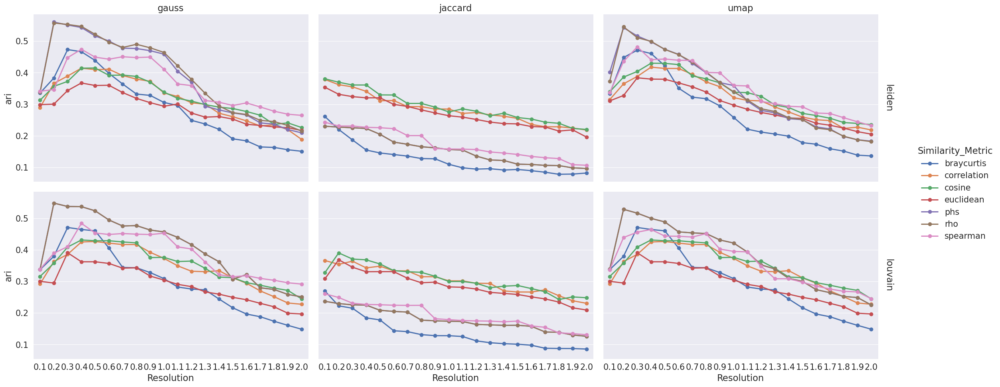

In [150]:
#sns.set(font_scale=1)
#sns.set(rc={'figure.figsize':(12.7,9.27)})
#sn=sns.catplot(data=k_four_rb, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', aspect=1.5)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
#plt.show()



#sns.set_theme(font_scale=10)
sns.set_theme(rc={'figure.figsize':(13.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
#sns.set_context("paper", rc={"font.size":10,"axes.titlesize":10,"axes.labelsize":5})   

sn=sns.catplot(data=to_plot, x='Resolution', y='ari', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
sn.set_titles(row_template='{row_name}',col_template='{col_name}')
#plt.show()

In [17]:
four_kn

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
1,RBConfigurationVertexPartition,0.1,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
2,RBConfigurationVertexPartition,0.2,correlation,4n_True,0.856025,sce_sc_10x_qc.h5ad,umap,louvain
3,RBConfigurationVertexPartition,0.3,correlation,4n_True,0.783998,sce_sc_10x_qc.h5ad,umap,louvain
4,RBConfigurationVertexPartition,0.4,correlation,4n_True,0.509784,sce_sc_10x_qc.h5ad,umap,louvain
5,RBConfigurationVertexPartition,0.5,correlation,4n_True,0.443577,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
57335,RBConfigurationVertexPartition,1.6,manhattan,4n_True,0.112773,Jung.h5ad,umap,leiden
57336,RBConfigurationVertexPartition,1.7,manhattan,4n_True,0.118634,Jung.h5ad,umap,leiden
57337,RBConfigurationVertexPartition,1.8,manhattan,4n_True,0.116320,Jung.h5ad,umap,leiden
57338,RBConfigurationVertexPartition,1.9,manhattan,4n_True,0.113934,Jung.h5ad,umap,leiden


In [71]:
four_kn['Dataset'] = four_kn['Dataset'].str.replace('.h5ad', '')


/tmp/ipykernel_40444/2677485173.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  four_kn['Dataset'] = four_kn['Dataset'].str.replace('.h5ad', '')


In [72]:
four_kn

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
1,RBConfigurationVertexPartition,0.1,correlation,4n_True,0.856025,sce_sc_10x_qc,umap,louvain
2,RBConfigurationVertexPartition,0.2,correlation,4n_True,0.856025,sce_sc_10x_qc,umap,louvain
3,RBConfigurationVertexPartition,0.3,correlation,4n_True,0.783998,sce_sc_10x_qc,umap,louvain
4,RBConfigurationVertexPartition,0.4,correlation,4n_True,0.509784,sce_sc_10x_qc,umap,louvain
5,RBConfigurationVertexPartition,0.5,correlation,4n_True,0.443577,sce_sc_10x_qc,umap,louvain
...,...,...,...,...,...,...,...,...
57335,RBConfigurationVertexPartition,1.6,manhattan,4n_True,0.112773,Jung,umap,leiden
57336,RBConfigurationVertexPartition,1.7,manhattan,4n_True,0.118634,Jung,umap,leiden
57337,RBConfigurationVertexPartition,1.8,manhattan,4n_True,0.116320,Jung,umap,leiden
57338,RBConfigurationVertexPartition,1.9,manhattan,4n_True,0.113934,Jung,umap,leiden


In [22]:
jung=four_kn[four_kn['Dataset']=='Jung']

/tmp/ipykernel_40444/3827754557.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=res, x='Dataset', y='ari',hue='Clust_alg',
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


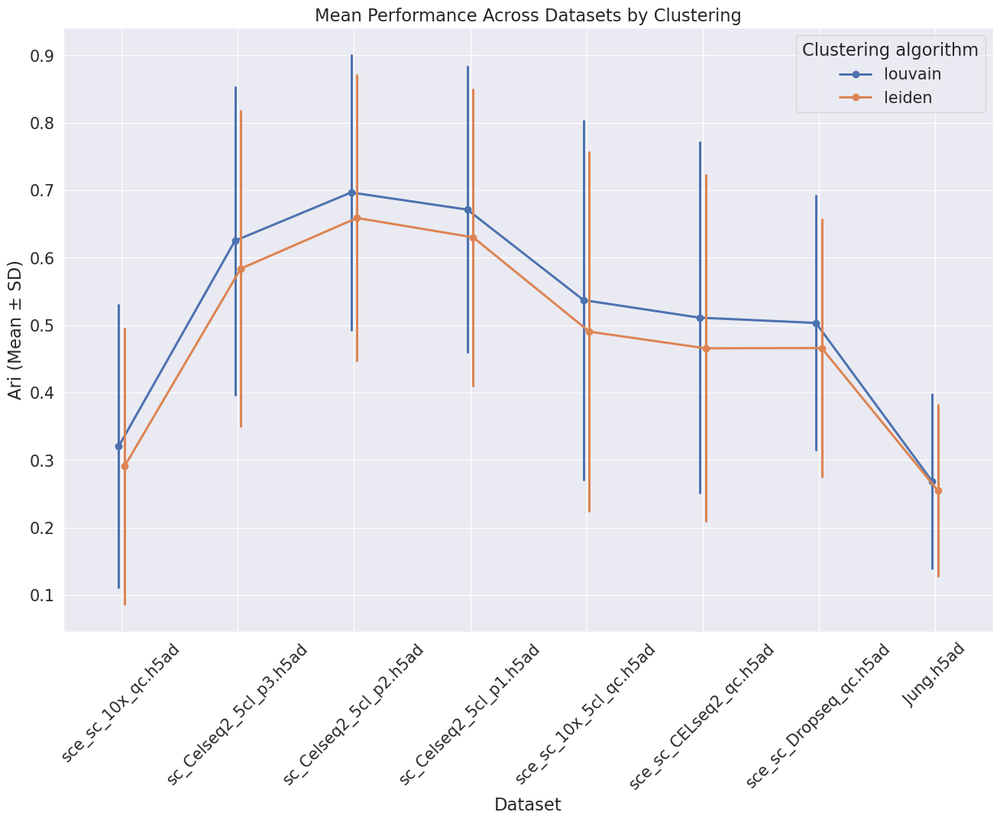

In [73]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=res, x='Dataset', y='ari',hue='Clust_alg',
              dodge=True, ci='sd')
plt.xticks(rotation=45)

plt.xlabel('Dataset')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Datasets by Clustering')
plt.legend(title='Clustering algorithm', loc='upper right')
plt.grid(True)
plt.show()

In [74]:
louv=res[(res['Similarity_Metric']=='rho')&(res['Graph']=='gauss')&(res['Resolution']=='0.2')]

In [75]:
louv

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
3052,RBConfigurationVertexPartition,0.2,rho,5n_True,0.855222,sce_sc_10x_qc.h5ad,gauss,louvain
3092,RBERVertexPartition,0.2,rho,5n_True,0.855222,sce_sc_10x_qc.h5ad,gauss,louvain
3540,RBConfigurationVertexPartition,0.2,rho,3n_True,0.855222,sce_sc_10x_qc.h5ad,gauss,louvain
3580,RBERVertexPartition,0.2,rho,3n_True,0.852634,sce_sc_10x_qc.h5ad,gauss,louvain
3723,RBConfigurationVertexPartition,0.2,rho,4n_True,0.855222,sce_sc_10x_qc.h5ad,gauss,louvain
...,...,...,...,...,...,...,...,...
54647,RBConfigurationVertexPartition,0.2,rho,3n_True,0.548290,Jung.h5ad,gauss,louvain
54969,RBConfigurationVertexPartition,0.2,rho,5n_True,0.538529,Jung.h5ad,gauss,louvain
55672,RBConfigurationVertexPartition,0.2,rho,4n_True,0.553211,Jung.h5ad,gauss,leiden
56014,RBConfigurationVertexPartition,0.2,rho,3n_True,0.553759,Jung.h5ad,gauss,leiden


/tmp/ipykernel_40444/3086254670.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.pointplot(data=louv, x='Dataset', y='ari',hue='Clust_alg',
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


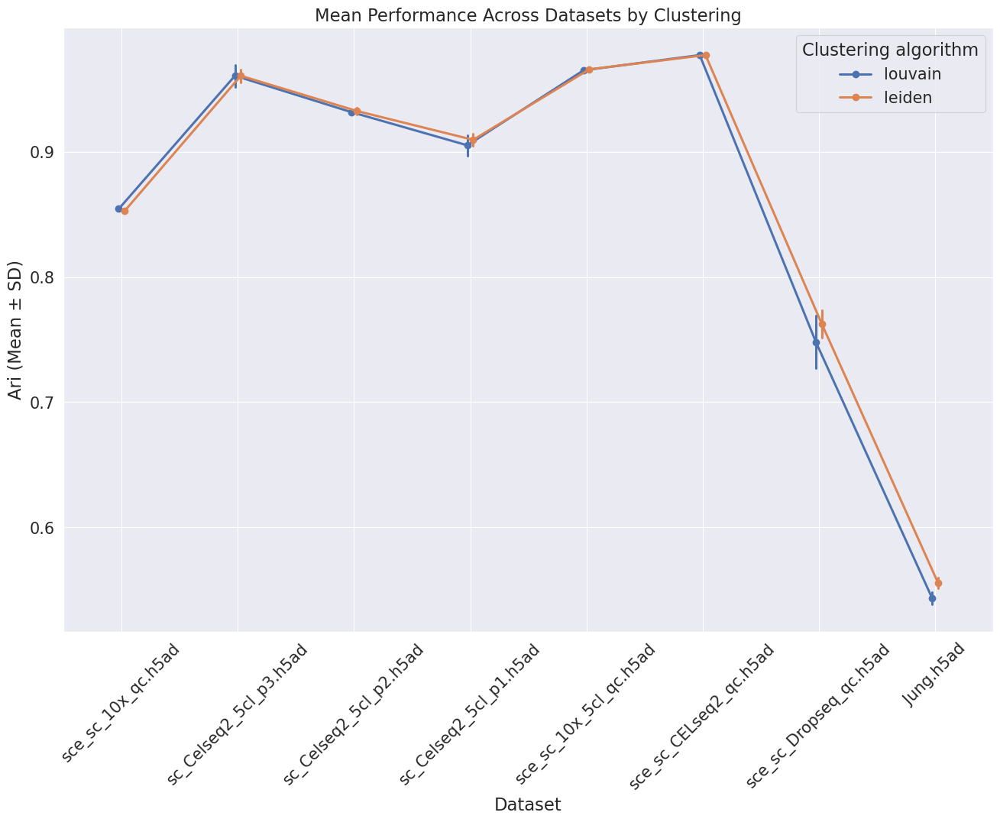

In [76]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=louv, x='Dataset', y='ari',hue='Clust_alg',
              dodge=True, ci='sd')
plt.xticks(rotation=45)

plt.xlabel('Dataset')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Datasets by Clustering')
plt.legend(title='Clustering algorithm', loc='upper right')
plt.grid(True)
plt.show()

## Choosing the best combination

In [208]:
result=result_df[result_df['Quality_Fun']!='CPMVertexPartition']

In [188]:
sorted=result_df.sort_values('ari',ascending=False)

In [191]:
sorted[:30]

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
43535,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,leiden
43537,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,leiden
40018,RBConfigurationVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
40019,RBConfigurationVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
40020,RBConfigurationVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
40021,RBConfigurationVertexPartition,0.5,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
41522,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain
43536,RBERVertexPartition,0.3,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,leiden
41482,RBConfigurationVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain
41481,RBConfigurationVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain


In [216]:
df_k_q_r=result_df.loc[(result_df.K_Value=='5n_True') & (result_df.Quality_Fun=='RBERVertexPartition') & (result_df.Resolution=='0.2')]

In [221]:
df_k_q_r.loc[df_k_q_r['Dataset']=='Jung.h5ad']

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
53864,RBERVertexPartition,0.2,phs,5n_True,0.373501,Jung.h5ad,jaccard,louvain
54107,RBERVertexPartition,0.2,manhattan,5n_True,0.124711,Jung.h5ad,jaccard,louvain
54410,RBERVertexPartition,0.2,rho,5n_True,0.373501,Jung.h5ad,jaccard,louvain
54753,RBERVertexPartition,0.2,manhattan,5n_True,0.206473,Jung.h5ad,gauss,louvain
54834,RBERVertexPartition,0.2,phs,5n_True,0.557162,Jung.h5ad,gauss,louvain
55461,RBERVertexPartition,0.2,rho,5n_True,0.557162,Jung.h5ad,gauss,louvain
55623,RBERVertexPartition,0.2,rho,5n_True,0.533557,Jung.h5ad,umap,louvain
55805,RBERVertexPartition,0.2,manhattan,5n_True,0.206473,Jung.h5ad,umap,louvain
56088,RBERVertexPartition,0.2,phs,5n_True,0.533557,Jung.h5ad,umap,louvain
56573,RBERVertexPartition,0.2,manhattan,5n_True,0.209587,Jung.h5ad,gauss,leiden


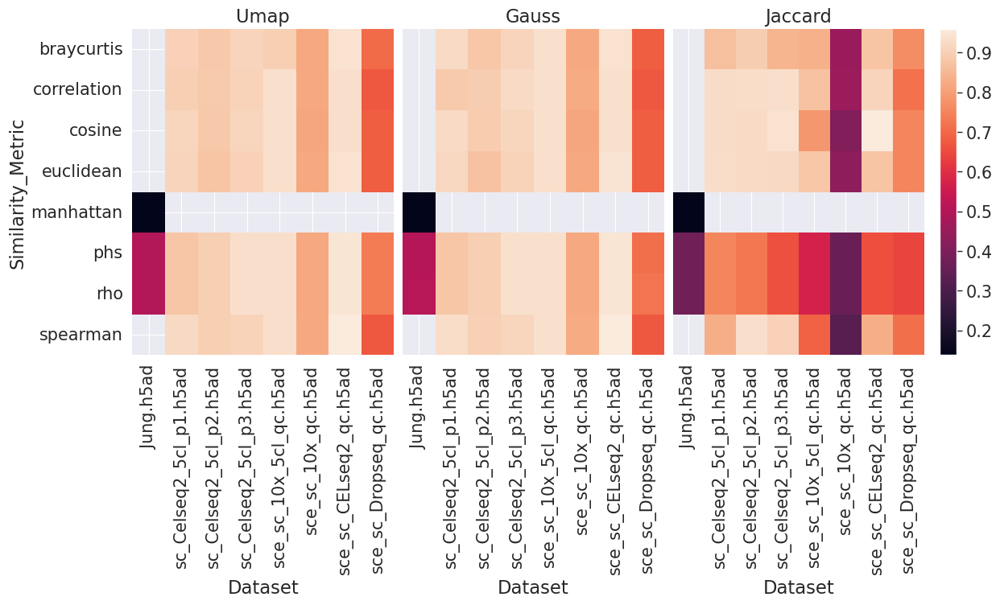

In [218]:
four_true_leid_u=df_k_q_r[df_k_q_r['Graph']=='umap']
four_true_leid_g=df_k_q_r[df_k_q_r['Graph']=='gauss']
four_true_leid_j=df_k_q_r[df_k_q_r['Graph']=='jaccard']
#four_gauss_louvain=four_gauss[four_gauss['Clust_alg']=='louvain']
heatmap_data_u = four_true_leid_u.pivot_table(index='Similarity_Metric', columns=['Dataset'], values='ari', aggfunc='mean')
heatmap_data_g = four_true_leid_g.pivot_table(index='Similarity_Metric', columns=['Dataset'], values='ari', aggfunc='mean')
heatmap_data_j = four_true_leid_j.pivot_table(index='Similarity_Metric', columns=['Dataset'], values='ari', aggfunc='mean')


#sns.set_theme(rc={'figure.figsize':(1.7,10.27)})

fig, (ax,ax2,ax3) = plt.subplots(ncols=3,figsize=(13.7, 5.27),gridspec_kw={'width_ratios': [1,1,1.2]})
fig.subplots_adjust(wspace=0.03)

sns.heatmap(heatmap_data_u, cmap="rocket", ax=ax, cbar=False)
#fig.colorbar(ax.collections[0], ax=ax,location="left", use_gridspec=False, pad=0.2)
sns.heatmap(heatmap_data_g, cmap="rocket", ax=ax2, cbar=False,yticklabels=False)
sns.heatmap(heatmap_data_j, cmap="rocket", ax=ax3, cbar=False,yticklabels=False)

fig.colorbar(ax3.collections[0], ax=ax3,location="right", use_gridspec=False, pad=0.05)
ax.set_title('Umap')
ax2.set_title('Gauss')
ax3.set_title('Jaccard')

ax2.set_ylabel('')
ax3.set_ylabel('')
#ax2.yaxis.tick_right()
#ax.tick_params(rotation=90)
ax2.tick_params(rotation=90)

plt.show()

## Zheng dataset

In [5]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics/Zheng'
datasets_results=os.listdir(results_dir)

In [6]:
datasets_results

['Zheng.h5ad']

In [7]:
for data in datasets_results:
    for algorithm_clust in os.listdir(os.path.join(results_dir,data)):
        print(algorithm_clust)


louvain
leiden


In [13]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
        for algorithm_clust in os.listdir(os.path.join(results_dir,data)):
            for graph_con in os.listdir(os.path.join(results_dir,data,algorithm_clust)):
                for file in os.listdir(os.path.join(results_dir,data,algorithm_clust,graph_con)):
                    df = pd.read_csv(os.path.join(results_dir,data,algorithm_clust,graph_con,file), sep=",")
                    
                    ari_col=df['ar'].iloc[0:]
                    #print(df.iloc[1:,0].str.split('_').str[1]==0.2)
                        #resolution=df.iloc[0:,0].str.split('_').str[1]
                    resolution=df.iloc[0:,0].str.split('_').str[1]

                    quality_fun=df.iloc[0:,0].str.split('_').str[0]
                    similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                    if (k_value.split('_')[1]=='True'):
                        df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                    'K_Value': k_value, 'ari': ari_col,'Dataset':data, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                        dfs.append(df_extracted)
                    else: 
                        continue
            #dfs.append(df_extracted)
            #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]


In [14]:
dfs

[                       Quality_Fun Resolution Similarity_Metric  K_Value  \
 0        ModularityVertexPartition        NaN               phs  5n_True   
 1   RBConfigurationVertexPartition        0.1               phs  5n_True   
 2   RBConfigurationVertexPartition        0.2               phs  5n_True   
 3   RBConfigurationVertexPartition        0.3               phs  5n_True   
 4   RBConfigurationVertexPartition        0.4               phs  5n_True   
 ..                             ...        ...               ...      ...   
 56             RBERVertexPartition        1.6               phs  5n_True   
 57             RBERVertexPartition        1.7               phs  5n_True   
 58             RBERVertexPartition        1.8               phs  5n_True   
 59             RBERVertexPartition        1.9               phs  5n_True   
 60             RBERVertexPartition        2.0               phs  5n_True   
 
          ari     Dataset  Graph Clust_alg  
 0   0.201009  Zheng.h5ad  ga

In [15]:
result_df = pd.concat(dfs, ignore_index=True)


In [16]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,phs,5n_True,0.201009,Zheng.h5ad,gauss,louvain
1,RBConfigurationVertexPartition,0.1,phs,5n_True,0.461430,Zheng.h5ad,gauss,louvain
2,RBConfigurationVertexPartition,0.2,phs,5n_True,0.414155,Zheng.h5ad,gauss,louvain
3,RBConfigurationVertexPartition,0.3,phs,5n_True,0.411901,Zheng.h5ad,gauss,louvain
4,RBConfigurationVertexPartition,0.4,phs,5n_True,0.211237,Zheng.h5ad,gauss,louvain
...,...,...,...,...,...,...,...,...
7681,RBERVertexPartition,1.6,euclidean,5n_True,0.113993,Zheng.h5ad,umap,leiden
7682,RBERVertexPartition,1.7,euclidean,5n_True,0.096624,Zheng.h5ad,umap,leiden
7683,RBERVertexPartition,1.8,euclidean,5n_True,0.087755,Zheng.h5ad,umap,leiden
7684,RBERVertexPartition,1.9,euclidean,5n_True,0.083837,Zheng.h5ad,umap,leiden


In [17]:
quality_f=result_df.groupby(['Quality_Fun'])['ari'].max().reset_index()

In [26]:
result_df.groupby(['Resolution'])['ari'].max().reset_index()

,Resolution,ari
0,0.1,0.781773
1,0.2,0.781024
2,0.3,0.649309
3,0.4,0.630532
4,0.5,0.603776
5,0.6,0.505971
6,0.7,0.409597
7,0.8,0.339609
8,0.9,0.307572
9,1.0,0.266576


In [18]:
quality_f

,Quality_Fun,ari
0,CPMVertexPartition,0.000949
1,ModularityVertexPartition,0.224958
2,RBConfigurationVertexPartition,0.781229
3,RBERVertexPartition,0.781773


In [ ]:
filtered_df = result_df[result_df['Quality_Fun'] == 'RBERVertexPartition']

# Sort the filtered DataFrame by 'ari' column in descending order
sorted_df = filtered_df.sort_values(by='ari', ascending=False)

# Extract the top 4 values of 'ari'
#top_4_ari_values = sorted_df['ari'].head(4)

sorted_df.head(15)

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
41521,RBERVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain
41522,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain
43537,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,leiden
40057,RBERVertexPartition,0.1,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
40058,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
41524,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,louvain
43535,RBERVertexPartition,0.2,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,umap,leiden
45855,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,leiden
40061,RBERVertexPartition,0.5,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain
40060,RBERVertexPartition,0.4,spearman,5n_True,0.990401,sce_sc_CELseq2_qc.h5ad,gauss,louvain


In [ ]:
filtered_df = result_df[result_df['Quality_Fun'] == 'RBERVertexPartition']

In [ ]:
filtered_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
41,RBERVertexPartition,0.1,correlation,4n_True,0.855758,sce_sc_10x_qc.h5ad,umap,louvain
42,RBERVertexPartition,0.2,correlation,4n_True,0.855758,sce_sc_10x_qc.h5ad,umap,louvain
43,RBERVertexPartition,0.3,correlation,4n_True,0.702555,sce_sc_10x_qc.h5ad,umap,louvain
44,RBERVertexPartition,0.4,correlation,4n_True,0.536051,sce_sc_10x_qc.h5ad,umap,louvain
45,RBERVertexPartition,0.5,correlation,4n_True,0.536051,sce_sc_10x_qc.h5ad,umap,louvain
...,...,...,...,...,...,...,...,...
58113,RBERVertexPartition,1.6,manhattan,4n_True,0.107407,Jung.h5ad,umap,leiden
58114,RBERVertexPartition,1.7,manhattan,4n_True,0.107136,Jung.h5ad,umap,leiden
58115,RBERVertexPartition,1.8,manhattan,4n_True,0.102010,Jung.h5ad,umap,leiden
58116,RBERVertexPartition,1.9,manhattan,4n_True,0.091714,Jung.h5ad,umap,leiden


/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)


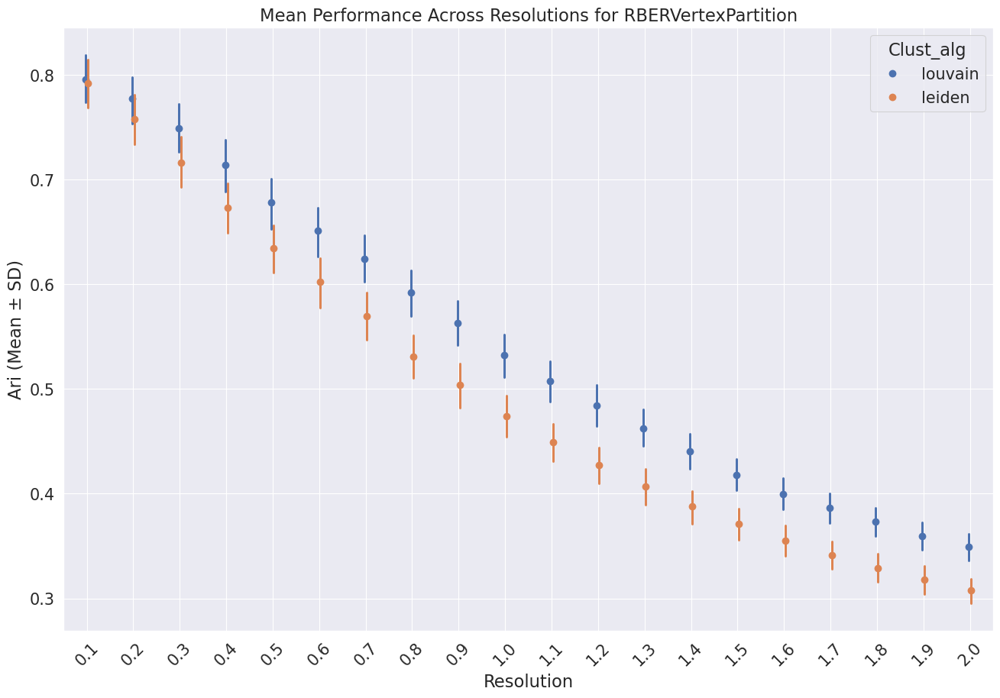

In [ ]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=filtered_df, x='Resolution', y='ari',hue='Clust_alg',
              dodge=True, estimator='mean',linestyle='none')
plt.xticks(rotation=45)

plt.xlabel('Resolution')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Resolutions for RBERVertexPartition')
plt.grid(True)
plt.show()

In [ ]:
max_ari=result_df.groupby(['K_Value'])['ari'].max().reset_index()

In [ ]:
max_ari

,K_Value,ari
0,3n_True,0.988560
1,4n_True,0.988560
2,5n_True,0.990401


In [ ]:
result_df.groupby(['Graph'])['ari'].max().reset_index()

,Graph,ari
0,gauss,0.990401
1,jaccard,0.971975
2,umap,0.990401


In [ ]:
result_df.groupby(['Graph'])['ari'].max().reset_index()

In [ ]:
filtered_rows = pd.merge(result_df, max_ari, on=['K_Value', 'ari'], how='inner')

## Jung

In [5]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics/Jung/'
datasets_results=os.listdir(results_dir)

In [6]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for algorithm_clust in os.listdir(os.path.join(results_dir+data)):
        for graph_con in os.listdir(os.path.join(results_dir+data+'/'+algorithm_clust)):
            for file in os.listdir(os.path.join(results_dir+data+'/'+algorithm_clust+'/'+graph_con)):
                df = pd.read_csv(os.path.join(results_dir+data+'/'+algorithm_clust+'/'+graph_con+'/'+file), sep=",")
                
                ari_col=df['ar'].iloc[1:]
                resolution=df.iloc[1:,0].str.split('_').str[1]
                quality_fun=df.iloc[1:,0].str.split('_').str[0]
                similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                if (k_value.split('_')[1]=='True'):
                    df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                 'K_Value': k_value, 'ARI': ari_col,'Dataset':data, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                    dfs.append(df_extracted)
                else: 
                    continue
        #dfs.append(df_extracted)
        #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]



In [7]:
result_df = pd.concat(dfs, ignore_index=True)


In [12]:
result_df.groupby(['Clust_alg'])['ARI'].max().reset_index()

,Clust_alg,ARI
0,leiden,0.640424
1,louvain,0.629407


In [14]:
to_plot=result_df.groupby(['Quality_Fun','Resolution','Similarity_Metric','Graph','Clust_alg'])['ARI'].mean().reset_index()

/tmp/ipykernel_52923/43487222.py:16: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sn=sns.catplot(data=to_plot, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)


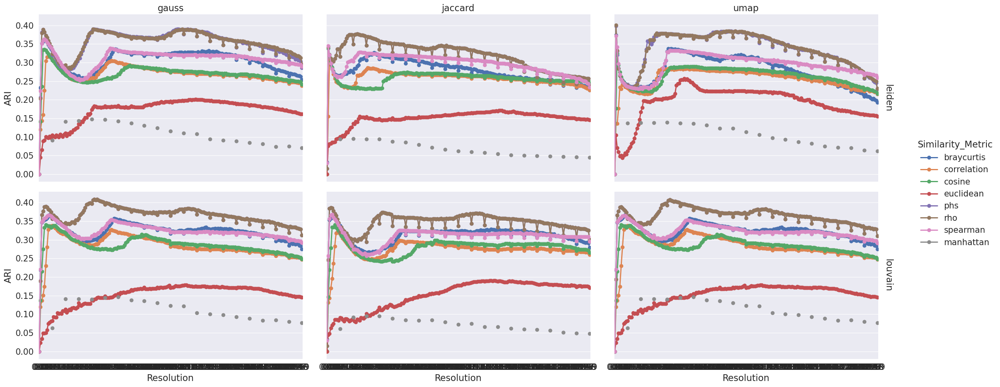

In [16]:
#sns.set(font_scale=1)
#sns.set(rc={'figure.figsize':(12.7,9.27)})
#sn=sns.catplot(data=k_four_rb, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', aspect=1.5)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
#plt.show()



#sns.set_theme(font_scale=10)
sns.set_theme(rc={'figure.figsize':(13.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
#sns.set_context("paper", rc={"font.size":10,"axes.titlesize":10,"axes.labelsize":5})   

sn=sns.catplot(data=to_plot, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
sn.set_titles(row_template='{row_name}',col_template='{col_name}')
#plt.show()

In [20]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ARI,Dataset,Graph,Clust_alg
0,RBConfigurationVertexPartition,0.0,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
1,RBConfigurationVertexPartition,0.01,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
2,RBConfigurationVertexPartition,0.02,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
3,RBConfigurationVertexPartition,0.03,cosine,55n_True,0.338327,Jung.h5ad,jaccard,louvain
4,RBConfigurationVertexPartition,0.04,cosine,55n_True,0.338327,Jung.h5ad,jaccard,louvain
...,...,...,...,...,...,...,...,...
510175,RBERVertexPartition,1.96,cosine,5n_True,0.255918,Jung.h5ad,umap,leiden
510176,RBERVertexPartition,1.97,cosine,5n_True,0.248609,Jung.h5ad,umap,leiden
510177,RBERVertexPartition,1.98,cosine,5n_True,0.253816,Jung.h5ad,umap,leiden
510178,RBERVertexPartition,1.99,cosine,5n_True,0.253492,Jung.h5ad,umap,leiden


In [22]:
result_df.groupby(['Similarity_Metric'])['ARI'].mean().reset_index()

,Similarity_Metric,ARI
0,braycurtis,0.302549
1,correlation,0.270107
2,cosine,0.272721
3,euclidean,0.161525
4,manhattan,0.096380
5,phs,0.346371
6,rho,0.346628
7,spearman,0.308649


In [24]:
result_df.groupby(['Quality_Fun'])['ARI'].max().reset_index()

,Quality_Fun,ARI
0,CPMVertexPartition,0.620593
1,RBConfigurationVertexPartition,0.629407
2,RBERVertexPartition,0.640424


/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_

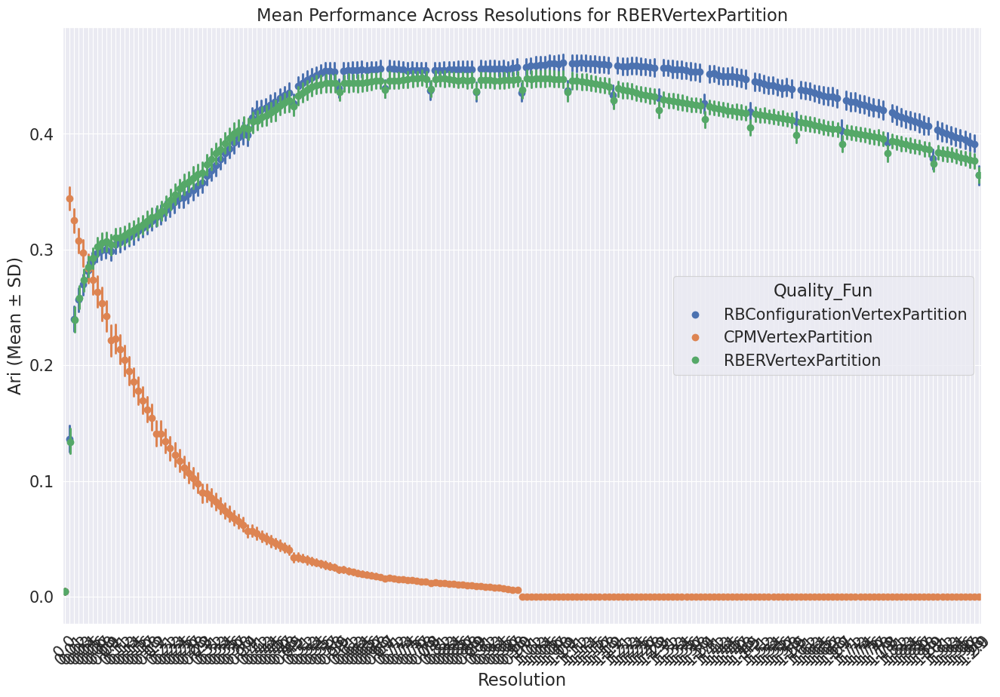

In [25]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=result_df, x='Resolution', y='ARI',hue='Quality_Fun',
              dodge=True, estimator='mean',linestyle='none')
plt.xticks(rotation=45)

plt.xlabel('Resolution')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Resolutions for RBERVertexPartition')
plt.grid(True)
plt.show()

Zheng

In [8]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics/Zheng/'
datasets_results=os.listdir(results_dir)

In [9]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for algorithm_clust in os.listdir(os.path.join(results_dir+data)):
        for graph_con in os.listdir(os.path.join(results_dir+data+'/'+algorithm_clust)):
            for file in os.listdir(os.path.join(results_dir+data+'/'+algorithm_clust+'/'+graph_con)):
                df = pd.read_csv(os.path.join(results_dir+data+'/'+algorithm_clust+'/'+graph_con+'/'+file), sep=",")
                
                ari_col=df['ar'].iloc[1:]
                resolution=df.iloc[1:,0].str.split('_').str[1]
                quality_fun=df.iloc[1:,0].str.split('_').str[0]
                similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                if (k_value.split('_')[1]=='True'):
                    df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                 'K_Value': k_value, 'ARI': ari_col,'Dataset':data, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                    dfs.append(df_extracted)
                else: 
                    continue
        #dfs.append(df_extracted)
        #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]



In [10]:
result_df = pd.concat(dfs, ignore_index=True)


In [22]:
result_df.groupby(['Similarity_Metric'])['ARI'].max().reset_index()

,Similarity_Metric,ARI
0,braycurtis,0.916602
1,correlation,0.916579
2,cosine,0.916647
3,euclidean,0.915462
4,phs,0.874779
5,rho,0.874779
6,spearman,0.916635


In [13]:
result_df.groupby(['Clust_alg'])['ARI'].max().reset_index()

,Clust_alg,ARI
0,leiden,0.916647
1,louvain,0.916602


In [16]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ARI,Dataset,Graph,Clust_alg
0,RBConfigurationVertexPartition,0.0,cosine,60n_True,0.000000,Zheng.h5ad,gauss,louvain
1,RBConfigurationVertexPartition,0.01,cosine,60n_True,0.749592,Zheng.h5ad,gauss,louvain
2,RBConfigurationVertexPartition,0.02,cosine,60n_True,0.749592,Zheng.h5ad,gauss,louvain
3,RBConfigurationVertexPartition,0.03,cosine,60n_True,0.870752,Zheng.h5ad,gauss,louvain
4,RBConfigurationVertexPartition,0.04,cosine,60n_True,0.870752,Zheng.h5ad,gauss,louvain
...,...,...,...,...,...,...,...,...
254851,RBERVertexPartition,1.96,phs,55n_True,0.122994,Zheng.h5ad,umap,leiden
254852,RBERVertexPartition,1.97,phs,55n_True,0.129774,Zheng.h5ad,umap,leiden
254853,RBERVertexPartition,1.98,phs,55n_True,0.129672,Zheng.h5ad,umap,leiden
254854,RBERVertexPartition,1.99,phs,55n_True,0.127705,Zheng.h5ad,umap,leiden


In [18]:
result_df=result_df.loc[result_df['Quality_Fun']!='CPMVertexPartition']

In [19]:
to_plot=result_df.groupby(['Quality_Fun','Resolution','Similarity_Metric','Graph','Clust_alg'])['ARI'].mean().reset_index()

/tmp/ipykernel_1359/3033316962.py:16: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sn=sns.catplot(data=to_plot, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)


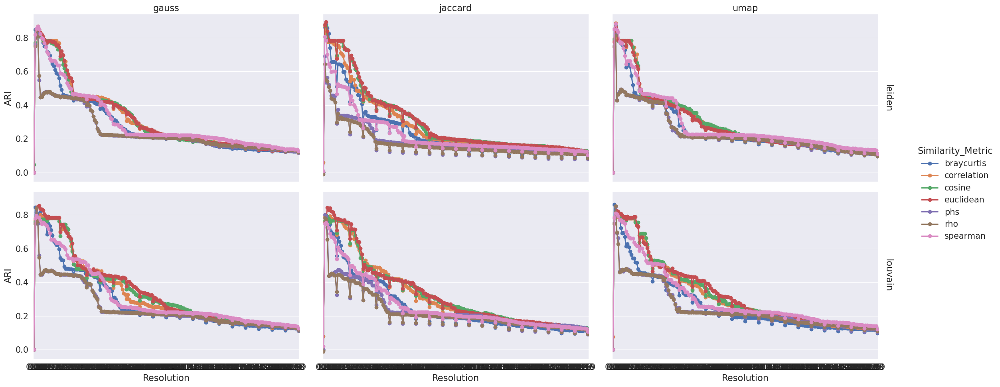

In [23]:
#sns.set(font_scale=1)
#sns.set(rc={'figure.figsize':(12.7,9.27)})
#sn=sns.catplot(data=k_four_rb, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', aspect=1.5)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
#plt.show()



#sns.set_theme(font_scale=10)
sns.set_theme(rc={'figure.figsize':(16.7,11.27)})
sns.set_context("paper", font_scale=1.7) 
#sns.set_context("paper", rc={"font.size":10,"axes.titlesize":10,"axes.labelsize":5})   

sn=sns.catplot(data=to_plot, x='Resolution', y='ARI', hue='Similarity_Metric', col='Graph',row='Clust_alg', kind='point', height=5, aspect=1.55,margin_titles=True,ci=None)
#sn.set_xticklabels(0:10)
#plt.setp(plot.axes.get_xticklabels(), visible=False)
#plt.setp(plot.axes.get_xticklabels()[::5], visible=True)
sn.set_titles(row_template='{row_name}',col_template='{col_name}')
#plt.show()

In [ ]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ARI,Dataset,Graph,Clust_alg
0,RBConfigurationVertexPartition,0.0,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
1,RBConfigurationVertexPartition,0.01,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
2,RBConfigurationVertexPartition,0.02,cosine,55n_True,0.000000,Jung.h5ad,jaccard,louvain
3,RBConfigurationVertexPartition,0.03,cosine,55n_True,0.338327,Jung.h5ad,jaccard,louvain
4,RBConfigurationVertexPartition,0.04,cosine,55n_True,0.338327,Jung.h5ad,jaccard,louvain
...,...,...,...,...,...,...,...,...
510175,RBERVertexPartition,1.96,cosine,5n_True,0.255918,Jung.h5ad,umap,leiden
510176,RBERVertexPartition,1.97,cosine,5n_True,0.248609,Jung.h5ad,umap,leiden
510177,RBERVertexPartition,1.98,cosine,5n_True,0.253816,Jung.h5ad,umap,leiden
510178,RBERVertexPartition,1.99,cosine,5n_True,0.253492,Jung.h5ad,umap,leiden


In [ ]:
result_df.groupby(['Similarity_Metric'])['ARI'].mean().reset_index()

,Similarity_Metric,ARI
0,braycurtis,0.302549
1,correlation,0.270107
2,cosine,0.272721
3,euclidean,0.161525
4,manhattan,0.096380
5,phs,0.346371
6,rho,0.346628
7,spearman,0.308649


In [ ]:
result_df.groupby(['Quality_Fun'])['ARI'].max().reset_index()

,Quality_Fun,ARI
0,CPMVertexPartition,0.620593
1,RBConfigurationVertexPartition,0.629407
2,RBERVertexPartition,0.640424


/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_data.get_group(pd_key)
/work/Master_Project/miniconda3/envs/metric_2/lib/python3.11/site-packages/seaborn/_base.py:949: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  data_subset = grouped_

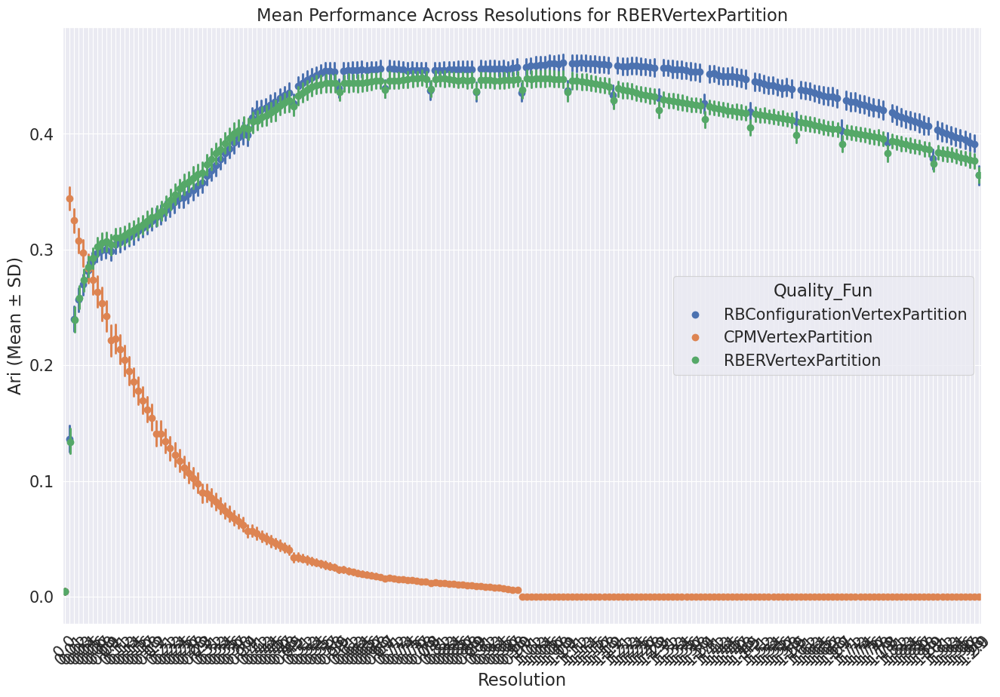

In [ ]:
sns.set_theme(rc={'figure.figsize':(15.7,10.27)})
sns.set_context("paper", font_scale=1.7) 
sns.pointplot(data=result_df, x='Resolution', y='ARI',hue='Quality_Fun',
              dodge=True, estimator='mean',linestyle='none')
plt.xticks(rotation=45)

plt.xlabel('Resolution')
plt.ylabel('Ari (Mean ± SD)')
plt.title('Mean Performance Across Resolutions for RBERVertexPartition')
plt.grid(True)
plt.show()

In [44]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics'
datasets_results=os.listdir(results_dir)

In [45]:
datasets_results

['Goolam', 'Tian', 'Yan', 'Koh', 'Jung', 'Biase', 'Kolodziejczyk', 'Zheng']

In [46]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for dataset in os.listdir(os.path.join(results_dir,data)):
        for algorithm_clust in os.listdir(os.path.join(results_dir,data,dataset)):
            for graph_con in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust)):
                for file in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con)):
                    df = pd.read_csv(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con,file), sep=",")
                    
                    ari_col=df['ar'].iloc[0:]
                    #print(df.iloc[1:,0].str.split('_').str[1]==0.2)
                        #resolution=df.iloc[0:,0].str.split('_').str[1]
                    resolution=df.iloc[0:,0].str.split('_').str[1]

                    quality_fun=df.iloc[0:,0].str.split('_').str[0]
                    similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                    if (k_value.split('_')[1]=='True'):
                        df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                    'K_Value': k_value, 'ari': ari_col,'Dataset':dataset, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                        dfs.append(df_extracted)
                    else: 
                        continue
            #dfs.append(df_extracted)
            #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]


In [47]:
result_df = pd.concat(dfs, ignore_index=True)


In [48]:
indices=result_df.groupby(['Dataset', 'Graph', 'Clust_alg'])['ari'].idxmax()


In [49]:
result_df.loc[indices]

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
2666753,RBConfigurationVertexPartition,1.03,braycurtis,20n_True,1.000000,Biase_fpkm.h5ad,gauss,leiden
2686314,RBConfigurationVertexPartition,0.15,spearman,5n_True,1.000000,Biase_fpkm.h5ad,gauss,louvain
2675476,RBConfigurationVertexPartition,0.04,correlation,5n_True,1.000000,Biase_fpkm.h5ad,jaccard,leiden
2678695,RBConfigurationVertexPartition,0.15,correlation,5n_True,1.000000,Biase_fpkm.h5ad,jaccard,louvain
2656224,ModularityVertexPartition,NaN,cosine,35n_True,1.000000,Biase_fpkm.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
1422238,RBERVertexPartition,0.92,braycurtis,30n_True,0.937707,sce_sc_Dropseq_qc.h5ad,gauss,louvain
1209090,RBConfigurationVertexPartition,0.75,cosine,60n_True,0.946256,sce_sc_Dropseq_qc.h5ad,jaccard,leiden
1373288,RBERVertexPartition,0.64,euclidean,20n_True,0.946256,sce_sc_Dropseq_qc.h5ad,jaccard,louvain
1155747,RBConfigurationVertexPartition,0.65,braycurtis,65n_True,0.937707,sce_sc_Dropseq_qc.h5ad,umap,leiden


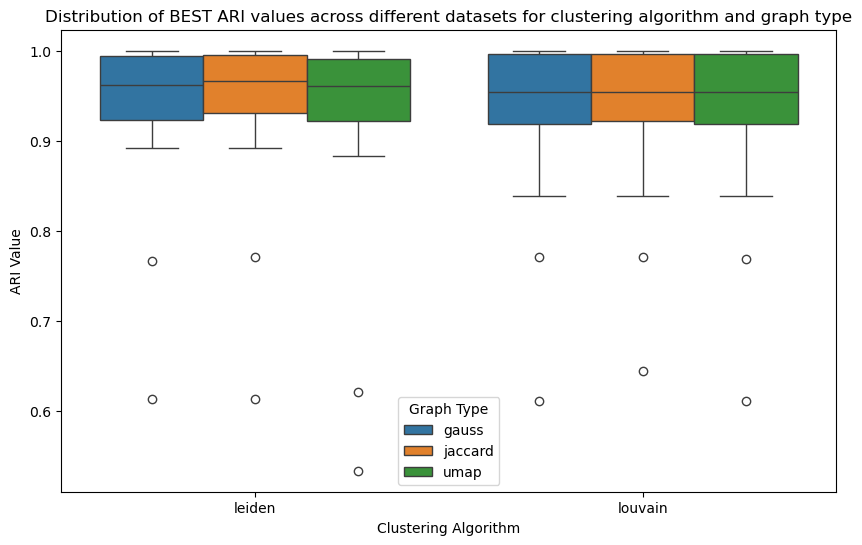

In [58]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', hue='Graph', data=result_df.loc[indices])
plt.title('Distribution of BEST ARI values across different datasets for clustering algorithm and graph type')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.legend(title='Graph Type')
plt.show()

In [59]:
mean_performance= result_df.groupby(['Dataset', 'Graph', 'Clust_alg'])['ari'].mean().reset_index()


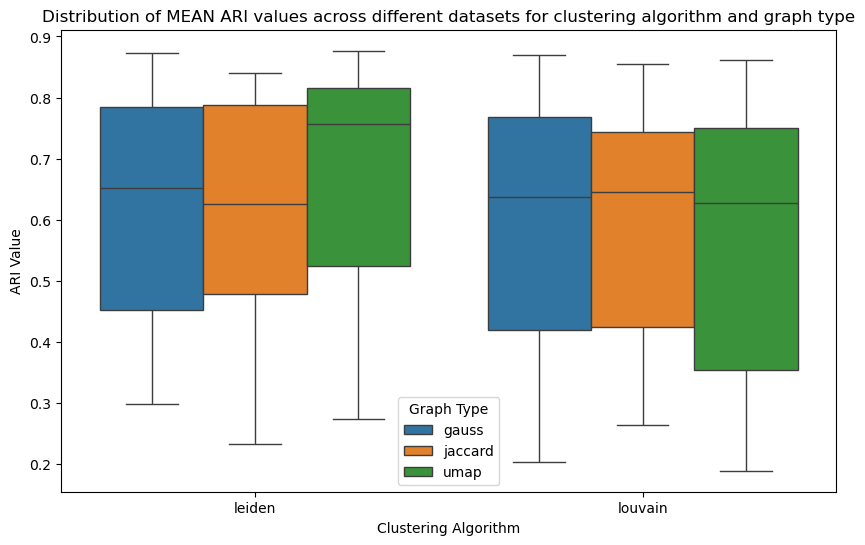

In [61]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', hue='Graph', data=mean_performance)
plt.title('Distribution of MEAN ARI values across different datasets for clustering algorithm and graph type')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.legend(title='Graph Type')
plt.show()

For every combination of clustering algorithm and graph, find the best ARI value for a dataset, and then make distribution for every combination. So number of points for distribtion = number of datasets

In [44]:
# For every metric, find the best value in every dataset and plot distribution of values across datasets

In [51]:
indices_dist=result_df.groupby(['Dataset', 'Similarity_Metric'])['ari'].idxmax()


In [52]:
result_df.loc[indices_dist]

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
2657828,ModularityVertexPartition,NaN,braycurtis,40n_True,1.000000,Biase_fpkm.h5ad,umap,leiden
2657026,ModularityVertexPartition,NaN,correlation,30n_True,1.000000,Biase_fpkm.h5ad,umap,leiden
2656224,ModularityVertexPartition,NaN,cosine,35n_True,1.000000,Biase_fpkm.h5ad,umap,leiden
2667764,RBERVertexPartition,1.12,euclidean,35n_True,1.000000,Biase_fpkm.h5ad,gauss,leiden
2658229,ModularityVertexPartition,NaN,phs,45n_True,1.000000,Biase_fpkm.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
1209090,RBConfigurationVertexPartition,0.75,cosine,60n_True,0.946256,sce_sc_Dropseq_qc.h5ad,jaccard,leiden
1224668,RBConfigurationVertexPartition,0.14,euclidean,65n_True,0.946256,sce_sc_Dropseq_qc.h5ad,jaccard,leiden
1212068,RBERVertexPartition,0.46,phs,70n_True,0.924334,sce_sc_Dropseq_qc.h5ad,jaccard,leiden
1215677,RBERVertexPartition,0.46,rho,70n_True,0.924334,sce_sc_Dropseq_qc.h5ad,jaccard,leiden


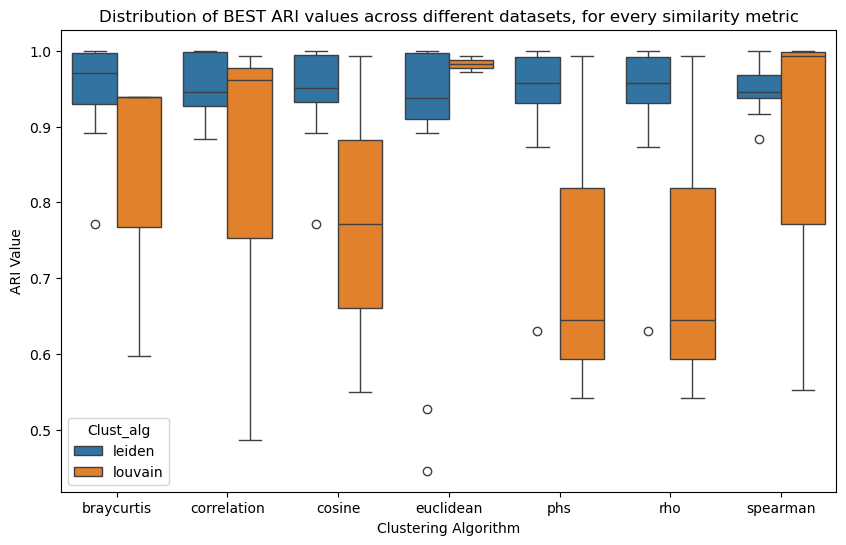

In [62]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Similarity_Metric', y='ari',hue='Clust_alg', data=result_df.loc[indices_dist])
plt.title('Distribution of BEST ARI values across different datasets, for every similarity metric')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.show()

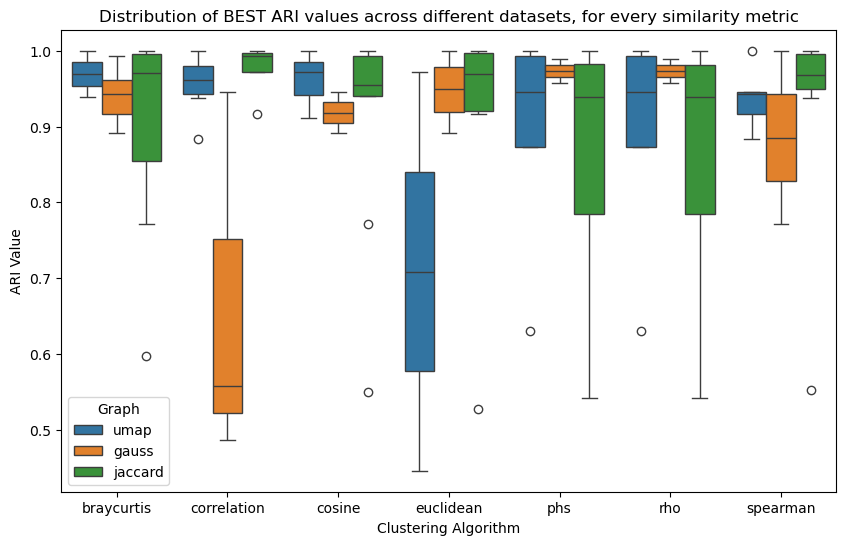

In [70]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Similarity_Metric', y='ari',hue='Graph', data=result_df.loc[indices_dist])
plt.title('Distribution of BEST ARI values across different datasets, for every similarity metric')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.show()

In [75]:
no_modularity = result_df[result_df['Quality_Fun']!='ModularityVertexPartition']

In [76]:
no_modularity

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
1,RBConfigurationVertexPartition,0.01,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
2,RBConfigurationVertexPartition,0.02,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
3,RBConfigurationVertexPartition,0.03,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
4,RBConfigurationVertexPartition,0.04,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
5,RBConfigurationVertexPartition,0.05,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
3010302,RBERVertexPartition,1.96,correlation,85n_True,0.126378,Zheng.h5ad,umap,leiden
3010303,RBERVertexPartition,1.97,correlation,85n_True,0.124373,Zheng.h5ad,umap,leiden
3010304,RBERVertexPartition,1.98,correlation,85n_True,0.126757,Zheng.h5ad,umap,leiden
3010305,RBERVertexPartition,1.99,correlation,85n_True,0.126621,Zheng.h5ad,umap,leiden


In [80]:
indices_best=no_modularity.groupby(['Dataset', 'Clust_alg', 'Quality_Fun'])['ari'].idxmax().reset_index()


In [81]:
indices_best

,Dataset,Clust_alg,Quality_Fun,ari
0,Biase_fpkm.h5ad,leiden,RBConfigurationVertexPartition,2656268
1,Biase_fpkm.h5ad,leiden,RBERVertexPartition,2656469
2,Biase_fpkm.h5ad,louvain,RBConfigurationVertexPartition,2678695
3,Biase_fpkm.h5ad,louvain,RBERVertexPartition,2678897
4,Goolam.h5ad,leiden,RBConfigurationVertexPartition,419
5,Goolam.h5ad,leiden,RBERVertexPartition,31984
6,Goolam.h5ad,louvain,RBConfigurationVertexPartition,76211
7,Goolam.h5ad,louvain,RBERVertexPartition,80103
8,Jung.h5ad,leiden,RBConfigurationVertexPartition,2384496
9,Jung.h5ad,leiden,RBERVertexPartition,2454812


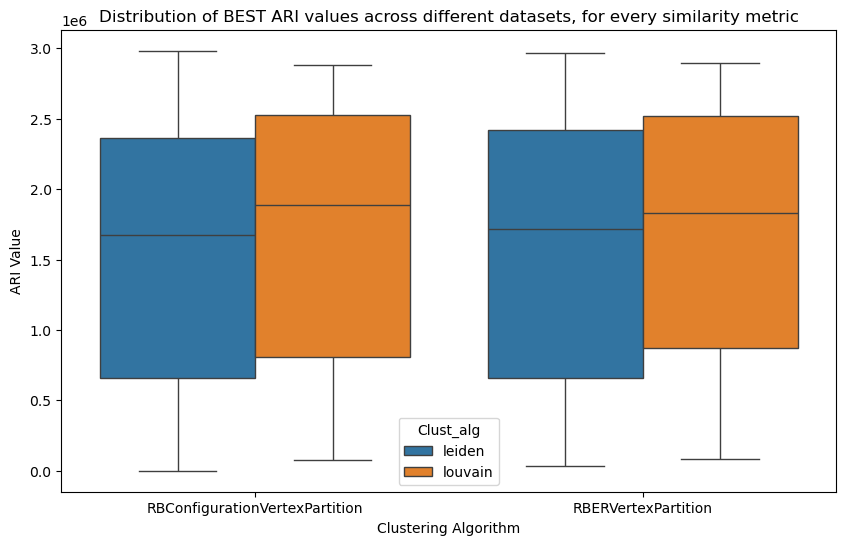

In [83]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Quality_Fun', y='ari',hue='Clust_alg', data=indices_best)
plt.title('Distribution of BEST ARI values across different datasets, for every similarity metric')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.show()

Resolutions

In [90]:
no_modularity

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
1,RBConfigurationVertexPartition,0.01,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
2,RBConfigurationVertexPartition,0.02,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
3,RBConfigurationVertexPartition,0.03,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
4,RBConfigurationVertexPartition,0.04,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
5,RBConfigurationVertexPartition,0.05,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
3010302,RBERVertexPartition,1.96,correlation,85n_True,0.126378,Zheng.h5ad,umap,leiden
3010303,RBERVertexPartition,1.97,correlation,85n_True,0.124373,Zheng.h5ad,umap,leiden
3010304,RBERVertexPartition,1.98,correlation,85n_True,0.126757,Zheng.h5ad,umap,leiden
3010305,RBERVertexPartition,1.99,correlation,85n_True,0.126621,Zheng.h5ad,umap,leiden


In [123]:
resolutions_best=no_modularity.groupby(['Dataset','Resolution'])['ari'].idxmax()

In [130]:
resolutions_best   #for every resolution value, chose the best combination of parameters in terms of ARI

Dataset                 Resolution
Biase_fpkm.h5ad         0.01          2658631
                        0.02          2658632
                        0.03          2658633
                        0.04          2658634
                        0.05          2658635
                                       ...   
sce_sc_Dropseq_qc.h5ad  1.96          1205201
                        1.97          1205202
                        1.98          1205203
                        1.99          1205204
                        2.0           1205205
Name: ari, Length: 2800, dtype: int64

In [127]:
best_resolutions = no_modularity.loc[resolutions_best]

In [131]:
 mean_of_best = best_resolutions.groupby(['Dataset', 'Clust_alg'])['ari'].mean().reset_index()   
#Then calculate the mean of the best
#for every dataset 

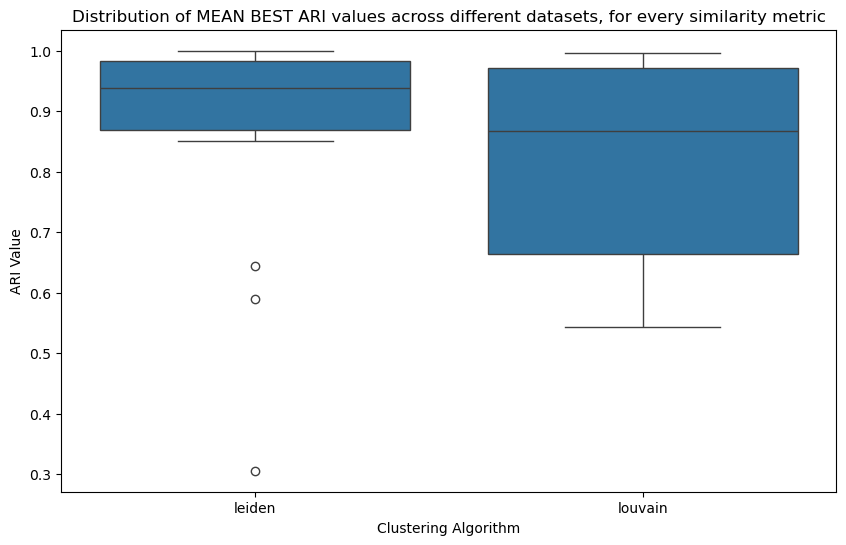

In [132]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', data=mean_of_best)
plt.title('Distribution of MEAN BEST ARI values of resolutions across different datasets')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.show()

Best combination for every resolution (this will give 200 BEST values for every dataset), then calculate the mean across all of those 200 values for every dataset. So every point in the distribution is the mean of the best combination of parameters for every resolution for every dataset

In [138]:
resolutions_all_mean=no_modularity.groupby(['Dataset','Resolution','Clust_alg'])['ari'].mean().reset_index()

In [144]:
mean_of_means = resolutions_all_mean.groupby(['Dataset', 'Clust_alg'])['ari'].mean().reset_index()

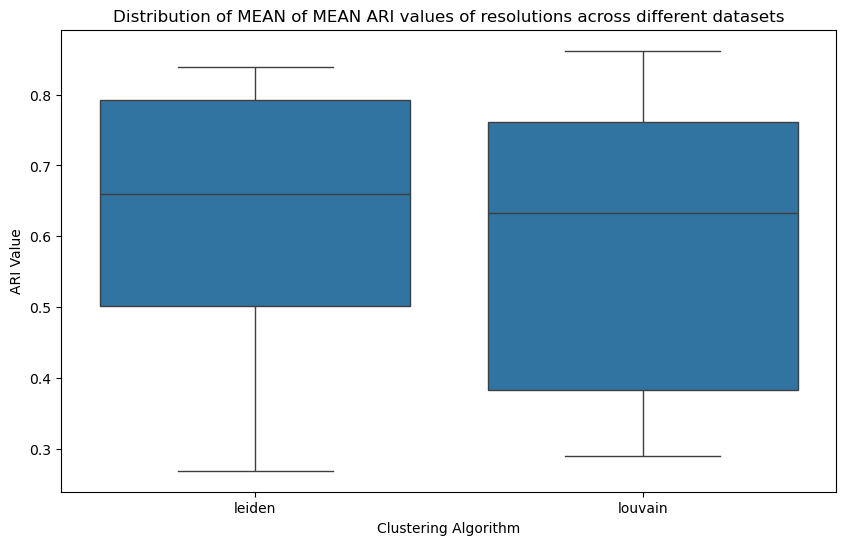

In [146]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', data=mean_of_means)
plt.title('Distribution of MEAN of MEAN ARI values of resolutions across different datasets')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.show()

In [62]:
best_comb_leid=best_comb.iloc[0]

In [61]:
best_comb_louv=best_comb.iloc[1]

In [65]:
best_leid=result_df.query('Quality_Fun == @best_comb.iloc[0].Quality_Fun and Similarity_Metric == @best_comb.iloc[0].Similarity_Metric and K_Value == @best_comb.iloc[0].K_Value and Dataset == @best_comb.iloc[0].Dataset and Graph == @best_comb.iloc[0].Graph and Clust_alg == @best_comb.iloc[0].Clust_alg')

In [63]:
best_louv=result_df.query('Quality_Fun == @best_comb.iloc[1].Quality_Fun and Similarity_Metric == @best_comb.iloc[1].Similarity_Metric and K_Value == @best_comb.iloc[1].K_Value and Dataset == @best_comb.iloc[1].Dataset and Graph == @best_comb.iloc[1].Graph and Clust_alg == @best_comb.iloc[1].Clust_alg')

In [66]:
best_leid

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
145764,RBERVertexPartition,0.01,rho,95n_True,0.338456,Jung.h5ad,umap,leiden
145765,RBERVertexPartition,0.02,rho,95n_True,0.338456,Jung.h5ad,umap,leiden
145766,RBERVertexPartition,0.03,rho,95n_True,0.338456,Jung.h5ad,umap,leiden
145767,RBERVertexPartition,0.04,rho,95n_True,0.338456,Jung.h5ad,umap,leiden
145768,RBERVertexPartition,0.05,rho,95n_True,0.338456,Jung.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
145959,RBERVertexPartition,1.96,rho,95n_True,0.379114,Jung.h5ad,umap,leiden
145960,RBERVertexPartition,1.97,rho,95n_True,0.375603,Jung.h5ad,umap,leiden
145961,RBERVertexPartition,1.98,rho,95n_True,0.377570,Jung.h5ad,umap,leiden
145962,RBERVertexPartition,1.99,rho,95n_True,0.375964,Jung.h5ad,umap,leiden


In [67]:
best_louv

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
178446,RBConfigurationVertexPartition,0.01,rho,55n_True,0.338193,Jung.h5ad,jaccard,louvain
178447,RBConfigurationVertexPartition,0.02,rho,55n_True,0.338193,Jung.h5ad,jaccard,louvain
178448,RBConfigurationVertexPartition,0.03,rho,55n_True,0.338193,Jung.h5ad,jaccard,louvain
178449,RBConfigurationVertexPartition,0.04,rho,55n_True,0.338193,Jung.h5ad,jaccard,louvain
178450,RBConfigurationVertexPartition,0.05,rho,55n_True,0.338193,Jung.h5ad,jaccard,louvain
...,...,...,...,...,...,...,...,...
178641,RBConfigurationVertexPartition,1.96,rho,55n_True,0.570672,Jung.h5ad,jaccard,louvain
178642,RBConfigurationVertexPartition,1.97,rho,55n_True,0.567451,Jung.h5ad,jaccard,louvain
178643,RBConfigurationVertexPartition,1.98,rho,55n_True,0.555121,Jung.h5ad,jaccard,louvain
178644,RBConfigurationVertexPartition,1.99,rho,55n_True,0.548560,Jung.h5ad,jaccard,louvain


In [6]:
plt.figure(figsize=(10, 6))
ax = plt.gca()

plt.plot(best_leid['Resolution'], best_leid['ari'],label='leiden')
plt.plot(best_louv['Resolution'],best_louv['ari'], label='louvain')
plt.title('Resulting ARI values with varied resolution')
plt.xlabel('Resolution')
plt.ylabel('ARI Value')
temp = ax.xaxis.get_ticklabels()
temp = list(set(temp) - set(temp[::10]))
for label in temp:
    label.set_visible(False)
plt.legend()
plt.show()

SyntaxError: invalid syntax (3966538573.py, line 9)

In [38]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics'
datasets_results=os.listdir(results_dir)

In [39]:
datasets_results

['Goolam', 'Tian', 'Yan', 'Koh', 'Jung', 'Biase', 'Kolodziejczyk', 'Zheng']

In [12]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for dataset in os.listdir(os.path.join(results_dir,data)):
        for algorithm_clust in os.listdir(os.path.join(results_dir,data,dataset)):
            for graph_con in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust)):
                for file in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con)):
                    df = pd.read_csv(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con,file), sep=",")
                    
                    ari_col=df['ar'].iloc[0:]
                    #print(df.iloc[1:,0].str.split('_').str[1]==0.2)
                        #resolution=df.iloc[0:,0].str.split('_').str[1]
                    resolution=df.iloc[0:,0].str.split('_').str[1]

                    quality_fun=df.iloc[0:,0].str.split('_').str[0]
                    similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                    if (k_value.split('_')[1]=='True'):
                        df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                    'K_Value': k_value, 'ari': ari_col,'Dataset':dataset, 'Graph': graph_con,'Clust_alg':algorithm_clust})
                        dfs.append(df_extracted)
                    else: 
                        continue
            #dfs.append(df_extracted)
            #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]


In [13]:
result_df = pd.concat(dfs, ignore_index=True)


In [16]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,ari,Dataset,Graph,Clust_alg
0,ModularityVertexPartition,NaN,phs,35n_True,0.544094,Goolam.h5ad,umap,leiden
1,RBConfigurationVertexPartition,0.01,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
2,RBConfigurationVertexPartition,0.02,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
3,RBConfigurationVertexPartition,0.03,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
4,RBConfigurationVertexPartition,0.04,phs,35n_True,0.629881,Goolam.h5ad,umap,leiden
...,...,...,...,...,...,...,...,...
2910453,RBERVertexPartition,1.96,spearman,10n_True,0.103446,Zheng.h5ad,umap,leiden
2910454,RBERVertexPartition,1.97,spearman,10n_True,0.102576,Zheng.h5ad,umap,leiden
2910455,RBERVertexPartition,1.98,spearman,10n_True,0.100557,Zheng.h5ad,umap,leiden
2910456,RBERVertexPartition,1.99,spearman,10n_True,0.100993,Zheng.h5ad,umap,leiden


In [40]:
np.unique(result_df['Dataset'])

array(['Biase_fpkm.h5ad', 'Goolam.h5ad', 'Jung.h5ad', 'Koh_TPM.h5ad',
       'Kolodziejczyk.h5ad', 'Yan_RPKM.h5ad', 'Zheng.h5ad',
       'sc_Celseq2_5cl_p1.h5ad', 'sc_Celseq2_5cl_p2.h5ad',
       'sc_Celseq2_5cl_p3.h5ad', 'sce_sc_10x_5cl_qc.h5ad',
       'sce_sc_10x_qc.h5ad', 'sce_sc_CELseq2_qc.h5ad',
       'sce_sc_Dropseq_qc.h5ad'], dtype=object)

In [41]:
mean_performance= result_df.groupby(['Dataset', 'Graph', 'Clust_alg'])['ari'].mean().reset_index()


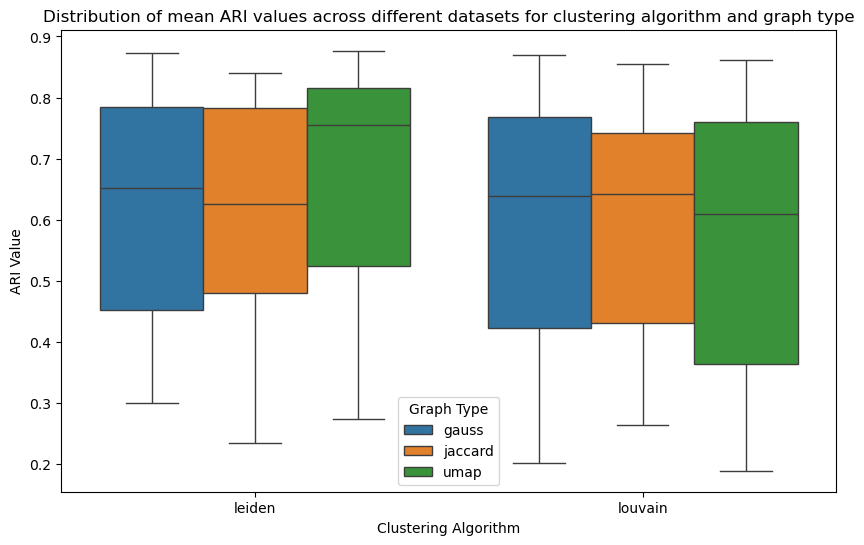

In [43]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', hue='Graph', data=mean_performance)
plt.title('Distribution of mean ARI values across different datasets for clustering algorithm and graph type')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.legend(title='Graph Type')
plt.show()

In [30]:
dat=result_df.groupby(['Dataset','Graph','Clust_alg'])['ari'].apply(lambda x: x)

In [31]:
dat

Dataset                 Graph  Clust_alg         
Biase_fpkm.h5ad         gauss  leiden     2602891    0.695091
                                          2602892    0.000000
                                          2602893    0.000000
                                          2602894    0.000000
                                          2602895    0.000000
                                                       ...   
sce_sc_Dropseq_qc.h5ad  umap   louvain    1324097    0.882297
                                          1324098    0.882297
                                          1324099    0.882297
                                          1324100    0.882297
                                          1324101    0.882297
Name: ari, Length: 2910458, dtype: float64

In [14]:
result_df.groupby(['Dataset',  'Clust_alg','Graph'])['ari'].idxmax()

Dataset                 Clust_alg  Graph  
Biase_fpkm.h5ad         leiden     gauss      2602994
                                   jaccard    2611717
                                   umap       2592465
                        louvain    gauss      2620149
                                   jaccard    2614622
                                               ...   
sce_sc_Dropseq_qc.h5ad  leiden     jaccard    1178614
                                   umap       1128880
                        louvain    gauss      1386950
                                   jaccard    1338000
                                   umap       1299641
Name: ari, Length: 84, dtype: int64

In [ ]:
result_df['ari'].idxmax()


In [ ]:
sce_sc_10x_5cl=result_df[result_df['Dataset']=='sce_sc_10x_5cl_qc.h5ad']

In [ ]:
max=sce_sc_10x_5cl['ari'].idxmax()

In [ ]:
result_df[result_df['Dataset']=='sce_sc_10x_5cl_qc.h5ad'].groupby([''])

In [ ]:
indices=result_df.groupby(['Dataset', 'Graph', 'Clust_alg'])['ari'].idxmax()


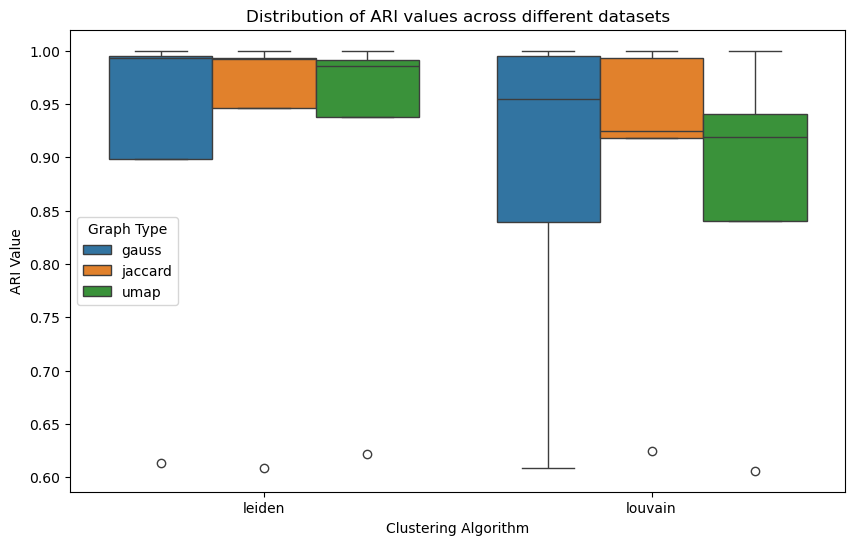

In [ ]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='ari', hue='Graph', data=result_df.loc[indices])
plt.title('Distribution of ARI values across different datasets')
plt.xlabel('Clustering Algorithm')
plt.ylabel('ARI Value')
plt.legend(title='Graph Type')
plt.show()

Analysis of Modularity

In [190]:
results_dir= '/work/Master_Project/Snakemake/analysis/metrics'
datasets_results=os.listdir(results_dir)

In [191]:
result_column = pd.Series()
dfs=[]

for data in datasets_results:
    for dataset in os.listdir(os.path.join(results_dir,data)):
        for algorithm_clust in os.listdir(os.path.join(results_dir,data,dataset)):
            for graph_con in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust)):
                for file in os.listdir(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con)):
                    df = pd.read_csv(os.path.join(results_dir,data,dataset,algorithm_clust,graph_con,file), sep=",")
                    
                    modularity_col=df['modularity'].iloc[0:]
                    psi_col = df['psi'].iloc[0:]
                    ari_col=df['ar'].iloc[0:]
                    nmi_col=df['nmi'].iloc[0:]
                    afm_col=df['afm'].iloc[0:]

                    #print(df.iloc[1:,0].str.split('_').str[1]==0.2)
                        #resolution=df.iloc[0:,0].str.split('_').str[1]
                    resolution=df.iloc[0:,0].str.split('_').str[1]

                    quality_fun=df.iloc[0:,0].str.split('_').str[0]
                    similarity_metric, k_value=file.split('.')[0],file.split('.')[1]
                    if (k_value.split('_')[1]=='True'):
                        df_extracted = pd.DataFrame({'Quality_Fun':quality_fun, 'Resolution': resolution, 'Similarity_Metric': similarity_metric, 
                                    'K_Value': k_value.split('_')[0], 'modul': modularity_col, 'Dataset':dataset, 'Graph': graph_con,'Clust_alg':algorithm_clust, 'ari':ari_col, 'psi':psi_col,'afm':afm_col,'nmi':nmi_col })
                        dfs.append(df_extracted)
                    else: 
                        continue
            #dfs.append(df_extracted)
            #similarity_metric, k_value = file_path.split('.')[1], file_path.split('.')[0], file_path.split('_')[1]


In [192]:
result_df = pd.concat(dfs, ignore_index=True)


In [193]:
result_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,ModularityVertexPartition,NaN,spearman,95n,0.664786,Zheng.h5ad,gauss,leiden,0.223723,0.227055,0.284343,0.525614
1,RBConfigurationVertexPartition,0.001,spearman,95n,0.000000,Zheng.h5ad,gauss,leiden,0.000000,0.000000,0.000000,0.000000
2,RBConfigurationVertexPartition,0.006,spearman,95n,0.287520,Zheng.h5ad,gauss,leiden,0.749808,0.060777,0.758470,0.611187
3,RBConfigurationVertexPartition,0.011,spearman,95n,0.287520,Zheng.h5ad,gauss,leiden,0.749808,0.060777,0.758470,0.611187
4,RBConfigurationVertexPartition,0.016,spearman,95n,0.287520,Zheng.h5ad,gauss,leiden,0.749808,0.060777,0.758470,0.611187
...,...,...,...,...,...,...,...,...,...,...,...,...
14411875,RBERVertexPartition,1.981,euclidean,25n,0.448757,Deng.h5ad,umap,leiden,0.348073,0.312137,0.389298,0.629948
14411876,RBERVertexPartition,1.986,euclidean,25n,0.448757,Deng.h5ad,umap,leiden,0.348073,0.312137,0.389298,0.629948
14411877,RBERVertexPartition,1.991,euclidean,25n,0.447854,Deng.h5ad,umap,leiden,0.343575,0.281392,0.385174,0.626775
14411878,RBERVertexPartition,1.996,euclidean,25n,0.447854,Deng.h5ad,umap,leiden,0.343575,0.281392,0.385174,0.626775


In [194]:
indices=result_df.groupby(['Dataset','Clust_alg'])['ari'].idxmax().reset_index()


In [195]:
indices

,Dataset,Clust_alg,ari
0,Biase_fpkm.h5ad,leiden,3062989
1,Biase_fpkm.h5ad,louvain,2834216
2,Deng.h5ad,leiden,13912226
3,Deng.h5ad,louvain,13407750
4,Goolam.h5ad,leiden,2495297
5,Goolam.h5ad,louvain,1820918
6,Jung.h5ad,leiden,11460092
7,Jung.h5ad,louvain,12181923
8,Koh_TPM.h5ad,leiden,12985592
9,Koh_TPM.h5ad,louvain,12808604


In [196]:
best= result_df.loc[indices.ari]

In [197]:
best

,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


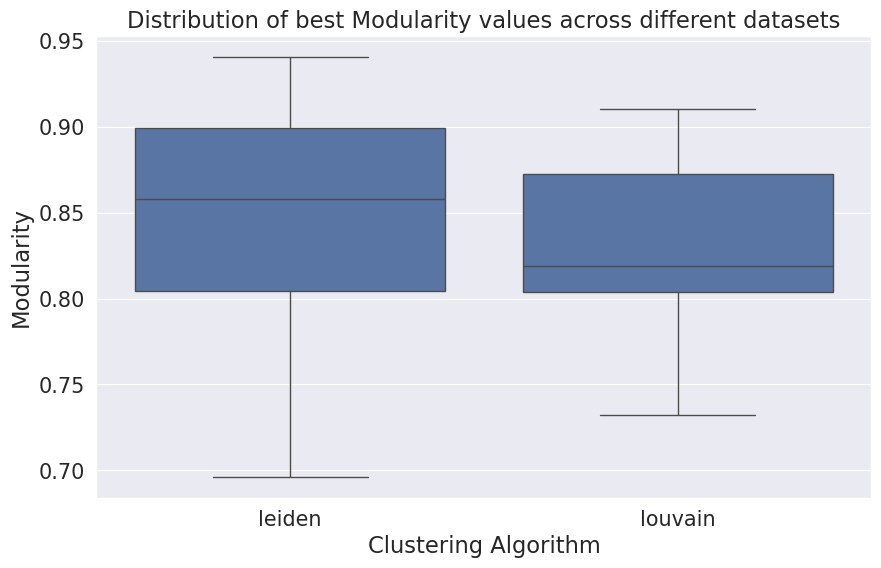

In [148]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='mod', data=result_df.loc[indices])
plt.title('Distribution of best Modularity values across different datasets')
plt.xlabel('Clustering Algorithm')
plt.ylabel('Modularity')
plt.show()

In [132]:
indices=result_df.groupby(['Dataset','Clust_alg'])['mod'].idxmin()


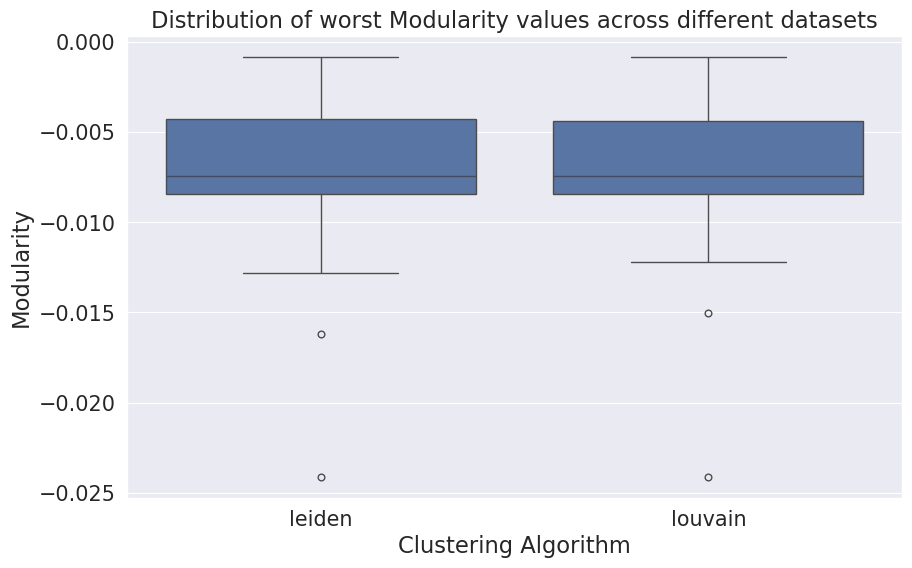

In [134]:
plt.figure(figsize=(10, 6))
sns.boxplot(x='Clust_alg', y='mod', data=result_df.loc[indices])
plt.title('Distribution of worst Modularity values across different datasets')
plt.xlabel('Clustering Algorithm')
plt.ylabel('Modularity')
plt.show()

In [86]:
indices_best=result_df.groupby(['Dataset', 'Clust_alg'])['ari'].idxmax().reset_index()


In [155]:
best_df = result_df.iloc[result_df.groupby(['Dataset', 'Clust_alg'])['ari'].idxmax()]

In [156]:
best_df

,Quality_Fun,Resolution,Similarity_Metric,K_Value,mod,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


In [198]:
biase = result_df[(result_df['Dataset'] == 'Biase_fpkm.h5ad') & (result_df['ari'] == 1.000000)].reset_index()

In [214]:
biase.iloc[0].modul

0.4852230814991076

In [212]:
biase[biase['modul']== 0.35095371900826444]

,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi


In [217]:
biase.iloc[biase['modul'].idxmax()].modul

0.6406327236777064

In [186]:
biase

,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,mod,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
1,2834336,RBConfigurationVertexPartition,0.596,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
2,2834337,RBConfigurationVertexPartition,0.601,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
3,2834338,RBConfigurationVertexPartition,0.606,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
4,2834339,RBConfigurationVertexPartition,0.611,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
74997,3285607,RBERVertexPartition,1.461,cosine,20n,0.350954,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
74998,3285608,RBERVertexPartition,1.466,cosine,20n,0.350954,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
74999,3285609,RBERVertexPartition,1.471,cosine,20n,0.350954,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
75000,3285610,RBERVertexPartition,1.476,cosine,20n,0.350954,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0


In [230]:
best_ari_best_modul = biase[biase['modul'] == 0.6406327236777064 ].reset_index()

In [232]:
best_ari_best_modul[best_ari_best_modul['Quality_Fun'] == 'RBConfigurationVertexPartition']

,level_0,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,3081,2859590,RBConfigurationVertexPartition,0.446,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
1,3082,2859591,RBConfigurationVertexPartition,0.451,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
2,3083,2859592,RBConfigurationVertexPartition,0.456,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
3,3084,2859593,RBConfigurationVertexPartition,0.461,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
4,3085,2859594,RBConfigurationVertexPartition,0.466,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,louvain,1.0,1.0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
124,64709,3211070,RBConfigurationVertexPartition,0.006,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
125,64710,3211071,RBConfigurationVertexPartition,0.011,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
126,64711,3211072,RBConfigurationVertexPartition,0.016,phs,5n,0.640633,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0
183,73048,3268861,RBConfigurationVertexPartition,0.001,rho,5n,0.640633,Biase_fpkm.h5ad,gauss,leiden,1.0,1.0,1.0,1.0


In [152]:
biase[max]

KeyError: 2859590

In [102]:
np.unique(result_df[(result_df['Dataset'] == 'Biase_fpkm') & (result_df['ari'] == 1.000000)].Similarity_Metric)

array(['braycurtis', 'correlation', 'cosine', 'euclidean', 'phs', 'rho',
       'spearman'], dtype=object)

In [124]:
indices_best.ari

0      3062989
1      2834216
2     13912226
3     13407750
4      2495297
5      1820918
6     11460092
7     12181923
8     12985592
9     12808604
10     3984444
11     3558224
12     1013015
13     1427220
14      183815
15      788223
16     7413432
17     8036366
18    10198315
19     9575785
20     8971426
21     8574673
22     5814250
23     5982809
24     6322206
25     6841130
26    10367644
27    10872120
28     4879828
29     4542724
Name: ari, dtype: int64

In [125]:
result_df.iloc[indices_best.ari]

,Quality_Fun,Resolution,Similarity_Metric,K_Value,mod,Dataset,Graph,Clust_alg,ari,psi
3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000
2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000
13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405
13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405
2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045
1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045
11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465
12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459
12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655
12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655


In [129]:
result_df.loc[[(result_df['Dataset'] == 'Biase_fpkm.h5ad') & (result_df['ari'] == 1.000000)]]

KeyError: "None of [Index([(False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, False, ...)], dtype='object')] are in the [index]"

## TODO: Function to identify best of the best in terms of all of the metrics( or some of them>?)

In [317]:
best_df = result_df.iloc[result_df.groupby(['Dataset', 'Clust_alg'])['ari'].idxmax()].reset_index()

In [318]:
best_df

,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
1,2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
2,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
3,13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
4,2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
5,1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
6,11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
7,12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
8,12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
9,12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


In [ ]:
def identify_best(result):
    best_ari = result.iloc[result.groupby(['Dataset', 'Clust_alg'])['modul','ari'].idxmax()].reset


In [319]:
result_df.merge(best_df, on=['ari','Dataset','Clust_alg'])

,Quality_Fun_x,Resolution_x,Similarity_Metric_x,K_Value_x,modul_x,Dataset,Graph_x,Clust_alg,ari,psi_x,...,index,Quality_Fun_y,Resolution_y,Similarity_Metric_y,K_Value_y,modul_y,Graph_y,psi_y,afm_y,nmi_y
0,RBERVertexPartition,0.021,cosine,40n,0.372909,Zheng.h5ad,jaccard,leiden,0.916647,0.243684,...,183815,RBERVertexPartition,0.021,cosine,40n,0.372909,jaccard,0.243684,0.917471,0.812542
1,RBERVertexPartition,0.021,cosine,40n,0.372909,Zheng.h5ad,jaccard,louvain,0.916647,0.243684,...,788223,RBERVertexPartition,0.021,cosine,40n,0.372909,jaccard,0.243684,0.917471,0.812542
2,CPMVertexPartition,0.246,cosine,75n,0.006888,Yan_RPKM.h5ad,umap,leiden,0.945041,0.567308,...,1013015,CPMVertexPartition,0.246,cosine,75n,0.006888,umap,0.567308,0.945102,0.937604
3,CPMVertexPartition,0.251,cosine,75n,0.006888,Yan_RPKM.h5ad,umap,leiden,0.945041,0.567308,...,1013015,CPMVertexPartition,0.246,cosine,75n,0.006888,umap,0.567308,0.945102,0.937604
4,CPMVertexPartition,0.256,cosine,75n,0.006888,Yan_RPKM.h5ad,umap,leiden,0.945041,0.567308,...,1013015,CPMVertexPartition,0.246,cosine,75n,0.006888,umap,0.567308,0.945102,0.937604
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
318078,RBERVertexPartition,0.281,braycurtis,5n,0.611337,Deng.h5ad,umap,leiden,0.878791,0.704405,...,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,gauss,0.704405,0.882609,0.893837
318079,RBERVertexPartition,0.286,braycurtis,5n,0.611337,Deng.h5ad,umap,leiden,0.878791,0.704405,...,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,gauss,0.704405,0.882609,0.893837
318080,RBERVertexPartition,0.291,braycurtis,5n,0.611337,Deng.h5ad,umap,leiden,0.878791,0.704405,...,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,gauss,0.704405,0.882609,0.893837
318081,RBERVertexPartition,0.296,braycurtis,5n,0.611337,Deng.h5ad,umap,leiden,0.878791,0.704405,...,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,gauss,0.704405,0.882609,0.893837


In [296]:
best_df

,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
1,2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
2,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
3,13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
4,2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
5,1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
6,11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
7,12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
8,12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
9,12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


In [316]:
best_df

,index,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
0,3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
1,2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
2,13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
3,13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
4,2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
5,1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
6,11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
7,12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
8,12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
9,12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


In [307]:
result_df.join(best_df[0].set_index(['ari','Clust_alg','Dataset']), on=['ari','Clust_alg','Dataset'], how='right')

KeyError: 0

In [279]:
best_df[['ari','Clust_alg','Dataset']]

,ari,Clust_alg,Dataset
0,1.000000,leiden,Biase_fpkm.h5ad
1,1.000000,louvain,Biase_fpkm.h5ad
2,0.878791,leiden,Deng.h5ad
3,0.878791,louvain,Deng.h5ad
4,0.891880,leiden,Goolam.h5ad
5,0.891880,louvain,Goolam.h5ad
6,0.643791,leiden,Jung.h5ad
7,0.640989,louvain,Jung.h5ad
8,0.968559,leiden,Koh_TPM.h5ad
9,0.968559,louvain,Koh_TPM.h5ad


In [284]:
result_df.loc[result_df[['ari','Clust_alg','Dataset']].isin(best_df[['ari','Clust_alg','Dataset']])]

ValueError: Cannot index with multidimensional key

In [323]:
best_df.apply(lambda x: x['ari'], axis=1)

0     1.000000
1     1.000000
2     0.878791
3     0.878791
4     0.891880
5     0.891880
6     0.643791
7     0.640989
8     0.968559
9     0.968559
10    0.771030
11    0.771127
12    0.945041
13    0.945041
14    0.916647
15    0.916647
16    0.971394
17    0.971394
18    0.967868
19    0.974248
20    0.998000
21    0.998000
22    0.994731
23    0.994731
24    1.000000
25    1.000000
26    1.000000
27    1.000000
28    0.946256
29    0.958770
dtype: float64

In [328]:
best_df.apply(lambda x: result_df[(result_df['Dataset']==x['Dataset']) & ], axis=1)


MergeError: No common columns to perform merge on. Merge options: left_on=None, right_on=None, left_index=False, right_index=False

In [250]:
result_df.loc[result_df['ari']==result_df['ari'].max()].T

,Quality_Fun,Resolution,Similarity_Metric,K_Value,modul,Dataset,Graph,Clust_alg,ari,psi,afm,nmi
3062989,RBConfigurationVertexPartition,0.061,cosine,5n,0.624405,Biase_fpkm.h5ad,jaccard,leiden,1.000000,1.000000,1.000000,1.000000
2834216,ModularityVertexPartition,NaN,phs,15n,0.485223,Biase_fpkm.h5ad,gauss,louvain,1.000000,1.000000,1.000000,1.000000
13912226,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,gauss,leiden,0.878791,0.704405,0.882609,0.893837
13407750,RBConfigurationVertexPartition,0.026,braycurtis,5n,0.611337,Deng.h5ad,umap,louvain,0.878791,0.704405,0.882609,0.893837
2495297,CPMVertexPartition,1.036,euclidean,80n,0.071039,Goolam.h5ad,gauss,leiden,0.891880,0.489045,0.895000,0.876055
1820918,CPMVertexPartition,0.341,cosine,65n,0.138186,Goolam.h5ad,jaccard,louvain,0.891880,0.489045,0.895000,0.876055
11460092,CPMVertexPartition,0.091,phs,50n,0.529956,Jung.h5ad,gauss,leiden,0.643791,0.451465,0.646616,0.664301
12181923,RBERVertexPartition,1.261,phs,50n,0.529266,Jung.h5ad,gauss,louvain,0.640989,0.374459,0.643882,0.663661
12985592,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,leiden,0.968559,0.976655,0.968559,0.970009
12808604,CPMVertexPartition,0.251,phs,35n,0.637775,Koh_TPM.h5ad,gauss,louvain,0.968559,0.976655,0.968559,0.970009


In [246]:
best_ari = result_df.iloc[result_df.groupby(['Dataset', 'Clust_alg'])[['ari','modul']].idxmax()]

IndexError: DataFrame indexer is not allowed for .iloc
Consider using .loc for automatic alignment.

AttributeError: 'SeriesGroupBy' object has no attribute 'reset_index'